# showing 3 year of data in a 24hr plot, 
Different colors for heating months (October to April) and non-heating months (May to September)


In [1]:
API_KEY = "upb98SkWvvfSwEWF0McM4NSKv1xtiyu8"

In [2]:
"""
id                                description  \
0    4868                   4531e0a Uilenstede 5-461   
1    4902          4531g0b Uilenstede 5-61 (Toren 1)   
2    4903       4534g0b Uilenstede 155-211 (Toren 2)   
3    4904       4535g0b Uilenstede 405-461 (Toren 3)   
4    4905                 4520g0a Uilenstede 106-460   
5   24584                   4501e0a Uilenstede 2-460   
6   40752                   4504g0a UIlenstede 36-70   
7   40773                    4501g0a Uilenstede 2-32   
8   40812          4511g0b Uilenstede 102 e-h (trad)   
9   41574        4510g0b Uilenstede 102 a-d (H-inst)   
10  55788       4534e9b Uilenstede 155-211 (WKK BPM)   
11  55789       4535e9b Uilenstede 405-461 (WKK BPM)   
12  55790          4531e9b Uilenstede 5-61 (WKK BPM)   
13  55791  4525e9a Uilenstede 106-422 wkk3 (WKK BPM)   
14  55792  4525e9a Uilenstede 106-422 wkk2 (WKK BPM)   
15  55793  4525e9a Uilenstede 106-422 wkk1 (WKK BPM)   
16  55885            4526e9b Uilenstede 108 (PV BPM)   
17  55886        4525e9b Uilenstede 280-422 (PV BPM)   
18  55891        4511e9b Uilenstede 102 e-h (PV BPM)   
19  55892        4510e9b Uilenstede 102 a-d (PV BPM)   
20  55893        4538e9b Uilenstede 500-502 (PV BPM)   
21  55894        4525e9b Uilenstede 280-422 (PV BPM)   
22  55895        4538e9b Uilenstede 500-502 (PV BPM)   
23  76861           4531e9b Uilenstede 5-61 (PV BPM)   
24  76862        4534e9b Uilenstede 155-211 (PV BPM)   
25  76863        4535e9b Uilenstede 405-461 (PV BPM) """

'\nid                                description  0    4868                   4531e0a Uilenstede 5-461   \n1    4902          4531g0b Uilenstede 5-61 (Toren 1)   \n2    4903       4534g0b Uilenstede 155-211 (Toren 2)   \n3    4904       4535g0b Uilenstede 405-461 (Toren 3)   \n4    4905                 4520g0a Uilenstede 106-460   \n5   24584                   4501e0a Uilenstede 2-460   \n6   40752                   4504g0a UIlenstede 36-70   \n7   40773                    4501g0a Uilenstede 2-32   \n8   40812          4511g0b Uilenstede 102 e-h (trad)   \n9   41574        4510g0b Uilenstede 102 a-d (H-inst)   \n10  55788       4534e9b Uilenstede 155-211 (WKK BPM)   \n11  55789       4535e9b Uilenstede 405-461 (WKK BPM)   \n12  55790          4531e9b Uilenstede 5-61 (WKK BPM)   \n13  55791  4525e9a Uilenstede 106-422 wkk3 (WKK BPM)   \n14  55792  4525e9a Uilenstede 106-422 wkk2 (WKK BPM)   \n15  55793  4525e9a Uilenstede 106-422 wkk1 (WKK BPM)   \n16  55885            4526e9b Uilensted

In [3]:
# List of ids and descriptions 
# got rid of this 55789: '4535e9b Uilenstede 405-461 (WKK BPM)',
ids_and_descriptions = {
    4902: '4531g0b Uilenstede 5-61 (Toren 1)',   
    4903: '4534g0b Uilenstede 155-211 (Toren 2)',   
    4904: '4535g0b Uilenstede 405-461 (Toren 3)',
    4905: '4520g0a Uilenstede 106-460',
    40752: '4504g0a UIlenstede 36-70',
    40773: '4501g0a Uilenstede 2-32',
    40812: '4511g0b Uilenstede 102 e-h (trad)',   
    41574: '4510g0b Uilenst40812'
}
# Dictionary mapping meter IDs to building numbers
id_and_building = {
    4902: '4531',
    4903: '4534',
    4904: '4535',
    4905: '4520',
    40752: '4504',
    40773: '4501',
    40812: '4511',
    41574: '4510',
}

# List of building numbers and their respective area (Som van Som van NEN2580 GO)
buildings_and_area = {
    '4501': 1843,
    '4502': 831,
    '4503': 1432,
    '4504': 1801,
    '4505': 1112,
    '4506': 1605,
    '4508': 1665,
    '4510': 1798,
    '4511': 1534,
    '4520': 51766,
    '4521': None,
    '4522': 8553,
    '4523': 8553,
    '4524': 8203,
    '4525': 1448,
    '4531': 8555,
    '4534': 8553,
    '4535': 8552,
    '4536': 11101,
    '4537': 5425,
    '4538': 6860,
}
# Create a new dictionary that maps meter IDs to areas
ids_and_area = {}
for id, building in id_and_building.items():
    if building in buildings_and_area:
        ids_and_area[id] = buildings_and_area[building]
        
# Define a color for each meter ID
colors_dict = {
    4902: 'C0',  # blue
    4903: 'C1',  # orange
    4904: 'C2',  # green
    4905: 'C3',  # red
    40752: 'C4',  # purple
    40773: 'C5',  # brown
    40812: 'C6',  # pink
    41574: 'C7',  # gray
}

In [10]:
ids_and_area

{4902: 8555,
 4903: 8553,
 4904: 8552,
 4905: 51766,
 40752: 1801,
 40773: 1843,
 40812: 1534,
 41574: 1798}

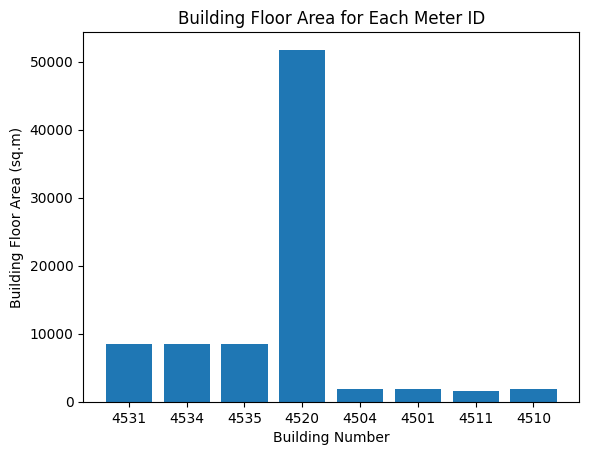

In [11]:
import matplotlib.pyplot as plt

# Create lists to store the building numbers and corresponding floor areas
building_numbers = []
floor_areas = []

# Iterate over the meter IDs and fetch the building number and floor area
for meter_id, area in ids_and_area.items():
    building_number = id_and_building.get(meter_id)
    if building_number is not None:
        building_numbers.append(building_number)
        floor_areas.append(area)

# Plot the building floor area for each meter ID
plt.bar(building_numbers, floor_areas)
plt.xlabel('Building Number')
plt.ylabel('Building Floor Area (sq.m)')
plt.title('Building Floor Area for Each Meter ID')

plt.show()


In [12]:
import requests
import xml.etree.ElementTree as ET
import pandas as pd
import numpy as np
import calendar

def get_gas_consumption(api_key, ids_and_descriptions, per, start_year, end_year):
    url = 'https://joulz.e-dataportal.nl/api/v3.1/aggregates/'
    params = {
        'apikey': api_key,
        'per': per,
    }

    gas_data = pd.DataFrame()
    for year in range(start_year, end_year):
        for month in range(1, 13):
            last_day_of_month = calendar.monthrange(year, month)[1]
            start_date = f'01-{month:02}-{year}'
            end_date = f'{last_day_of_month:02}-{month:02}-{year}'

            for meter_id, description in ids_and_descriptions.items():
                params['dap'] = str(meter_id)
                params['begin'] = start_date
                params['end'] = end_date

                response = requests.get(url, params=params)

                if response.status_code == 200:
                    df = pd.read_xml(response.content)
                    df['datetime'] = pd.to_datetime(df['datetime'])
                    df['meter_id'] = meter_id
                    df = df[['meter_id', 'datetime', 'value']]
                    gas_data = pd.concat([gas_data, df], ignore_index=True)
                else:
                    print(f'Request failed with status code {response.status_code}')
    
    return gas_data


In [13]:
gas_data = get_gas_consumption(API_KEY,ids_and_descriptions,'hourly',2020,2023)

In [14]:
print(gas_data)

        meter_id                   datetime  value
0           4902  2020-01-01 01:00:00+01:00   43.0
1           4902  2020-01-01 02:00:00+01:00   42.0
2           4902  2020-01-01 03:00:00+01:00   44.0
3           4902  2020-01-01 04:00:00+01:00   43.0
4           4902  2020-01-01 05:00:00+01:00   45.0
...          ...                        ...    ...
210427     41574  2022-12-31 20:00:00+01:00    4.5
210428     41574  2022-12-31 21:00:00+01:00    4.4
210429     41574  2022-12-31 22:00:00+01:00    4.8
210430     41574  2022-12-31 23:00:00+01:00    4.2
210431     41574  2023-01-01 00:00:00+01:00    4.4

[210432 rows x 3 columns]


In [15]:
# Copy gas_data and add area column
gas_data_scaled = gas_data.copy()
gas_data_scaled['area'] = gas_data_scaled['meter_id'].map(ids_and_area)

# Scale the value by the area
gas_data_scaled['value'] = gas_data_scaled['value'] / gas_data_scaled['area']


In [16]:
gas_data_scaled

,meter_id,datetime,value,area
0,4902,2020-01-01 01:00:00+01:00,0.005026,8555
1,4902,2020-01-01 02:00:00+01:00,0.004909,8555
2,4902,2020-01-01 03:00:00+01:00,0.005143,8555
3,4902,2020-01-01 04:00:00+01:00,0.005026,8555
4,4902,2020-01-01 05:00:00+01:00,0.005260,8555
...,...,...,...,...
210427,41574,2022-12-31 20:00:00+01:00,0.002503,1798
210428,41574,2022-12-31 21:00:00+01:00,0.002447,1798
210429,41574,2022-12-31 22:00:00+01:00,0.002670,1798
210430,41574,2022-12-31 23:00:00+01:00,0.002336,1798


In [78]:
ids_and_area

{4902: 8555,
 4903: 8553,
 4904: 8552,
 4905: 51766,
 40752: 1801,
 40773: 1843,
 40812: 1534,
 41574: 1798}

meter_id
4902    8555
Name: area, dtype: int64
meter_id
4903    8553
Name: area, dtype: int64
meter_id
4904    8552
Name: area, dtype: int64
meter_id
4905    51766
Name: area, dtype: int64
meter_id
40752    1801
Name: area, dtype: int64
meter_id
40773    1843
Name: area, dtype: int64
meter_id
40812    1534
Name: area, dtype: int64
meter_id
41574    1798
Name: area, dtype: int64


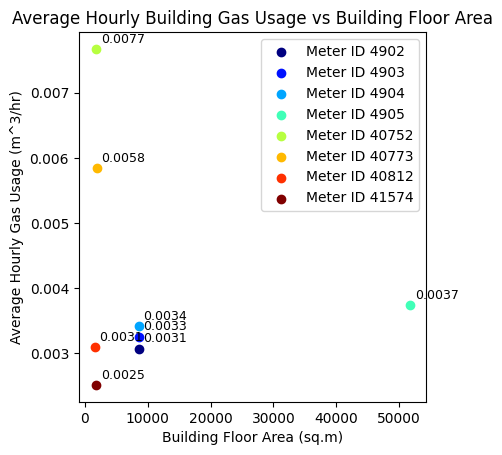

In [79]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Group data by meter_id and calculate average hourly consumption
average_hourly_usage = gas_data_scaled.groupby('meter_id')['value'].mean()

# Map the building area for each meter_id
average_hourly_usage = pd.DataFrame(average_hourly_usage)
average_hourly_usage['area'] = average_hourly_usage.index.map(ids_and_area)

# Create a list of unique meter IDs
unique_meter_ids = gas_data_scaled['meter_id'].unique()

# Generate a color map
colors = plt.cm.jet(np.linspace(0, 1, len(unique_meter_ids)))

plt.figure()

# Plot each meter ID in a different color
for i, meter_id in enumerate(unique_meter_ids):
    data = average_hourly_usage[average_hourly_usage.index == meter_id]
    print(data['area'])
    plt.scatter(data['area'], data['value'], color=colors[i], label=f'Meter ID {meter_id}')
    for index, row in data.iterrows():
        plt.text(row['area'] + 750, row['value'] + 0.0001, f'{row["value"]:.4f}', color='black', fontsize=9)

plt.xlabel('Building Floor Area (sq.m)')
plt.ylabel('Average Hourly Gas Usage (m^3/hr/m^2)')
plt.title('Average Hourly Building Gas Usage vs Building Floor Area')

# Shrink current axis by 20% to place legend outside of plot
box = plt.gca().get_position()
plt.gca().set_position([box.x0, box.y0, box.width * 0.7, box.height])

# Place legend outside of plot
plt.legend()

plt.show()


              value  area building_id
meter_id                             
41574     21.992504  1798        4510
              value  area building_id
meter_id                             
4902      26.878294  8555        4531
              value  area building_id
meter_id                             
4903      28.472303  8553        4534
              value  area building_id
meter_id                             
4904      29.927923  8552        4535
             value   area building_id
meter_id                             
4905      32.69884  51766        4520
              value  area building_id
meter_id                             
40752     67.219382  1801        4504
              value  area building_id
meter_id                             
40773     51.155489  1843        4501
              value  area building_id
meter_id                             
40812     27.112506  1534        4511


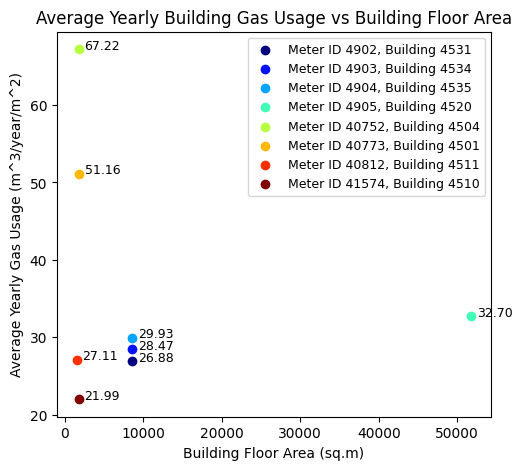

In [144]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Group data by meter_id and calculate average hourly consumption
average_hourly_usage = gas_data_scaled.groupby('meter_id')['value'].mean()

# Convert hourly consumption to yearly consumption
average_yearly_usage = average_hourly_usage * 8760  # convert to yearly consumption

# Map the building area and ID for each meter_id
average_yearly_usage = pd.DataFrame(average_yearly_usage)
average_yearly_usage['area'] = average_yearly_usage.index.map(ids_and_area)
average_yearly_usage['building_id'] = average_yearly_usage.index.map(id_and_building)  # Add building_id mapping

# Create a list of unique meter IDs
unique_meter_ids = gas_data_scaled['meter_id'].unique()

# Generate a color map
colors = plt.cm.jet(np.linspace(0, 1, len(unique_meter_ids)))

plt.figure(figsize=(8, 5))

# Plot each meter ID in a different color
for i, meter_id in enumerate(unique_meter_ids):
    data = average_yearly_usage[average_yearly_usage.index == meter_id]
    plt.scatter(data['area'], data['value'], color=colors[i], label=f'Meter ID {meter_id}, Building {data["building_id"].unique()[0]}')
    for index, row in data.iterrows():
        plt.text(row['area'] + 750, row['value'] + 0.0001, f'{row["value"]:.2f}', color='black', fontsize=9)

plt.xlabel('Building Floor Area (sq.m)')
plt.ylabel('Average Yearly Gas Usage (m^3/year/m^2)')
plt.title('Average Yearly Building Gas Usage vs Building Floor Area')

# Shrink current axis by 20% to place legend outside of plot
box = plt.gca().get_position()
plt.gca().set_position([box.x0, box.y0, box.width * 0.7, box.height])

# Place legend outside of plot
plt.legend(fontsize=9)  # Specify the fontsize here

plt.show()


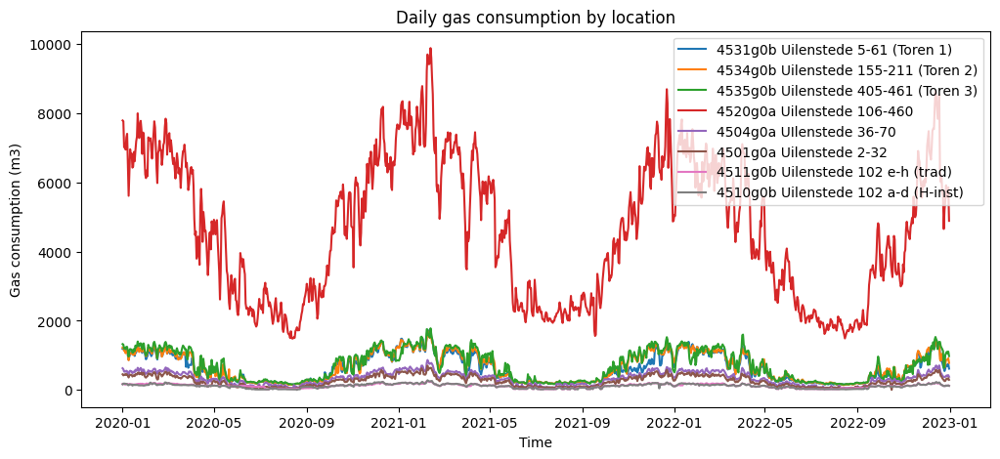

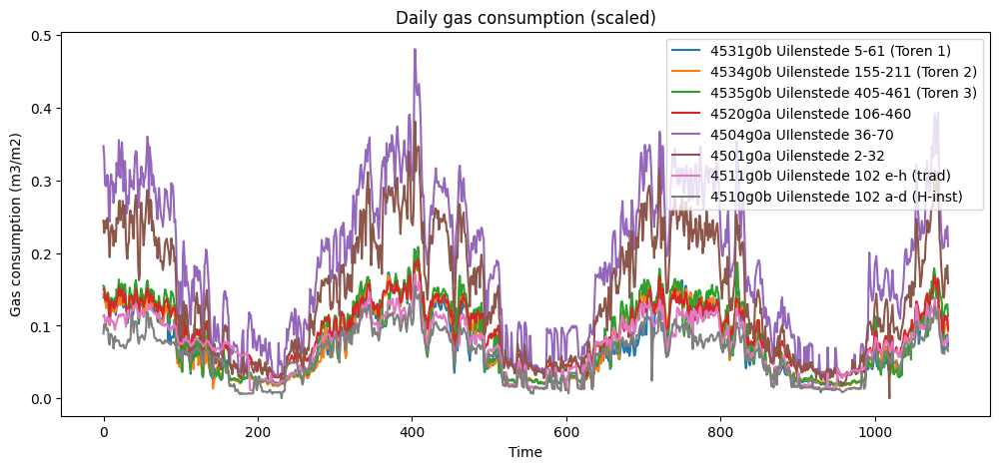

In [77]:
import matplotlib.pyplot as plt

# Assume gas_data is the hourly gas consumption data
# with columns 'meter_id', 'datetime', and 'value'

# Convert the 'datetime' column to a datetime type
gas_data['datetime'] = pd.to_datetime(gas_data['datetime'], utc=True)

# Add a new column for the date only
gas_data['date'] = gas_data['datetime'].dt.date

# Group by meter_id and date, and calculate the sum of the values
daily_gas_data = gas_data.groupby(['meter_id', 'date']).sum().reset_index()

# Set the color map
cmap = plt.get_cmap('tab10')

# Plot of energy generated over the time period
plt.figure(figsize=(12, 5))
for i, (id, description) in enumerate(ids_and_descriptions.items()):
    # Select the data for the current id and description
    id_data = daily_gas_data[daily_gas_data['meter_id'] == id]

    # Plot the data using a unique color for each id
    color = cmap(i % cmap.N)  # Select a different color from the color map
    plt.plot(id_data['date'], id_data['value'], label=description, color=color)

plt.xlabel('Time')
plt.ylabel('Gas consumption (m3)')
plt.title('Daily gas consumption by location')
plt.legend()
plt.show()

# Plot of energy generated over the time period (scaled)
plt.figure(figsize=(12, 5))
for i, (id, description) in enumerate(ids_and_descriptions.items()):
    # Select the data for the current id and description
    id_data = gas_data_scaled[gas_data_scaled['meter_id'] == id]
    # Group by meter_id and date, and calculate the sum of the values
    daily_gas_data_scaled = id_data.groupby(['meter_id', 'date']).sum().reset_index()

    # Plot the data using a unique color for each id
    color = cmap(i % cmap.N)  # Select a different color from the color map
    plt.plot(daily_gas_data_scaled.index, daily_gas_data_scaled['value'], label=description, color=color)

plt.xlabel('Time')
plt.ylabel('Gas consumption (m3/m2)')
plt.title('Daily gas consumption (scaled)')
plt.legend(loc='upper right')
plt.show()


## heating month and non heating month

## non heating averages

In [18]:
import pandas as pd

def calculate_non_heating_averages(data, ids_and_descriptions):
    non_heating_averages = {}  # Dictionary to store the non-heating averages for each location

    for id, description in ids_and_descriptions.items():
        # Filter the data for the current location
        location_data = data[data['meter_id'] == id]

        # Convert 'datetime' column to datetime format
        location_data['datetime'] = pd.to_datetime(location_data['datetime'], utc=True)

        # Set datetime column as index
        df = location_data.set_index('datetime')

        # Reshape the dataframe
        df_temp = df.reset_index().copy()
        df_temp['date'] = df_temp['datetime'].dt.date
        df_temp['month'] = df_temp['datetime'].dt.month
        df_temp['hour'] = df_temp['datetime'].dt.hour

        # Create a boolean mask for the heating months (October to April)
        heating_months = (df_temp['month'] >= 10) | (df_temp['month'] <= 4)

        heating_data = df_temp[heating_months]
        non_heating_data = df_temp[~heating_months]
        heating_average = heating_data['value'].mean()
        non_heating_average = non_heating_data['value'].mean()

        non_heating_averages[id] = non_heating_average

    return non_heating_averages


In [38]:
non_heating_averages = calculate_non_heating_averages(gas_data_scaled, ids_and_descriptions)

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()


In [39]:
non_heating_averages

{4902: 0.0013156189159214567,
 4903: 0.0013429654439688758,
 4904: 0.0014459153893341976,
 4905: 0.002168359090686033,
 40752: 0.0035742115753492868,
 40773: 0.002490611002947028,
 40812: 0.0016386441340745096,
 41574: 0.0011988326414486203}

## non heating persentages

In [24]:
gas_data_scaled

,meter_id,datetime,value,area
0,4902,2020-01-01 01:00:00+01:00,0.005026,8555
1,4902,2020-01-01 02:00:00+01:00,0.004909,8555
2,4902,2020-01-01 03:00:00+01:00,0.005143,8555
3,4902,2020-01-01 04:00:00+01:00,0.005026,8555
4,4902,2020-01-01 05:00:00+01:00,0.005260,8555
...,...,...,...,...
210427,41574,2022-12-31 20:00:00+01:00,0.002503,1798
210428,41574,2022-12-31 21:00:00+01:00,0.002447,1798
210429,41574,2022-12-31 22:00:00+01:00,0.002670,1798
210430,41574,2022-12-31 23:00:00+01:00,0.002336,1798


In [30]:
import pandas as pd

def calculate_non_heating_percentages_1(gas_data, ids_and_descriptions):
    non_heating_percentages = {}

    for meter_id in ids_and_descriptions:
        meter_data = gas_data[gas_data['meter_id'] == meter_id]
        
        # Convert 'datetime' column to datetime format
        meter_data['datetime'] = pd.to_datetime(meter_data['datetime'], utc=True)

        # Set datetime column as index
        df = meter_data.set_index('datetime')

        # Reshape the dataframe
        df_temp = df.reset_index().copy()

        # Calculate the non-heating consumption
        heating_months = (df_temp['datetime'].dt.month >= 10) | (df_temp['datetime'].dt.month <= 4)
        non_heating_data = df_temp[~heating_months]
        non_heating_consumption = non_heating_data['value'].sum()

        # Calculate the total consumption for the meter ID
        total_consumption = meter_data['value'].sum()

        # Calculate the non-heating percentage
        non_heating_percentage = (non_heating_consumption / total_consumption) * 100

        # Calculate the percentage of non-heating months in the total year
        non_heating_months_percentage = len(non_heating_data) / len(df_temp)
        
        reversed_non_heating_months_percentage = len(df_temp) / len(non_heating_data) 
        
        print('reversed non heating percentage: ', reversed_non_heating_months_percentage)

        # Adjust the non-heating percentage based on the percentage of non-heating months
        adjusted_non_heating_percentage = non_heating_percentage * reversed_non_heating_months_percentage

        non_heating_percentages[meter_id] = adjusted_non_heating_percentage

    return non_heating_percentages


In [45]:
import pandas as pd

def calculate_non_heating_percentages(gas_data, ids_and_descriptions):
    non_heating_percentages = {}

    for meter_id in ids_and_descriptions:
        meter_data = gas_data[gas_data['meter_id'] == meter_id]
        
        # Convert 'datetime' column to datetime format
        meter_data['datetime'] = pd.to_datetime(meter_data['datetime'], utc=True)

        # Set datetime column as index
        df = meter_data.set_index('datetime')

        # Reshape the dataframe
        df_temp = df.reset_index().copy()

        # Calculate the non-heating consumption
        heating_months = (df_temp['datetime'].dt.month >= 10) | (df_temp['datetime'].dt.month <= 4)
        non_heating_data = df_temp[~heating_months]
        print(non_heating_data['datetime'].dt.month.unique())

        non_heating_consumption = non_heating_data['value'].mean()
        
        # Calculate the total consumption for the meter ID
        total_consumption = meter_data['value'].mean()

       
        non_heating_percentage = non_heating_consumption / total_consumption
        non_heating_percentages[meter_id] = non_heating_percentage*100

    return non_heating_percentages


In [41]:
non_heating_percentages_1 = calculate_non_heating_percentages_1(gas_data_scaled, ids_and_descriptions)


c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526
reversed non heating percentage:  2.3877995642701526


In [46]:
non_heating_percentages = calculate_non_heating_percentages(gas_data_scaled, ids_and_descriptions)


c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


[5 6 7 8 9]
[5 6 7 8 9]
[5 6 7 8 9]
[5 6 7 8 9]
[5 6 7 8 9]
[5 6 7 8 9]
[5 6 7 8 9]
[5 6 7 8 9]


In [32]:
non_heating_percentages_1

{4902: 42.87780198797859,
 4903: 41.31867190509238,
 4904: 42.322412215204004,
 4905: 58.09021197805955,
 40752: 46.5789662029544,
 40773: 42.64987535970315,
 40812: 52.94428537001075,
 41574: 47.75160726755327}

In [29]:
non_heating_percentages

{4902: 42.8778019879786,
 4903: 41.31867190509238,
 4904: 42.322412215204004,
 4905: 58.09021197805955,
 40752: 46.57896620295438,
 40773: 42.649875359703145,
 40812: 52.944285370010746,
 41574: 47.75160726755327}

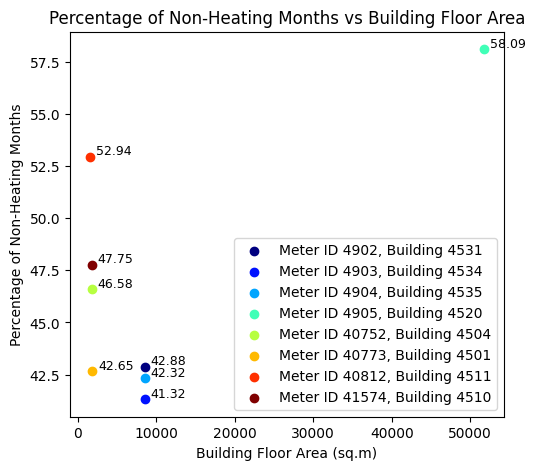

In [47]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Create a list of unique meter IDs
unique_meter_ids = list(ids_and_area.keys())

# Generate a color map
colors = plt.cm.jet(np.linspace(0, 1, len(unique_meter_ids)))


plt.figure(figsize=(8, 5))

# Plot each meter ID in a different color
for i, meter_id in enumerate(unique_meter_ids):
    percentage = non_heating_percentages[meter_id]
    area = ids_and_area[meter_id]
    plt.scatter(area, percentage, color=colors[i], label=f'Meter ID {meter_id}, Building {id_and_building[meter_id]}')  # assumes a dictionary "meter_to_building_map" that maps meter ids to building ids
    plt.text(area + 750, percentage + 0.1, f'{percentage:.2f}', color='black', fontsize=9)
    
plt.xlabel('Building Floor Area (sq.m)')
plt.ylabel('Percentage of Non-Heating Months')
plt.title('Percentage of Non-Heating Months vs Building Floor Area')

# Shrink current axis by 20% to place legend outside of plot
box = plt.gca().get_position()
plt.gca().set_position([box.x0, box.y0, box.width * 0.7, box.height])

# Place legend outside of plot
plt.legend()

plt.show()


## clustering on subtract_non_heating_averages

In [46]:
def subtract_non_heating_averages(gas_data, meter_id, non_heating_averages):
    # Filter the gas data by meter_id
    gas_data_meter = gas_data[gas_data['meter_id'] == meter_id]

    # Subtract the non-heating average from the gas consumption
    gas_data_meter['value'] = gas_data_meter['value'] - non_heating_averages[meter_id]

    return gas_data_meter


In [47]:
gas_data_scaled_subtracted = {}
for meter_id in ids_and_descriptions:
    gas_data_scaled_subtracted[meter_id] = subtract_non_heating_averages(gas_data_scaled, meter_id, non_heating_averages)

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [48]:
gas_data_scaled_subtracted

{4902:         meter_id                   datetime     value  area
 0           4902  2020-01-01 01:00:00+01:00  0.003711  8555
 1           4902  2020-01-01 02:00:00+01:00  0.003594  8555
 2           4902  2020-01-01 03:00:00+01:00  0.003828  8555
 3           4902  2020-01-01 04:00:00+01:00  0.003711  8555
 4           4902  2020-01-01 05:00:00+01:00  0.003944  8555
 ...          ...                        ...       ...   ...
 205219      4902  2022-12-31 20:00:00+01:00  0.001490  8555
 205220      4902  2022-12-31 21:00:00+01:00  0.001724  8555
 205221      4902  2022-12-31 22:00:00+01:00  0.001139  8555
 205222      4902  2022-12-31 23:00:00+01:00  0.001139  8555
 205223      4902  2023-01-01 00:00:00+01:00  0.000204  8555
 
 [26304 rows x 4 columns],
 4903:         meter_id                   datetime     value  area
 744         4903  2020-01-01 01:00:00+01:00  0.003801  8553
 745         4903  2020-01-01 02:00:00+01:00  0.003918  8553
 746         4903  2020-01-01 03:00:00+01:00

In [151]:
non_heating_percentages.keys()

dict_keys([4902, 4903, 4904, 4905, 40752, 40773, 40812, 41574])

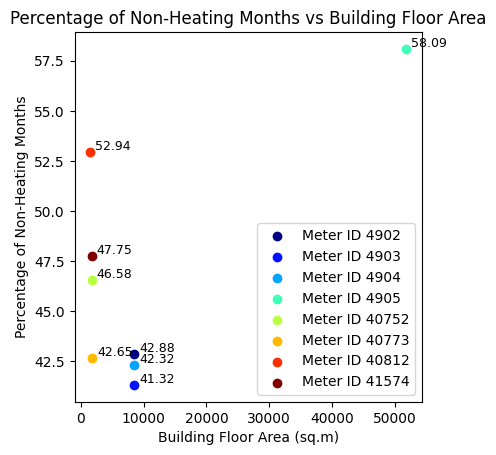

In [93]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Create a list of unique meter IDs
unique_meter_ids = list(ids_and_area.keys())

# Generate a color map
colors = plt.cm.jet(np.linspace(0, 1, len(unique_meter_ids)))


plt.figure(figsize=(8, 5))

# Plot each meter ID in a different color
for i, meter_id in enumerate(unique_meter_ids):
    percentage = non_heating_percentages[meter_id]
    area = ids_and_area[meter_id]
    plt.scatter(area, percentage, color=colors[i], label=f'Meter ID {meter_id}')
    plt.text(area + 750, percentage + 0.1, f'{percentage:.2f}', color='black', fontsize=9)

plt.xlabel('Building Floor Area (sq.m)')
plt.ylabel('Percentage of Non-Heating Months')
plt.title('Percentage of Non-Heating Months vs Building Floor Area')

# Shrink current axis by 20% to place legend outside of plot
box = plt.gca().get_position()
plt.gca().set_position([box.x0, box.y0, box.width * 0.7, box.height])

# Place legend outside of plot
plt.legend()

plt.show()


In [77]:
non_heating_percentages

{4902: 17.957035686571327,
 4903: 17.304078836165512,
 4904: 17.724440882097298,
 4905: 24.327926366723844,
 40752: 19.507067050324878,
 40773: 17.86158101286838,
 40812: 22.17283484017786,
 41574: 19.99816399252459}

4531g0b Uilenstede 5-61 (Toren 1) - Heating Months: Avg=37.05, Count=637.00 per day; Non-Heating Months: Avg=11.26, Count=459.00 per day


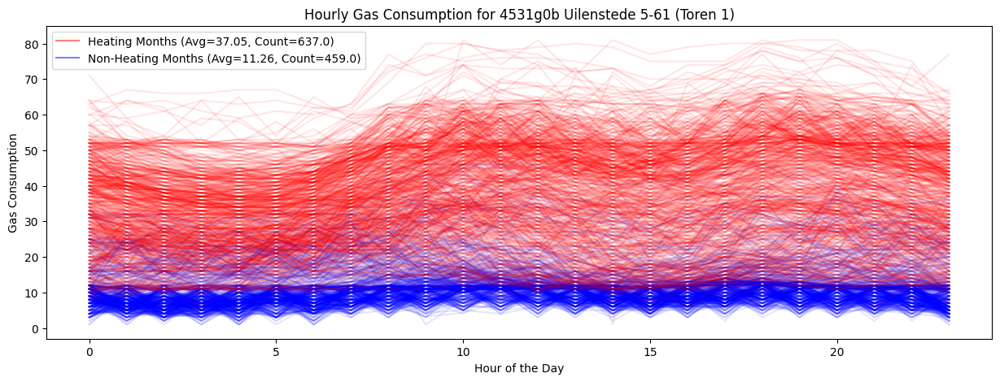

4534g0b Uilenstede 155-211 (Toren 2) - Heating Months: Avg=39.55, Count=637.00 per day; Non-Heating Months: Avg=11.49, Count=459.00 per day


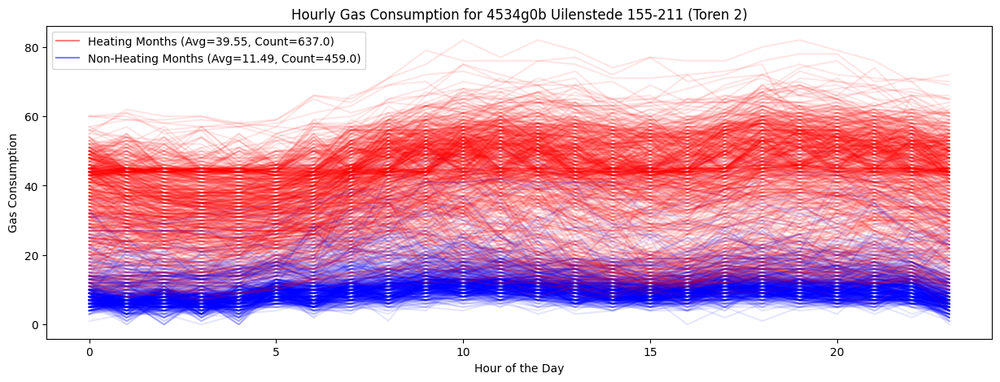

4535g0b Uilenstede 405-461 (Toren 3) - Heating Months: Avg=41.36, Count=637.00 per day; Non-Heating Months: Avg=12.37, Count=459.00 per day


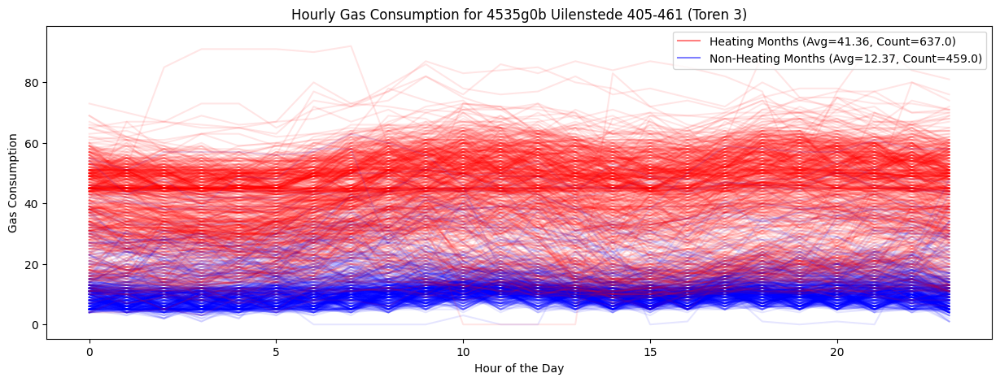

4520g0a Uilenstede 106-460 - Heating Months: Avg=251.58, Count=637.00 per day; Non-Heating Months: Avg=112.25, Count=459.00 per day


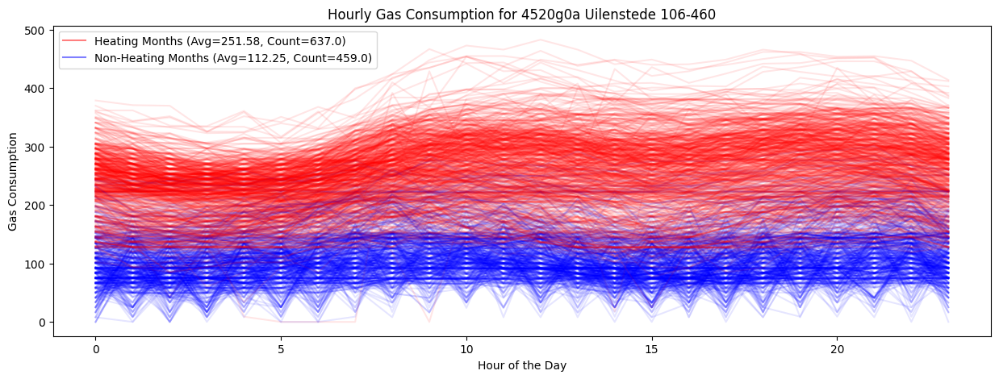

4504g0a UIlenstede 36-70 - Heating Months: Avg=19.14, Count=637.00 per day; Non-Heating Months: Avg=6.44, Count=459.00 per day


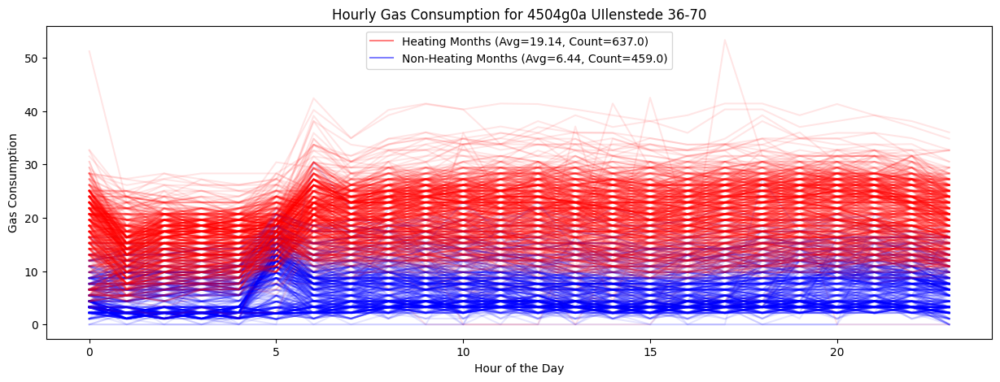

4501g0a Uilenstede 2-32 - Heating Months: Avg=15.21, Count=637.00 per day; Non-Heating Months: Avg=4.59, Count=459.00 per day


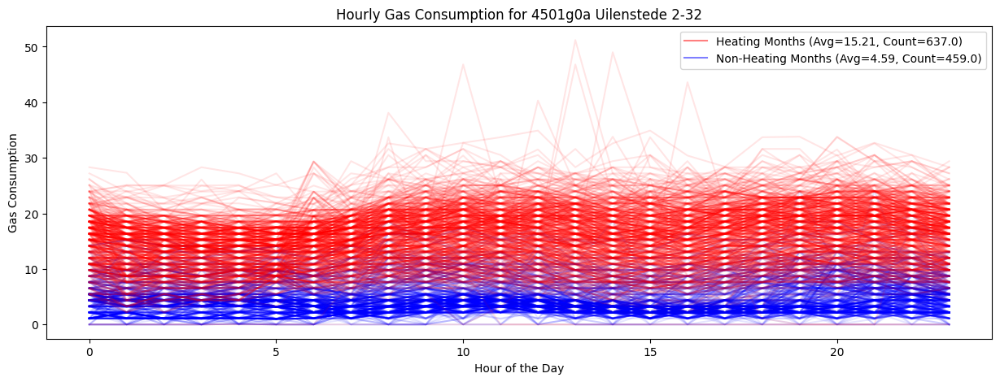

4511g0b Uilenstede 102 e-h (trad) - Heating Months: Avg=6.36, Count=637.00 per day; Non-Heating Months: Avg=2.51, Count=459.00 per day


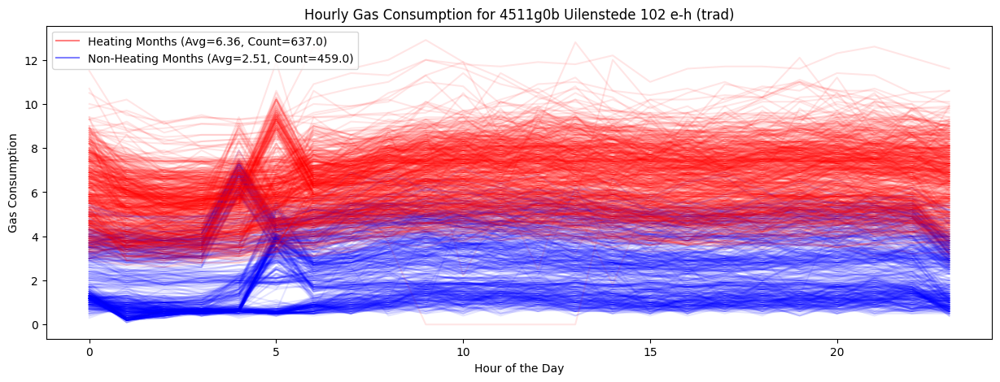

4510g0b Uilenstede 102 a-d (H-inst) - Heating Months: Avg=6.21, Count=637.00 per day; Non-Heating Months: Avg=2.16, Count=459.00 per day


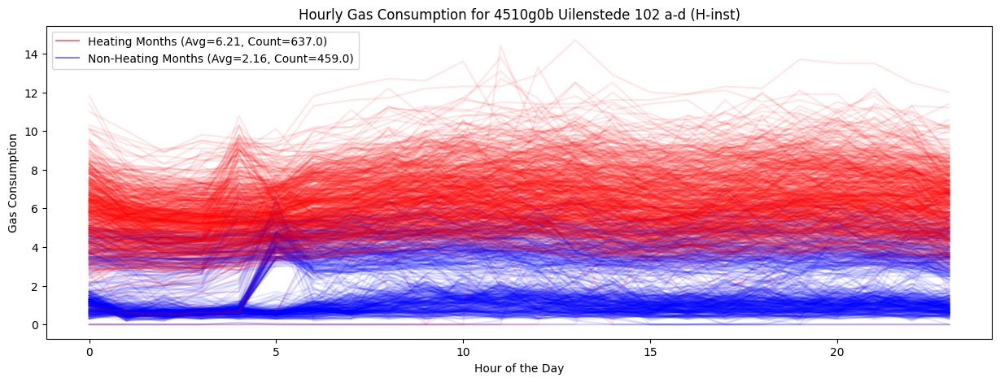

In [10]:
import matplotlib.pyplot as plt

# Convert datetime column to datetime data type with UTC timezone
data = gas_data.copy()
data['datetime'] = pd.to_datetime(data['datetime'], utc=True)

# Plot hourly data for each location in a separate line
for id, description in ids_and_descriptions.items():
    # Filter the data for the current location
    location_data = data[data['meter_id'] == id]

    # Set datetime column as index
    df = location_data.set_index('datetime')

    # Reshape the dataframe
    df_temp = df.reset_index().copy()
    df_temp['date'] = df_temp['datetime'].dt.date
    df_temp['month'] = df_temp['datetime'].dt.month
    df_temp['hour'] = df_temp['datetime'].dt.hour

    # Create a boolean mask for the heating months (October to April)
    heating_months = (df_temp['month'] >= 10) | (df_temp['month'] <= 4)

    # Create a new plot for the current location
    fig, ax = plt.subplots(figsize=(15, 5))
    
    heating_data = df_temp[heating_months]
    non_heating_data = df_temp[~heating_months]
    heating_average = heating_data['value'].mean()
    non_heating_average = non_heating_data['value'].mean()
    heating_count = len(heating_data) / 24  # Divide by 24 to get number of daily data points
    non_heating_count = len(non_heating_data) / 24  # Divide by 24 to get number of daily data points
    print(f'{description} - Heating Months: Avg={heating_average:.2f}, Count={heating_count:.2f} per day; Non-Heating Months: Avg={non_heating_average:.2f}, Count={non_heating_count:.2f} per day')
    
    for date, df_date in df_temp.groupby('date'):
        # Get the color based on the heating months mask
        color = 'red' if heating_months.loc[df_date.index[0]] else 'blue'
        ax.plot(df_date['hour'], df_date['value'], color=color, alpha=0.1, label=None)
    
    # Plot dummy lines with the same color and label for the legend
    ax.plot([], [], color='red', alpha=0.5, label=f'Heating Months (Avg={heating_average:.2f}, Count={heating_count})')
    ax.plot([], [], color='blue', alpha=0.5, label=f'Non-Heating Months (Avg={non_heating_average:.2f}, Count={non_heating_count})')

    # Set axis labels and title
    ax.set_xlabel('Hour of the Day')
    ax.set_ylabel('Gas Consumption')
    ax.set_title(f'Hourly Gas Consumption for {description}')

    # Add the legend
    ax.legend()
    
    # Display the plot
    plt.show()


c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=619, Average=0.00026336870480502173


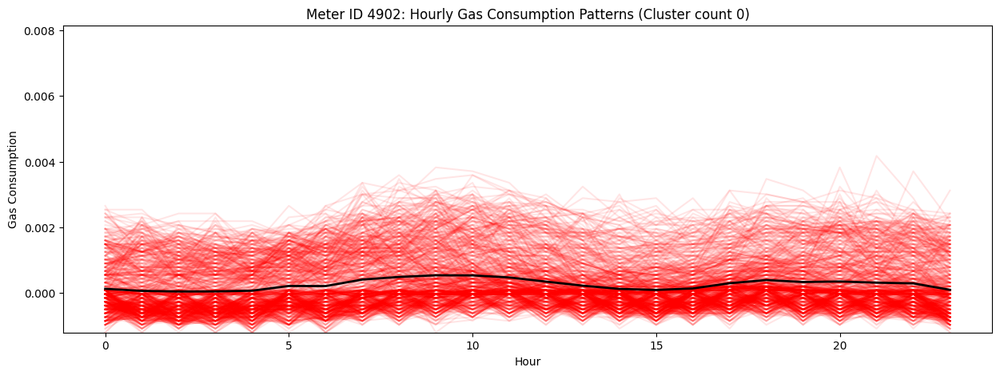

Cluster 1: Count=477, Average=0.003685349046957779


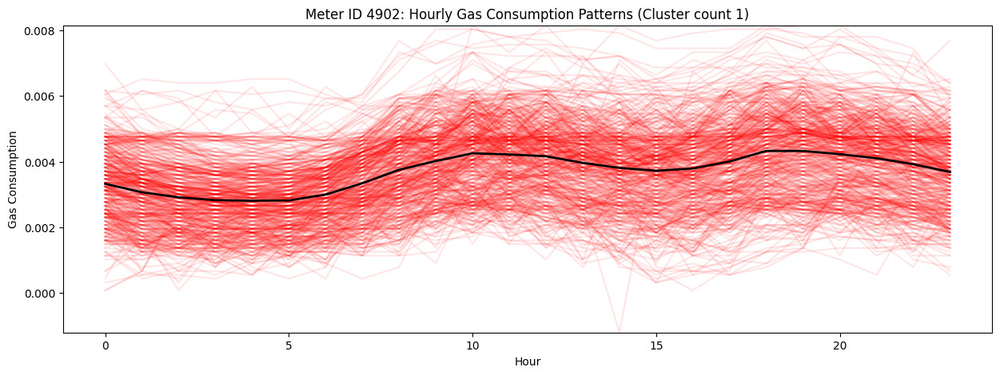

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=585, Average=0.0002019848791879249


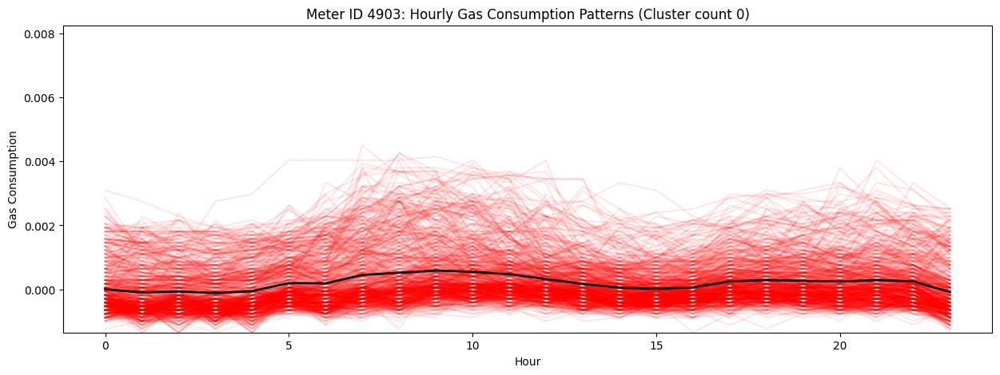

Cluster 1: Count=511, Average=0.003859563219445892


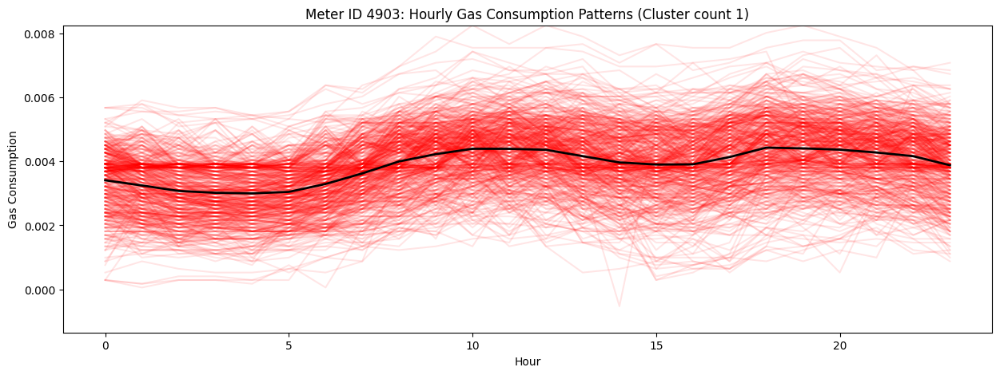

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=585, Average=0.0001776947556744504


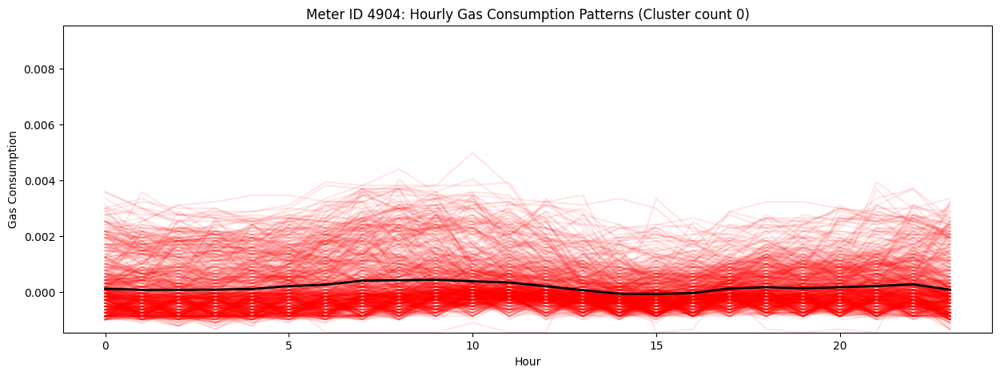

Cluster 1: Count=511, Average=0.004022959036533388


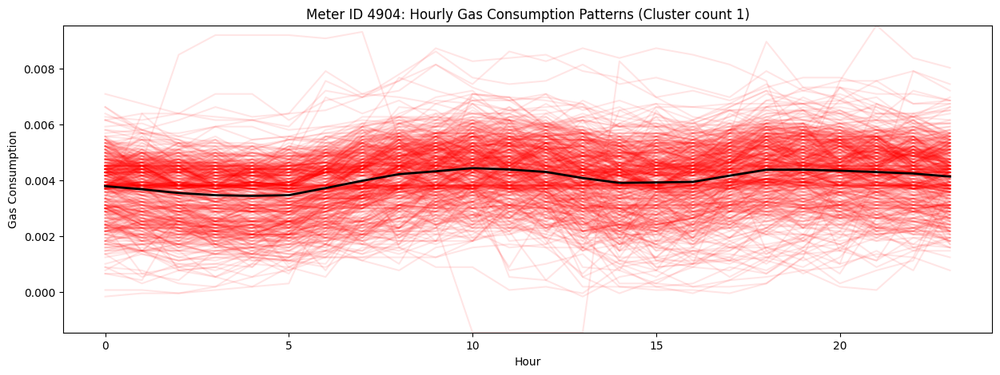

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=593, Average=0.00023815899192886994


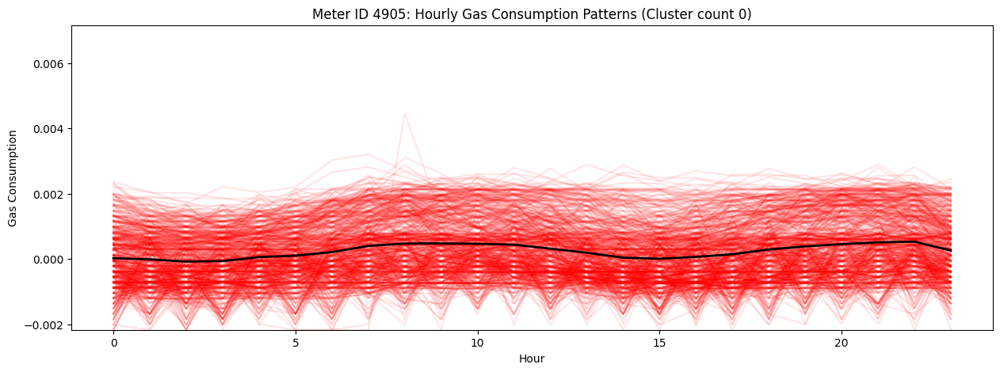

Cluster 1: Count=503, Average=0.0031279084175307747


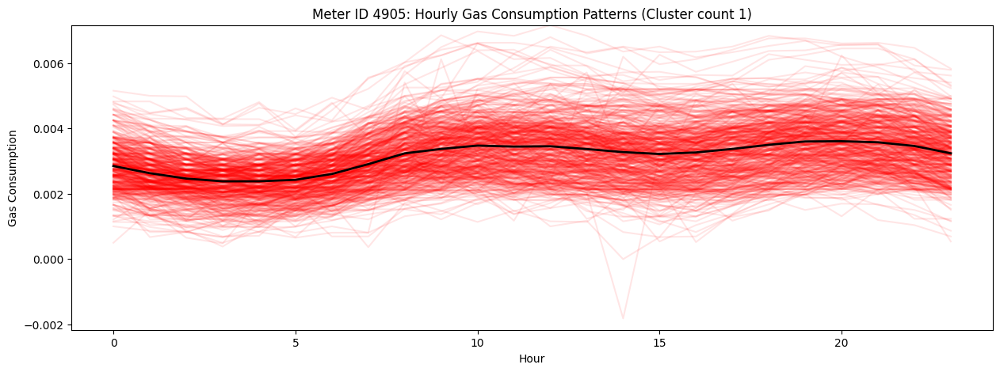

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=586, Average=0.0006490378645081039


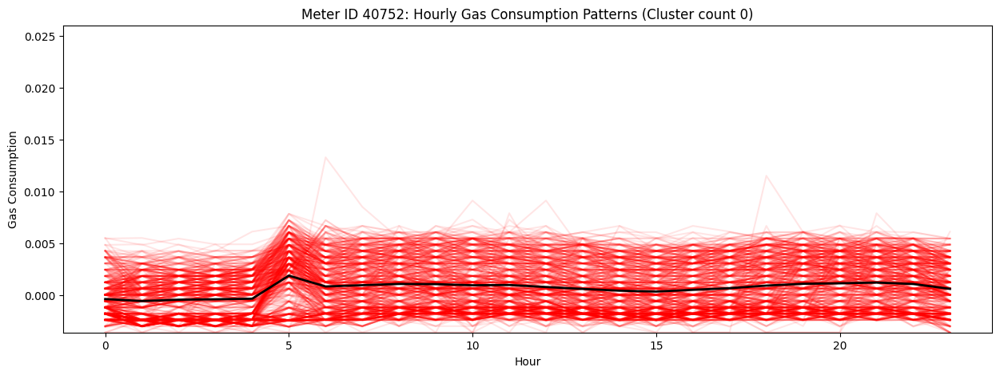

Cluster 1: Count=510, Average=0.008063576799300955


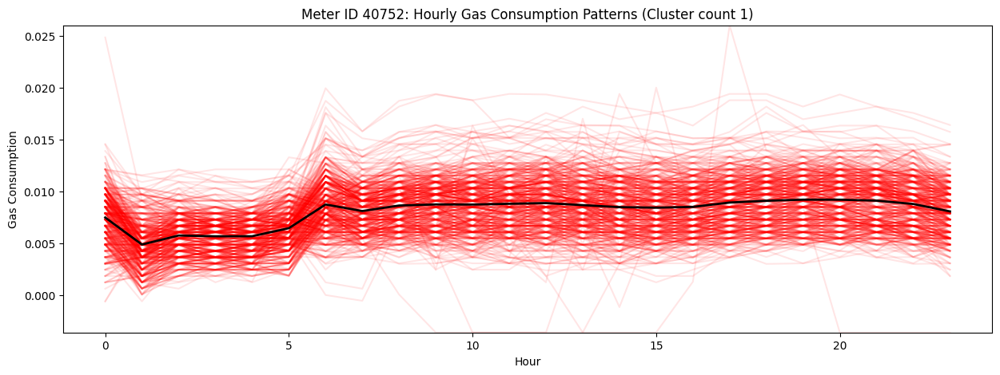

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=584, Average=0.0004221944846810955


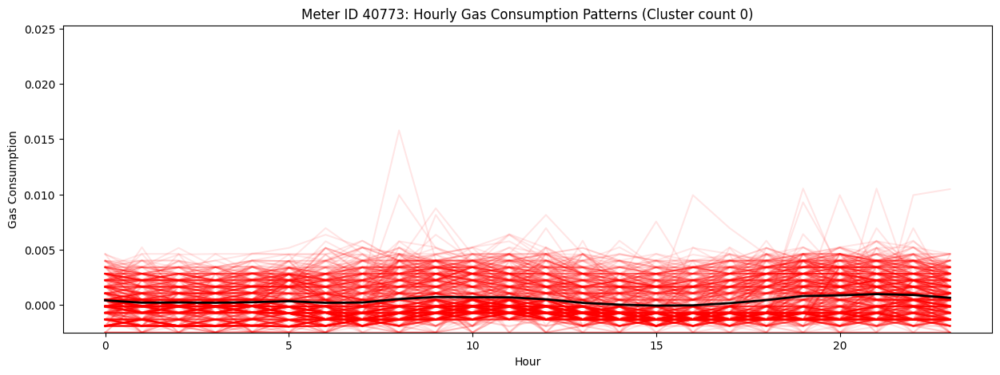

Cluster 1: Count=512, Average=0.006687508945563095


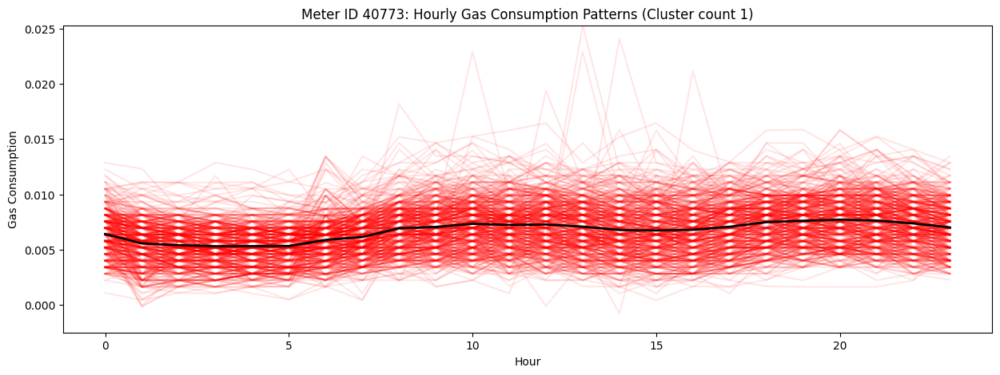

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=344, Average=-0.0004330810194529599


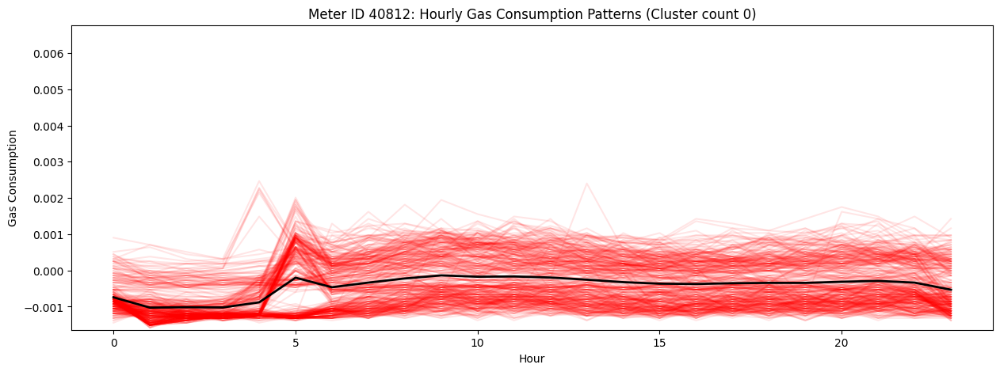

Cluster 1: Count=446, Average=0.001677087425415128


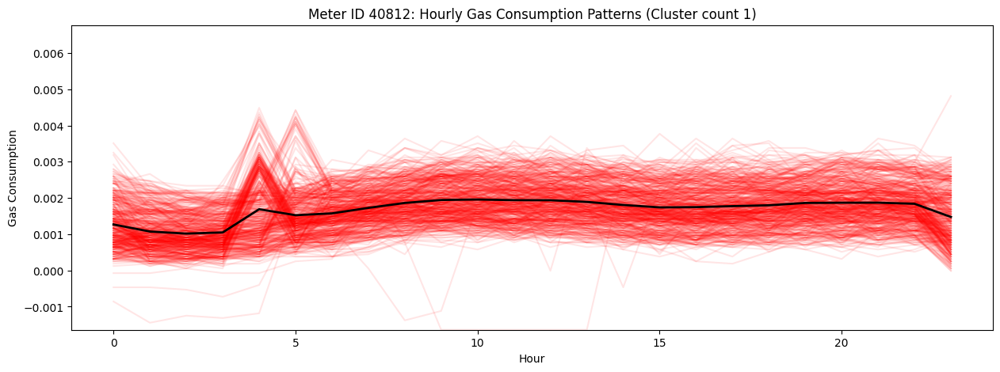

Cluster 2: Count=306, Average=0.00325883401552228


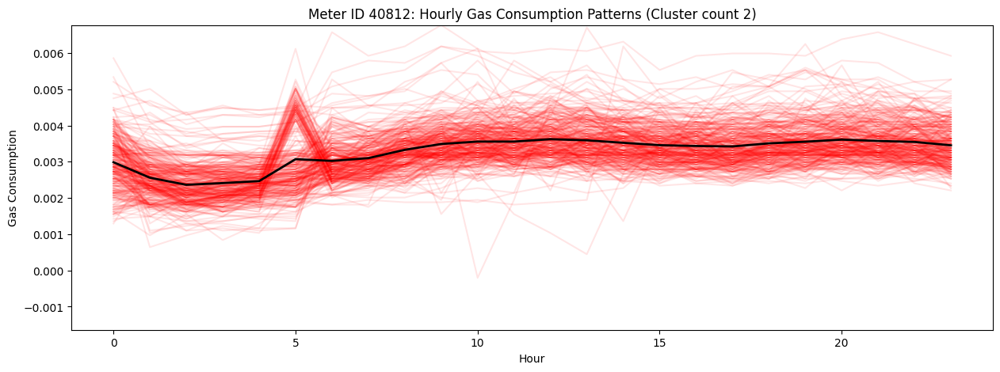

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Cluster 0: Count=359, Average=-0.0003407335774933123


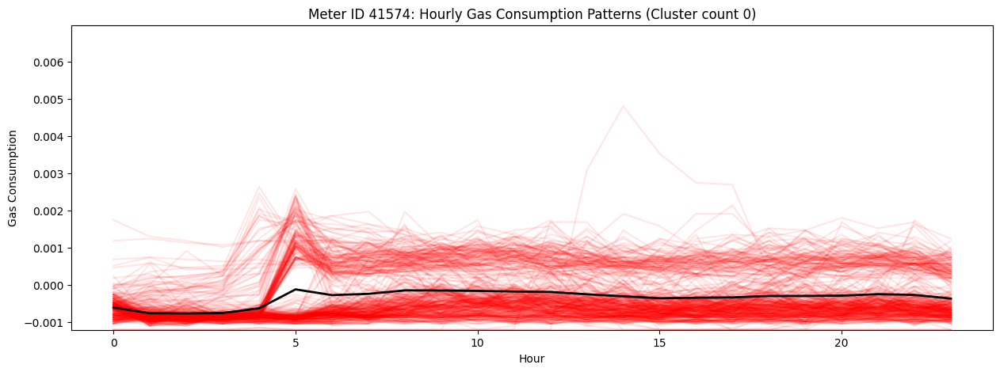

Cluster 1: Count=308, Average=0.0029346833142308505


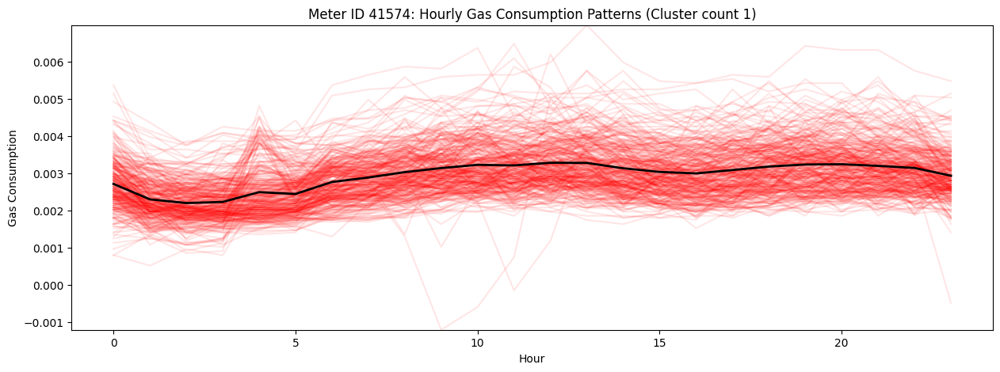

Cluster 2: Count=429, Average=0.0015293562380194574


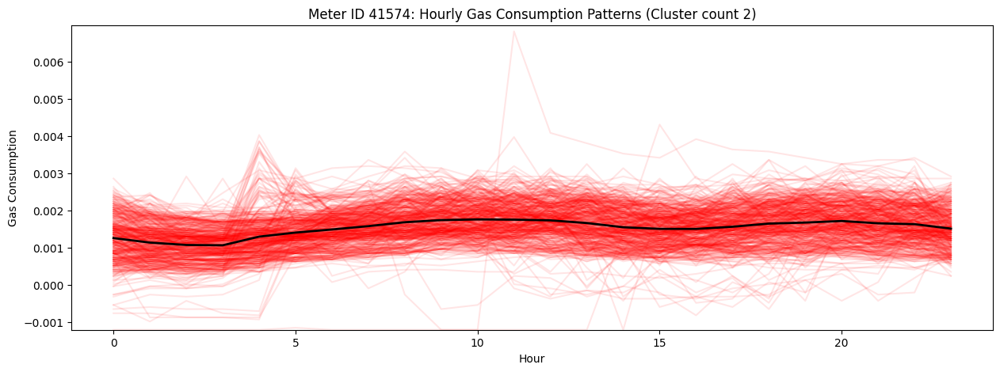

In [106]:
cluster_groups_scaled_substracted = {}
for meter_id in ids_and_descriptions:
    gas_data_scaled_subtracted = subtract_non_heating_averages(gas_data_scaled, meter_id, non_heating_averages)
    cluster_groups_scaled_substracted[meter_id] =  analyze_and_plot_daily_meter_data_kmeans_substracted(gas_data_scaled_subtracted, meter_id)
    

Cluster 0: Count=610, Average=1.8190515031010345e-07


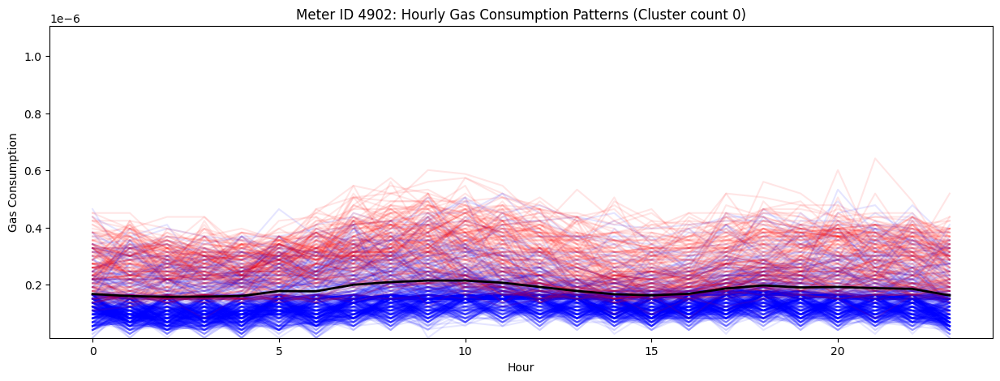

Cluster 1: Count=486, Average=5.805028064285792e-07


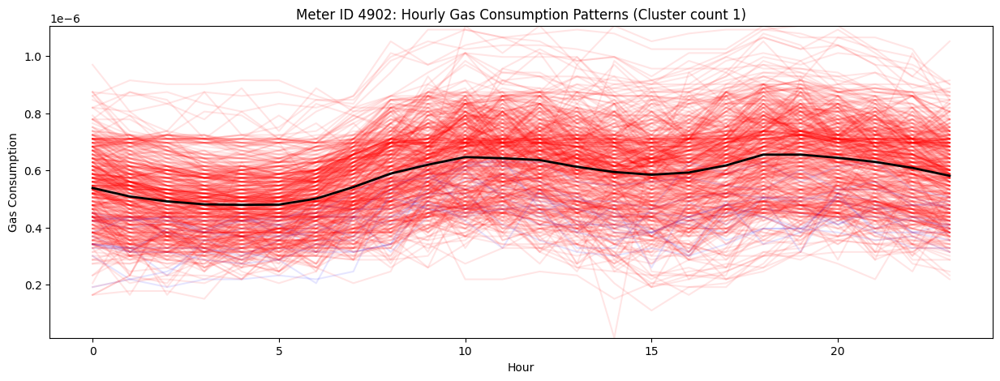

Cluster 0: Count=586, Average=1.809794274825764e-07


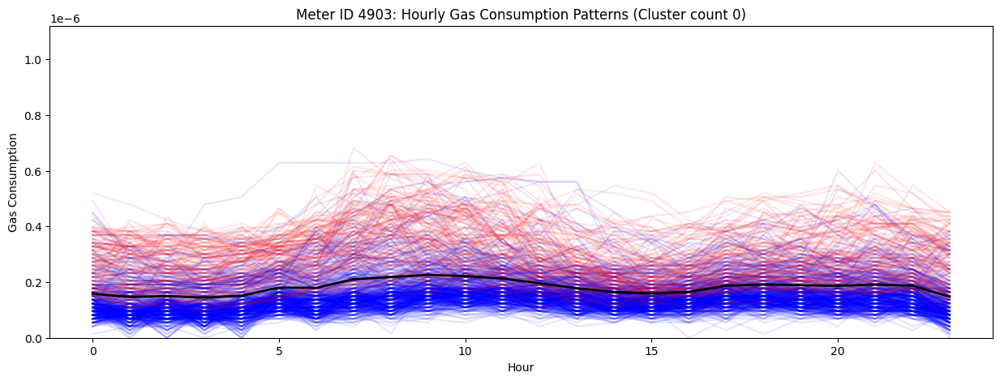

Cluster 1: Count=510, Average=6.08709407936719e-07


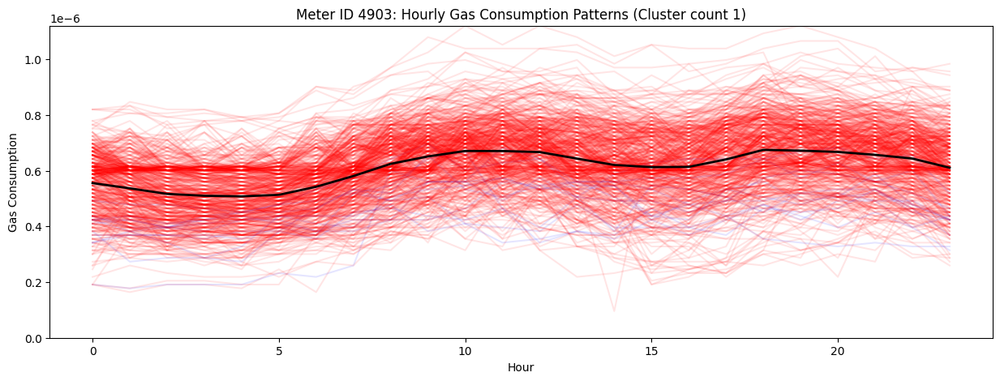

KeyboardInterrupt: 

In [51]:
cluster_groups_scaled = {}
for meter_id in ids_and_descriptions:
    cluster_groups_scaled[meter_id] =  analyze_and_plot_daily_meter_data_kmeans_scaled(gas_data_scaled, meter_id)
    

In [22]:
from kneed import KneeLocator
from sklearn.cluster import KMeans

def plot_gas_consumption_clusters(gas_data, meter_id):
    # Filter the gas data by meter_id
    gas_data_meter = gas_data[gas_data['meter_id'] == meter_id]
    
    # Pivot the data to create a time series
    gas_data_pivot = gas_data_meter.pivot(index='datetime', columns='meter_id', values='value')

    # Compute the within-cluster sum of squares (WCSS) for different numbers of clusters
    wcss = []
    for i in range(1, 11):
        kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
        kmeans.fit(gas_data_pivot)
        wcss.append(kmeans.inertia_)
    kneedle = KneeLocator(range(1, 11), wcss, S=1.0, curve="convex", direction="decreasing")
    optimal_k = kneedle.knee
    
    # Plot the WCSS and mark the optimal number of clusters
    plt.plot(range(1, 11), wcss)
    plt.vlines(optimal_k, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
    plt.xlabel('Number of clusters')
    plt.ylabel('WCSS')
    plt.title('Optimal number of clusters')
    print(f'Optimal number of clusters for meter ID {meter_id}: {optimal_k}')
    plt.show()

    # Create a new KMeans object with the optimal number of clusters
    kmeans = KMeans(n_clusters=optimal_k, init='k-means++', random_state=42)
    
    gas_data_resampled = gas_data_pivot
    # Assign each data point to its corresponding cluster
    cluster_labels = kmeans.fit_predict(gas_data_resampled)
    # Assign each data point to its corresponding cluster
    gas_data_resampled['cluster'] = cluster_labels

    # Group the data by meter ID and cluster, and plot the gas consumption for each cluster in the same plot
    fig, ax = plt.subplots(figsize=(16,7))
    ax.plot(gas_data_resampled.index, gas_data_resampled[meter_id], alpha=0.8)

    for cluster in range(kmeans.n_clusters):
        data = gas_data_resampled[gas_data_resampled['cluster'] == cluster][meter_id]
        if not data.empty:
            ax.plot(data.index, data, label=f'Cluster {cluster}')

    data = gas_data_resampled[gas_data_resampled['cluster'].isnull()][meter_id]
    if not data.empty:
        ax.plot(data.index, data, '', label='No Cluster')

    if ax.get_legend_handles_labels()[0]:
        ax.legend()
    ax.set_title(f'Meter ID {meter_id} clustering result')
    ax.set_xlabel('Date')
    ax.set_ylabel('Gas Consumption')
    plt.xticks(rotation=45, ha='right')
    plt.show()

Optimal number of clusters for meter ID 4902: 3


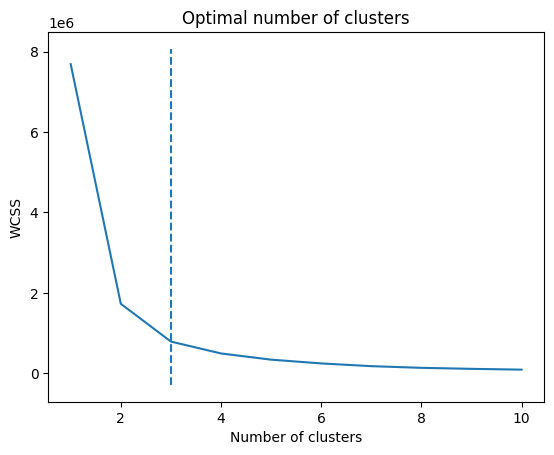

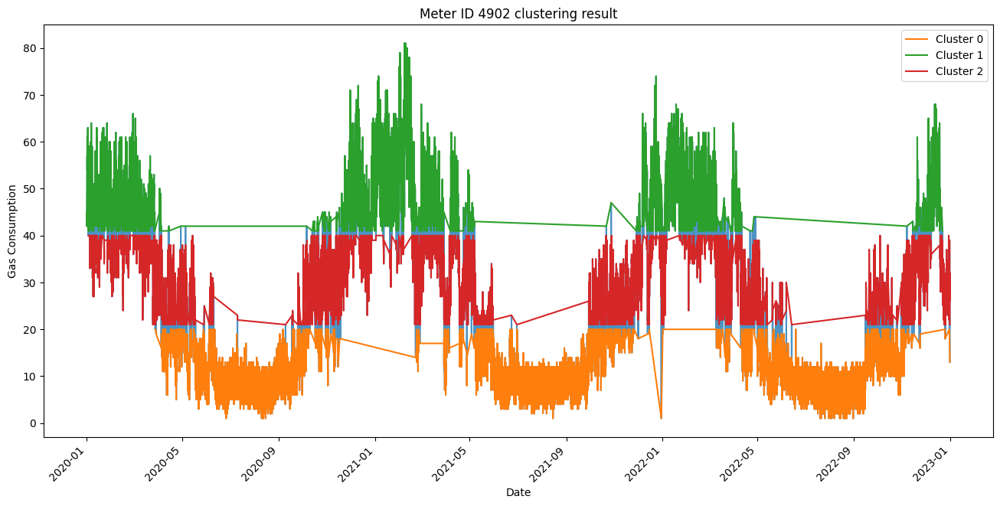

Optimal number of clusters for meter ID 4903: 2


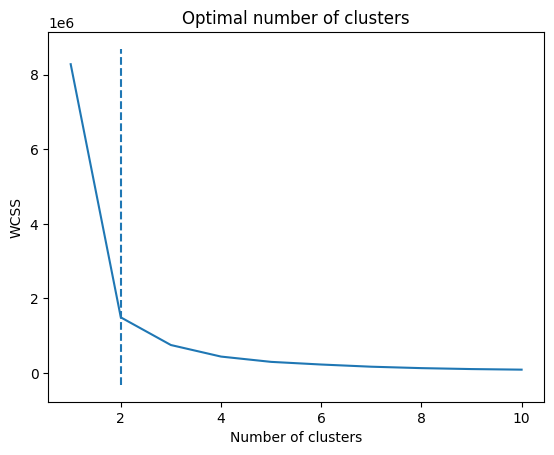

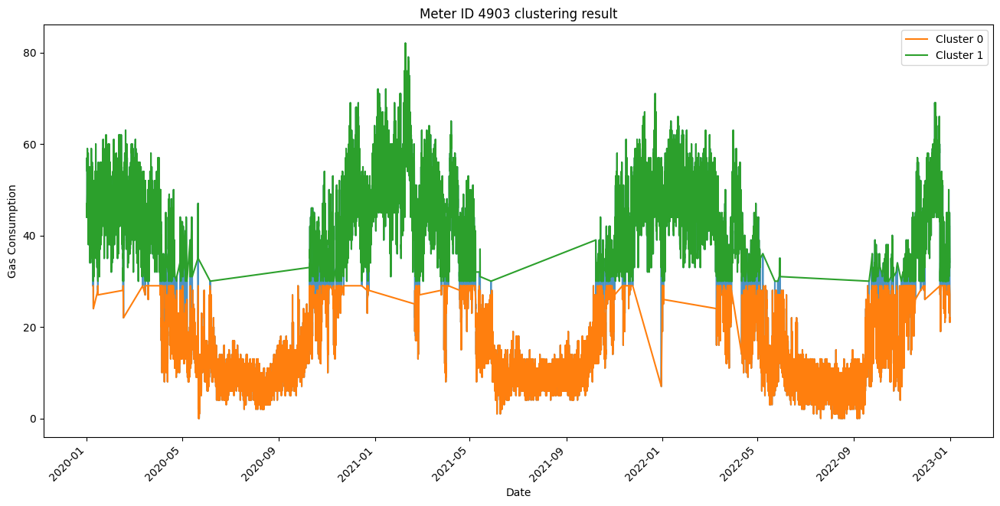

Optimal number of clusters for meter ID 4904: 2


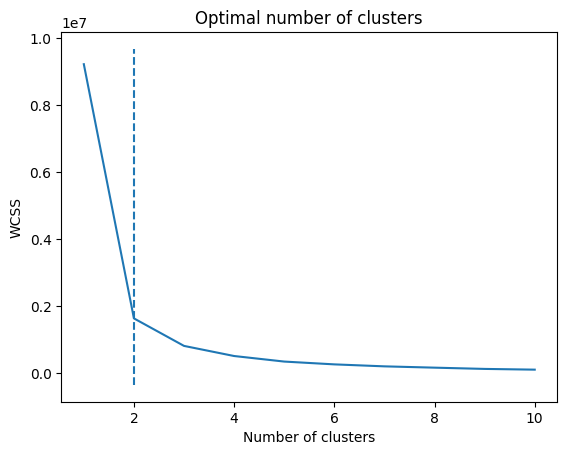

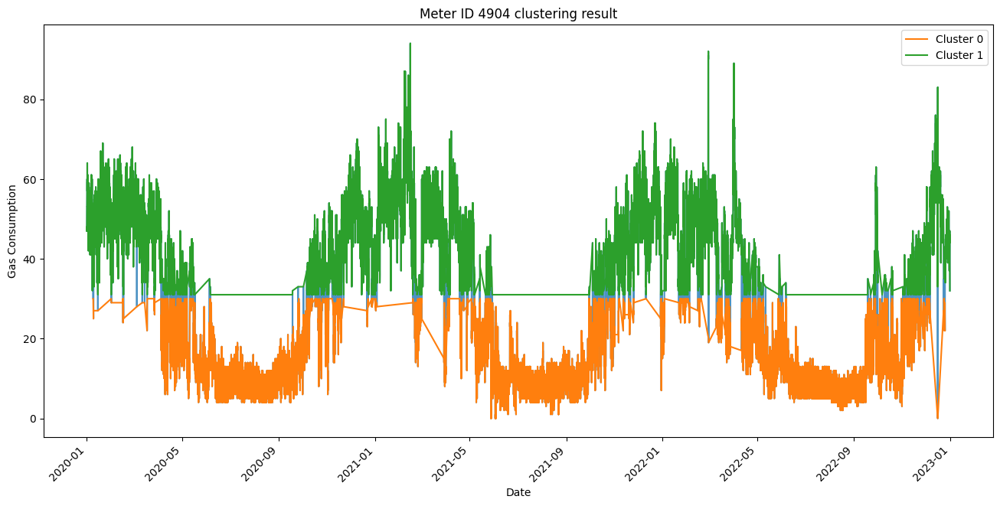

Optimal number of clusters for meter ID 4905: 3


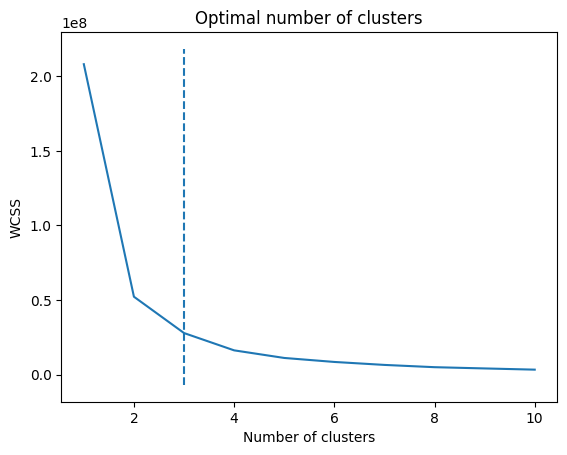

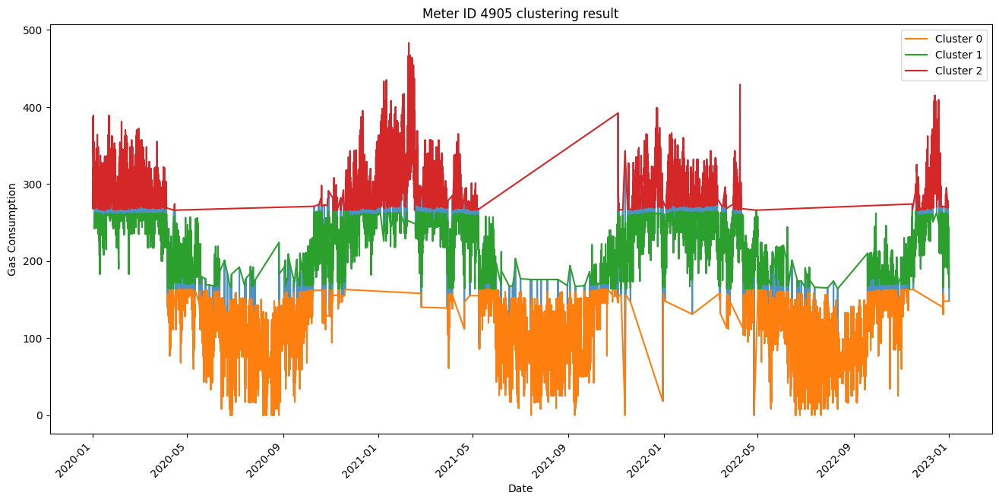

Optimal number of clusters for meter ID 40752: 3


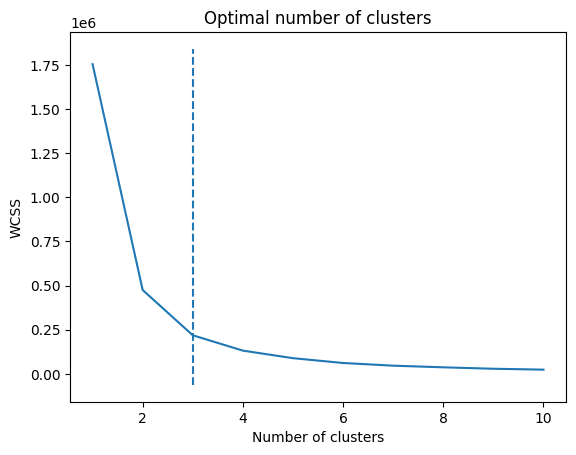

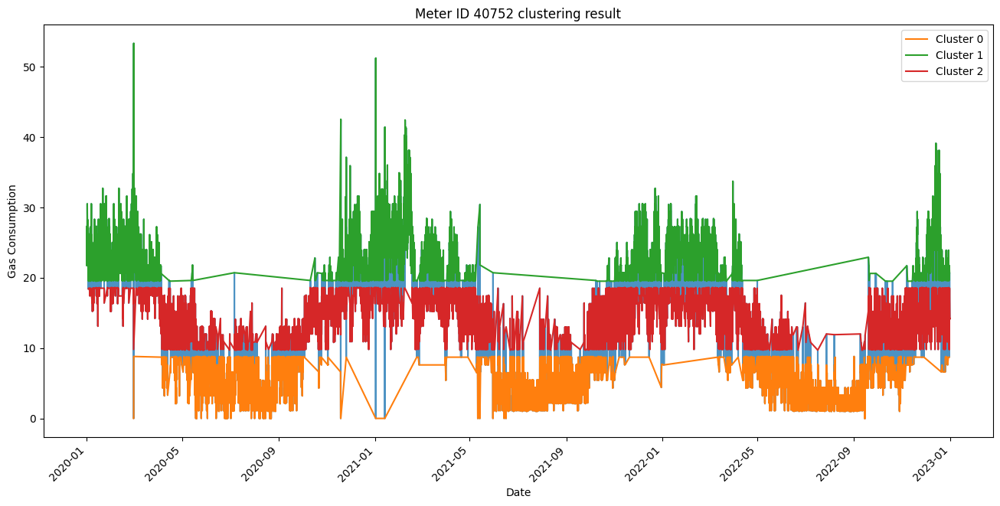

Optimal number of clusters for meter ID 40773: 3


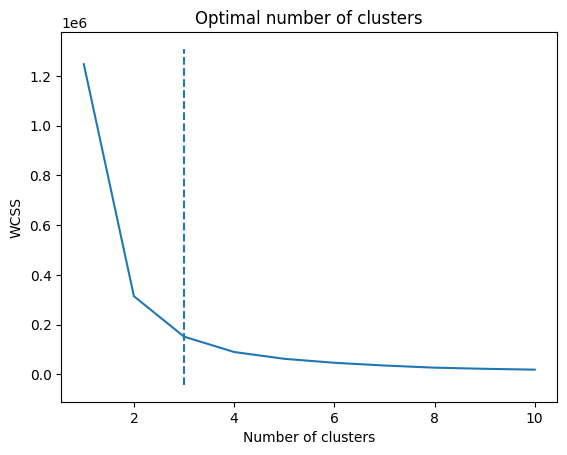

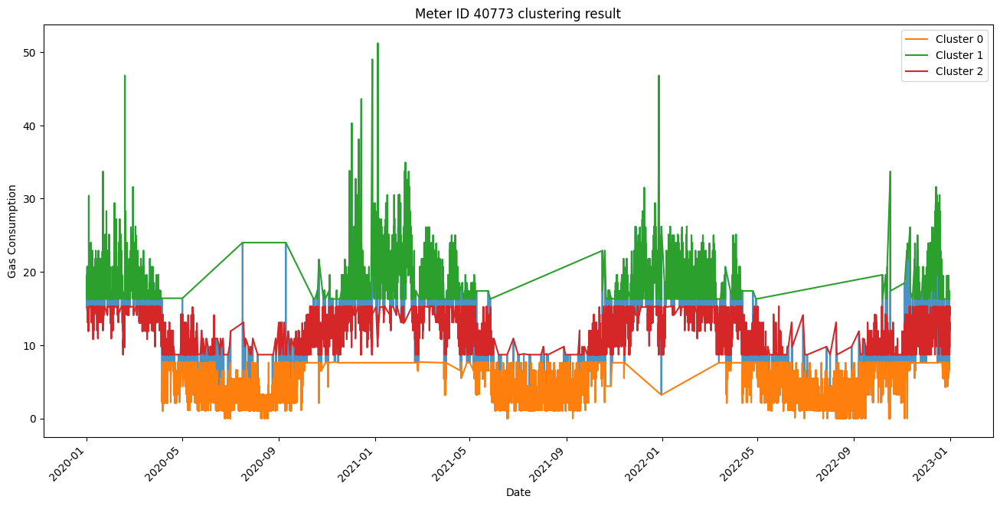

Optimal number of clusters for meter ID 40812: 3


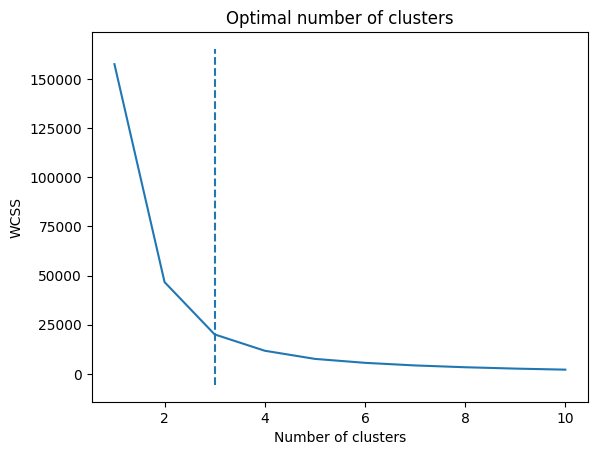

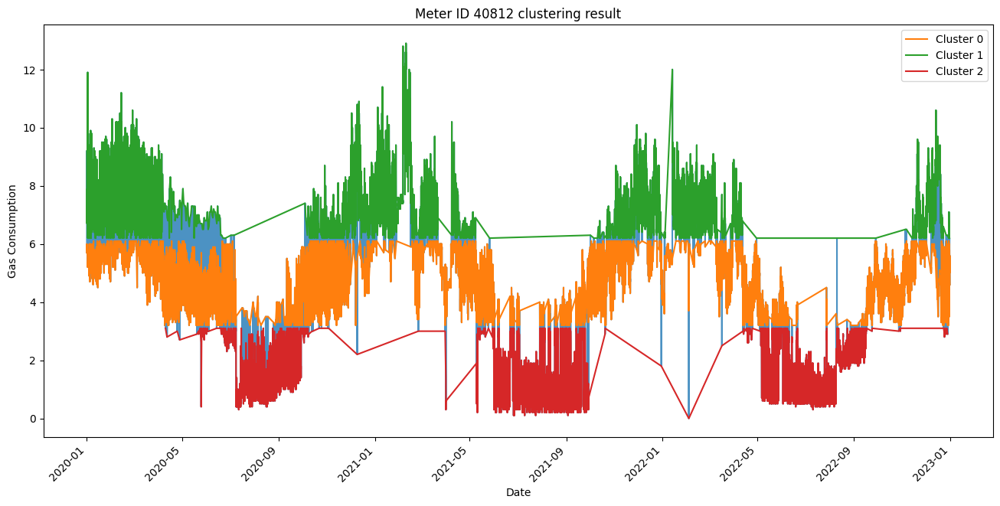

Optimal number of clusters for meter ID 41574: 3


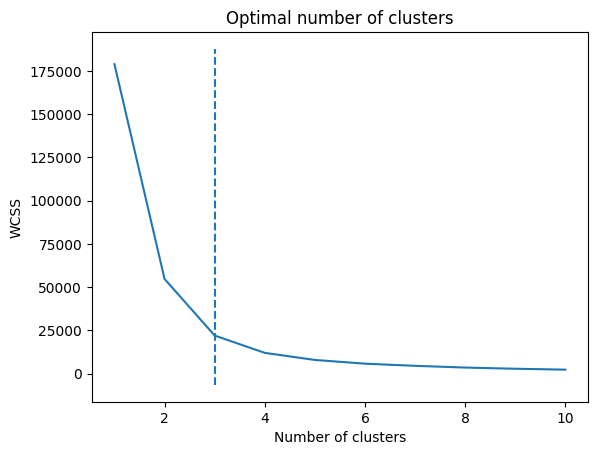

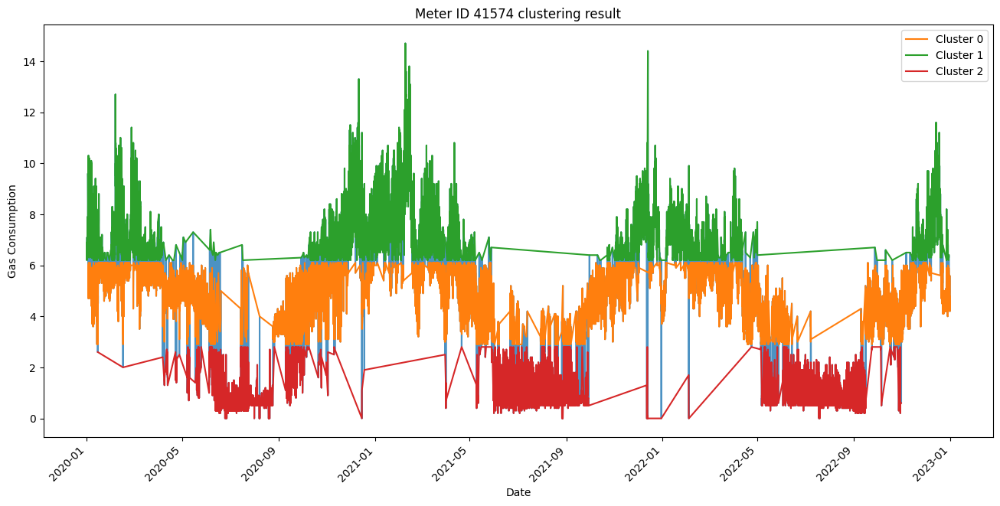

In [53]:
for meter_id in ids_and_descriptions:
    plot_gas_consumption_clusters(gas_data, meter_id)


In [51]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from kneed import KneeLocator
from tslearn.clustering import TimeSeriesKMeans

def analyze_and_plot_daily_meter_data_kmeans_substracted(gas_data, meter_id):
    # Copy gas_data and add area column
    gas_data_copy = gas_data.copy()
    
    # Filter data by meter_id
    gas_data_filtered = gas_data_copy[gas_data_copy['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')
    
    
    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]
    
    # Prepare data for Time Series K-Means
    data_prepared = data_daily_unstacked.to_numpy().reshape((data_daily_unstacked.shape[0], -1, 1))

    # Fit Time Series K-Means with elbow method to find optimal number of clusters
    wcss = []
    for i in range(1, 11):
        tskmeans = TimeSeriesKMeans(n_clusters=i, metric="dtw", random_state=42)
        tskmeans.fit(data_prepared)
        wcss.append(tskmeans.inertia_)
    kneedle = KneeLocator(range(1, 11), wcss, S=1.0, curve="convex", direction="decreasing")
    optimal_k = kneedle.knee


    # Perform clustering with optimal number of clusters
    tskmeans = TimeSeriesKMeans(n_clusters=optimal_k, metric="dtw", random_state=42)
    cluster_labels = tskmeans.fit_predict(data_prepared)

    # Group data by cluster
    cluster_groups = {}
    for cluster in range(optimal_k):
        cluster_data = data_daily_unstacked[cluster_labels == cluster]
        cluster_groups[cluster] = cluster_data
        
    # Find the global maximum and minimum gas consumption values across all clusters
    global_max = max(cluster_group.max().max() for cluster_group in cluster_groups.values())
    global_min = min(cluster_group.min().min() for cluster_group in cluster_groups.values())

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours
        

    for i, cluster_group in cluster_groups.items():

        cluster_data = cluster_group
        print(f'Cluster {i}: Count={len(cluster_data)}, Average={cluster_data.mean().mean()}')

        
        fig, ax = plt.subplots(figsize=(15, 5))
        for index, row in cluster_group.iterrows():
            # Get the color based on the heating months mask
            color = 'red'
            ax.plot(x_axis_values, row.values, color=color, alpha=0.1, label=None)
        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='black', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns (Cluster {i})")

        # Set the y-axis limits to the global maximum and minimum values
        ax.set_ylim(global_min, global_max)
        plt.show()
        
    return cluster_groups

In [107]:
import matplotlib.pyplot as plt
import calmap
from matplotlib.patches import Patch

def plot_calendar_heatmap_substracted(cluster_groups):
    # iterate over each cluster group for each meter ID
    for meter_id, cluster_groups in cluster_groups.items():
        # Get a list of cluster labels for each day
        cluster_labels_daily = {}
        for i, cluster_group in cluster_groups.items():
            # Get the dates for this cluster
            dates = cluster_group.index
            # For each date in this cluster, assign it the current cluster label
            for date in dates:
                cluster_labels_daily[date] = i

        # Create a pandas Series from cluster labels
        cluster_labels_series = pd.Series(cluster_labels_daily, index=pd.to_datetime(list(cluster_labels_daily.keys())))

        # Filter to only include dates from 2022
        cluster_labels_series = cluster_labels_series[cluster_labels_series.index.year == 2022]

        # Create calendar heatmap
        fig, ax = plt.subplots(figsize=(10, 8))
        calmap.yearplot(cluster_labels_series, year=2022, how=None, ax=ax, cmap='viridis')
        ax.set_title(f'Meter ID {meter_id} Daily Cluster Distribution')

        # Manually add a year label
        fig.text(0.13, 0.5, '2022', ha='center', va='center', rotation='vertical', fontsize=14)


        # Create legend
        unique_clusters = cluster_labels_series.unique()
        cmap = plt.cm.get_cmap('viridis', len(unique_clusters))
        legend_patches = [Patch(color=cmap(i / len(unique_clusters)), label=f'Cluster {cluster}') for i, cluster in enumerate(sorted(unique_clusters))]
        legend = ax.legend(handles=legend_patches, title='Clusters', bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.savefig(f"Meter_ID_{meter_id}_Daily_Cluster_Distribution.png", bbox_inches='tight', bbox_extra_artists=(legend,))
        plt.savefig(f"C:\\Users\\qwero\\OneDrive - Delft University of Technology\\Desktop\\Master Thisis\\single-building-substracted-calander\\Meter_ID_{meter_id}_Daily_Cluster_Distribution.png", bbox_inches='tight', bbox_extra_artists=(legend,))

        plt.show()



In [108]:
import matplotlib.pyplot as plt
import numpy as np

def plot_cluster_results_substracted(cluster_groups):
    # create an array with values from 0 to 23 representing hours
    x_axis_values = np.arange(24)

    # iterate over each cluster group for each meter ID
    for meter_id, cluster_groups in cluster_groups.items():
        building_number = id_and_building.get(meter_id, "Unknown")
        for i, cluster_group in cluster_groups.items():
            print(f'Meter ID {meter_id}: Cluster {i}: Count={len(cluster_group)}, Average={cluster_group.mean().mean()}')

            # plot the average hourly gas consumption pattern for this cluster
            fig, ax = plt.subplots(figsize=(13, 5))
            cluster_average = cluster_group.mean()
            ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')
            ax.set_xlabel("Hour")
            ax.set_ylabel("Gas Consumption")
            ax.set_title(f"Meter ID {meter_id} - Building {building_number}: Typical Gas Usage Profiles (Cluster {i}, Percentage: {len(cluster_group)/1096*100:.0f}%)")
            ax.set_xlim(0, 23)
            
            # Save the image to a specified location
            plt.savefig(f"C:\\Users\\qwero\\OneDrive - Delft University of Technology\\Desktop\\Master Thisis\\single-building-clustering-result-substracted-average\\Meter_ID_{meter_id}_Cluster_{i}.png")
            plt.show()


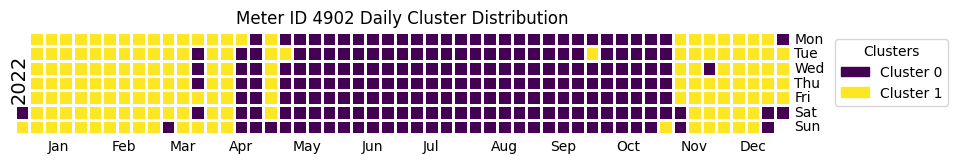

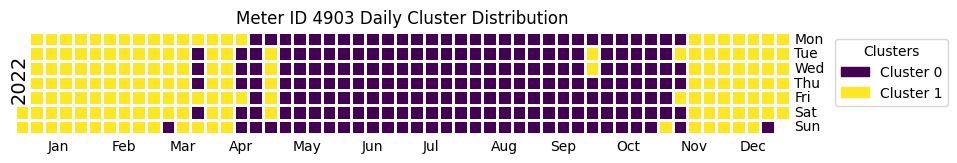

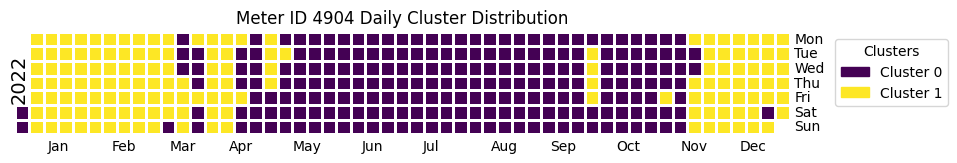

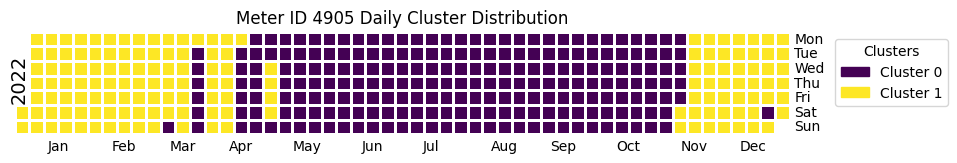

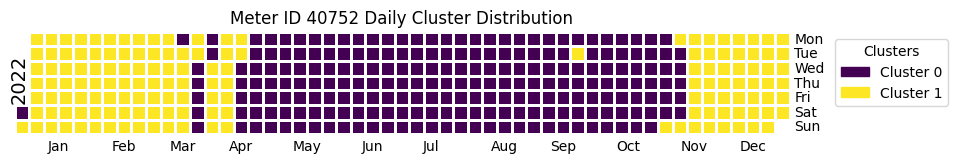

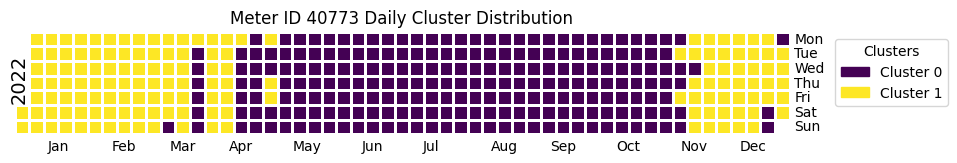

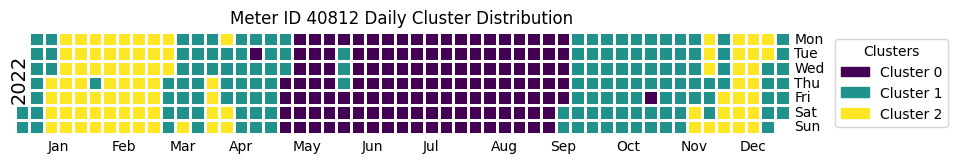

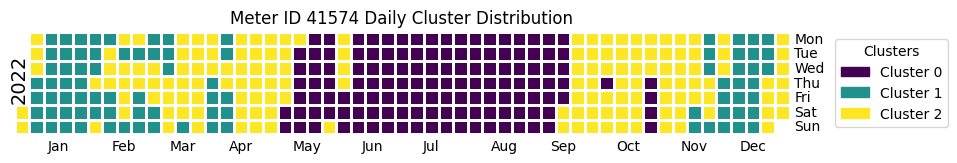

In [110]:
 plot_calendar_heatmap_substracted(cluster_groups_scaled_substracted)

Meter ID 4902: Cluster 0: Count=619, Average=0.00026336870480502173


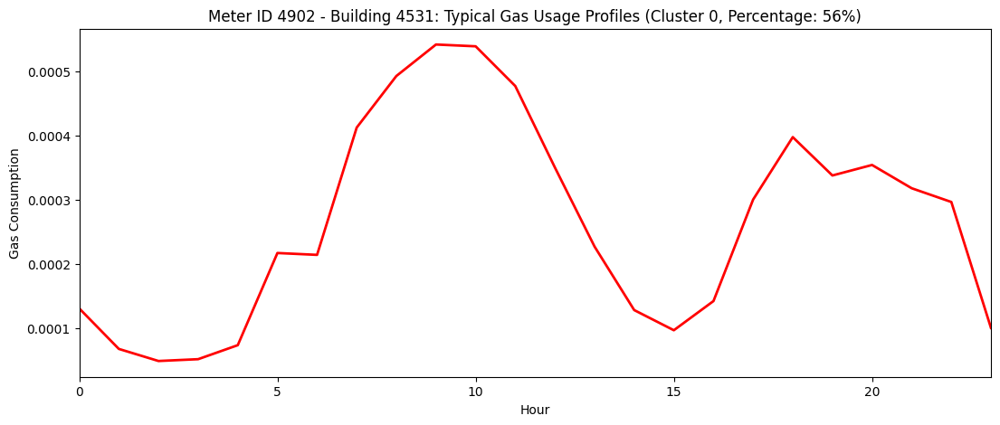

Meter ID 4902: Cluster 1: Count=477, Average=0.003685349046957779


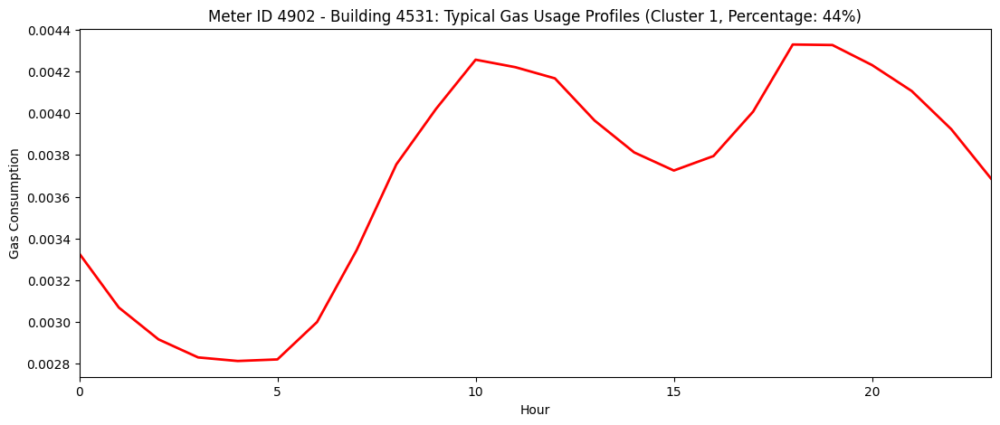

Meter ID 4903: Cluster 0: Count=585, Average=0.0002019848791879249


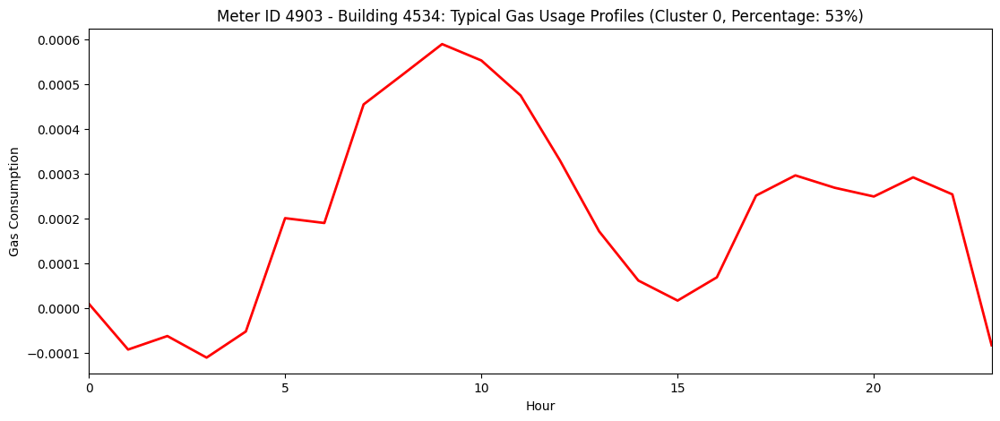

Meter ID 4903: Cluster 1: Count=511, Average=0.003859563219445892


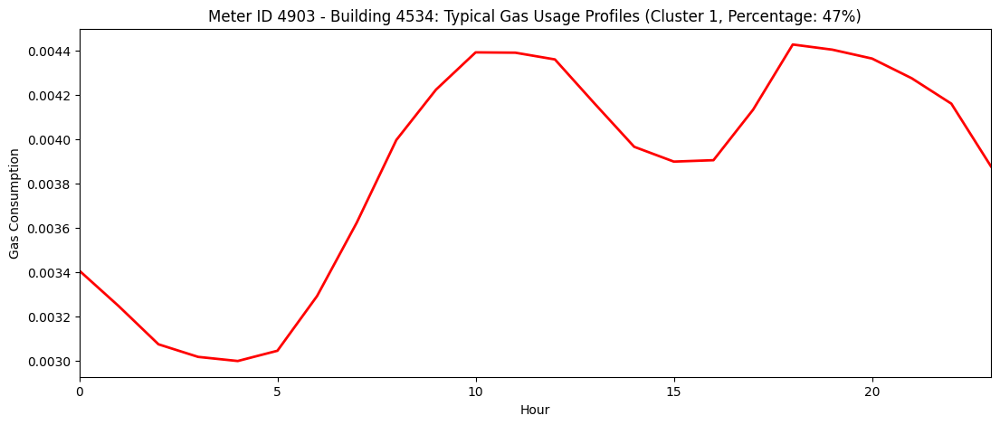

Meter ID 4904: Cluster 0: Count=585, Average=0.0001776947556744504


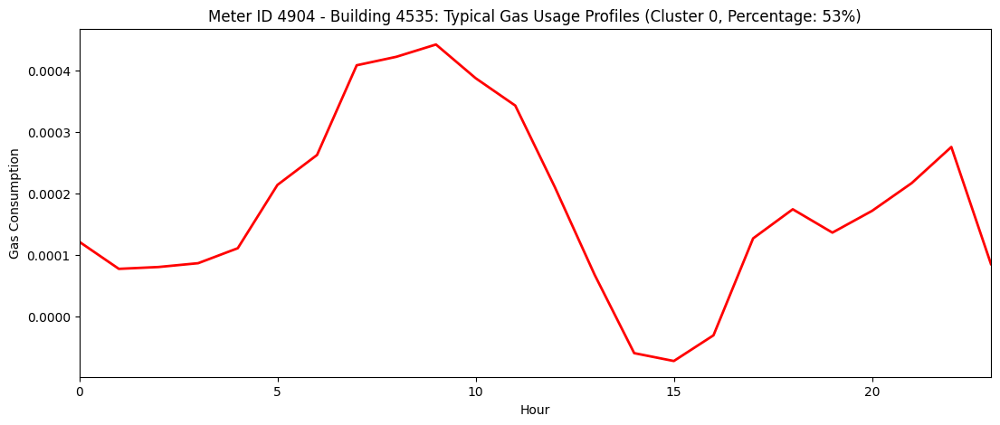

Meter ID 4904: Cluster 1: Count=511, Average=0.004022959036533388


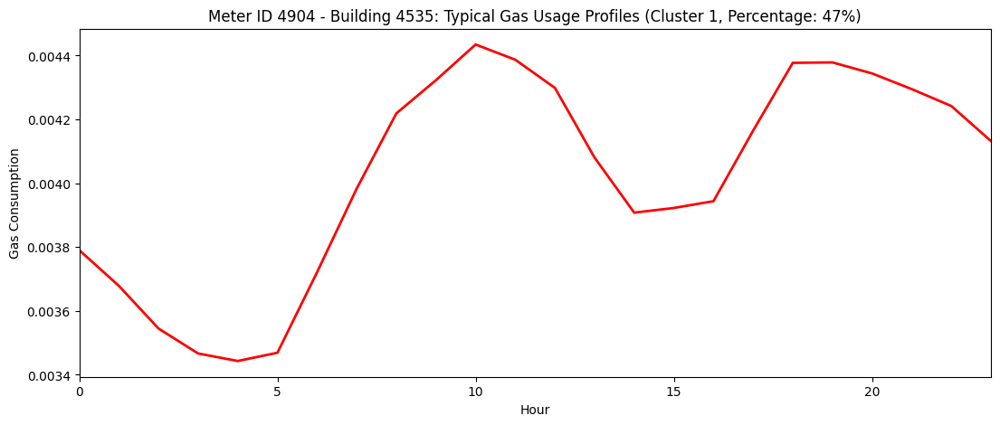

Meter ID 4905: Cluster 0: Count=593, Average=0.00023815899192886994


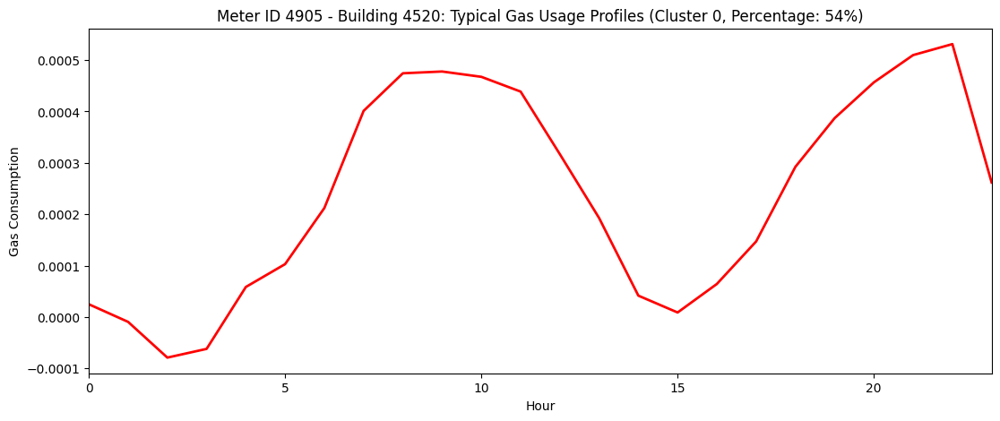

Meter ID 4905: Cluster 1: Count=503, Average=0.0031279084175307747


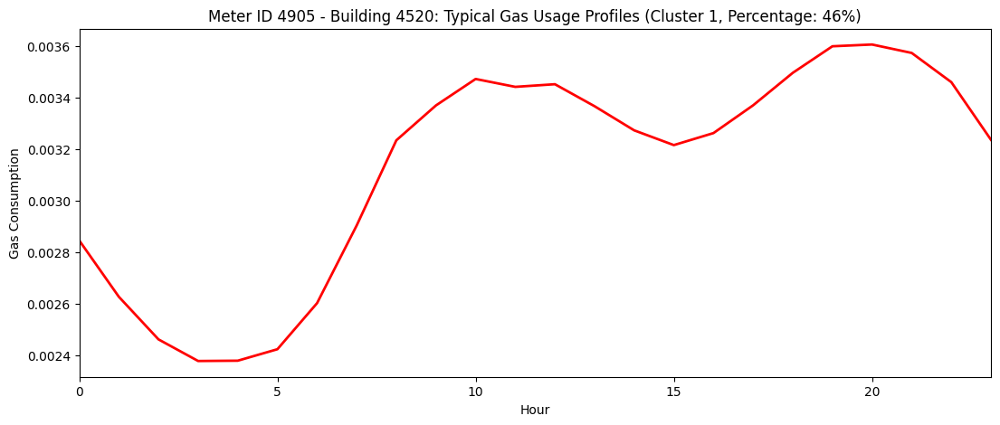

Meter ID 40752: Cluster 0: Count=586, Average=0.0006490378645081039


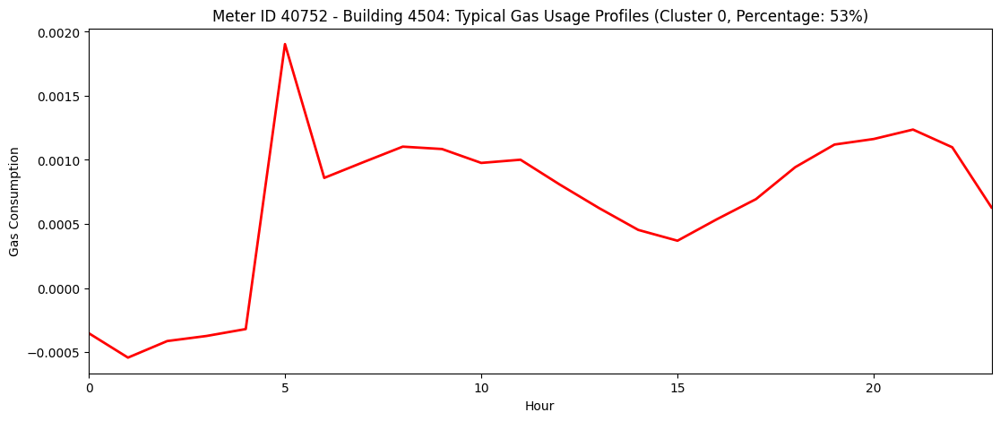

Meter ID 40752: Cluster 1: Count=510, Average=0.008063576799300955


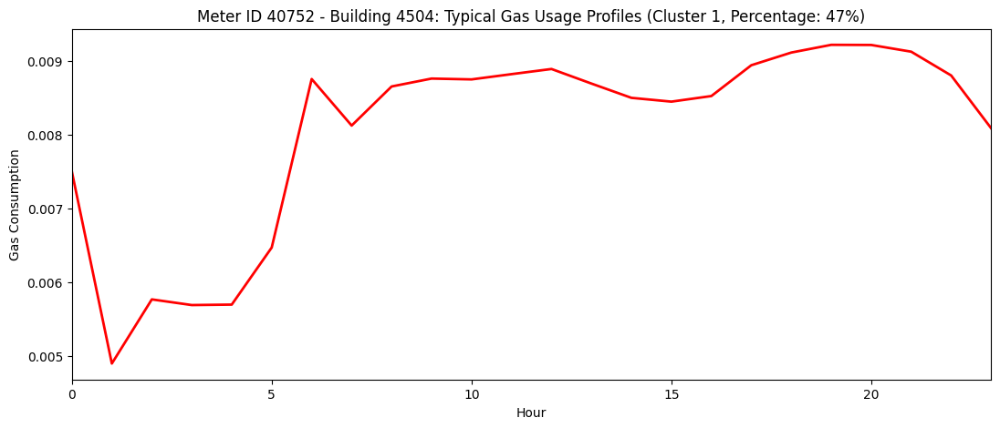

Meter ID 40773: Cluster 0: Count=584, Average=0.0004221944846810955


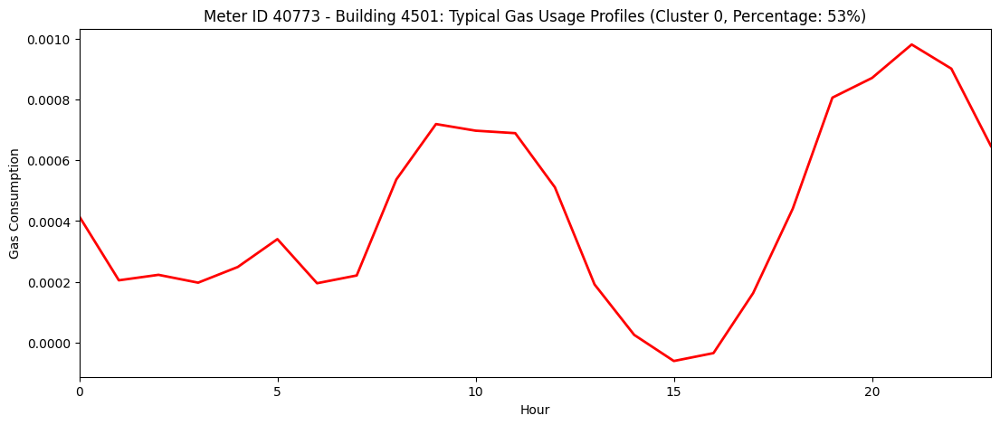

Meter ID 40773: Cluster 1: Count=512, Average=0.006687508945563095


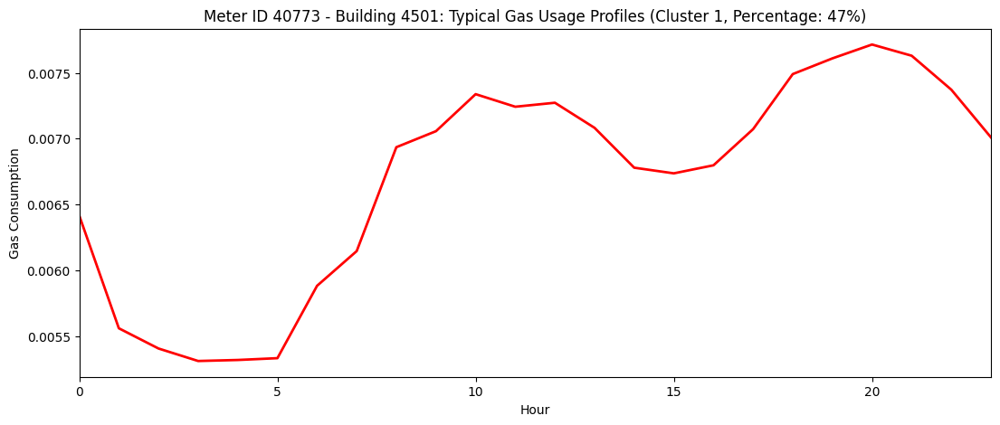

Meter ID 40812: Cluster 0: Count=344, Average=-0.0004330810194529599


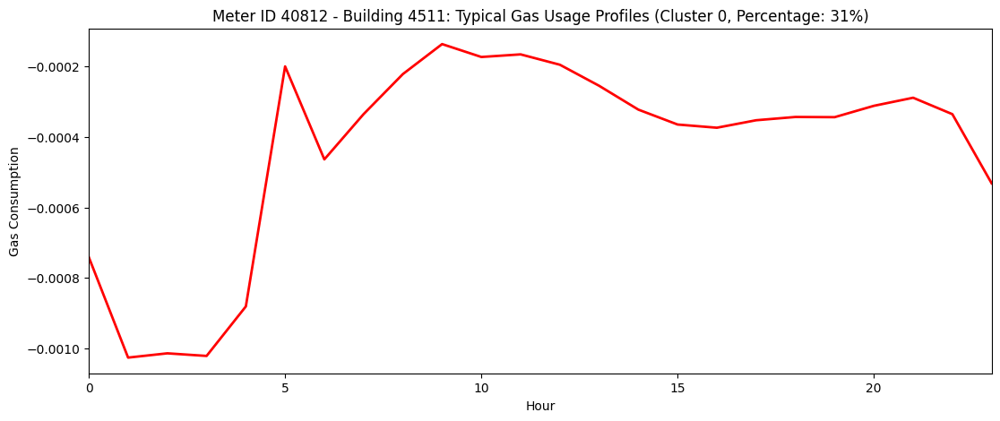

Meter ID 40812: Cluster 1: Count=446, Average=0.001677087425415128


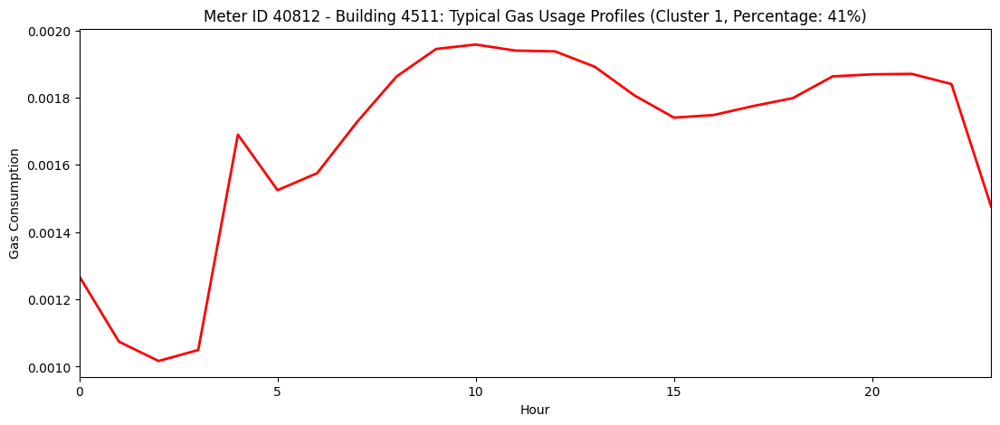

Meter ID 40812: Cluster 2: Count=306, Average=0.00325883401552228


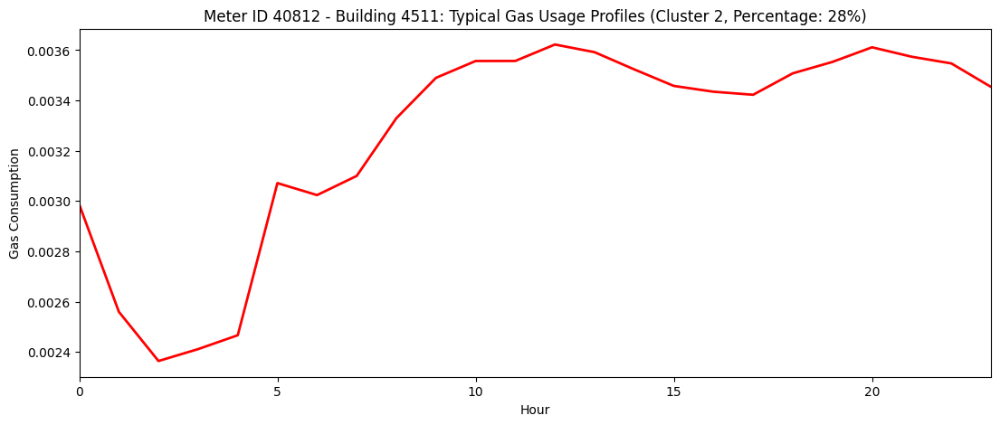

Meter ID 41574: Cluster 0: Count=359, Average=-0.0003407335774933123


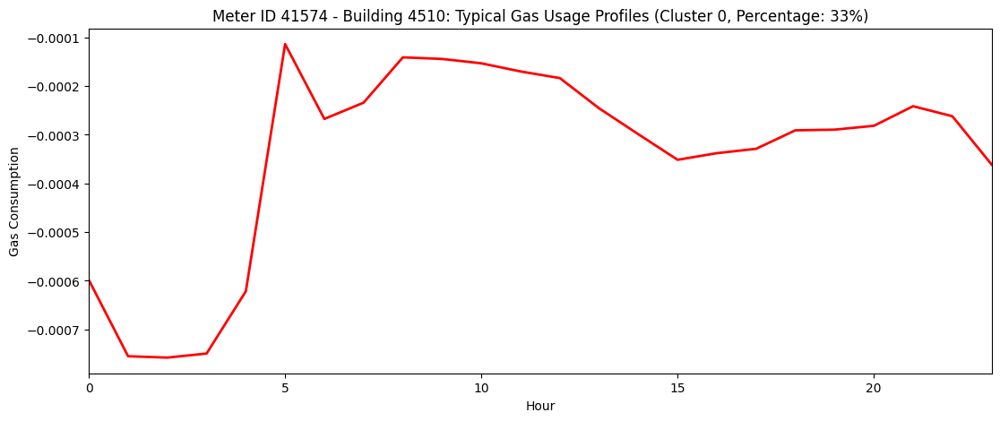

Meter ID 41574: Cluster 1: Count=308, Average=0.0029346833142308505


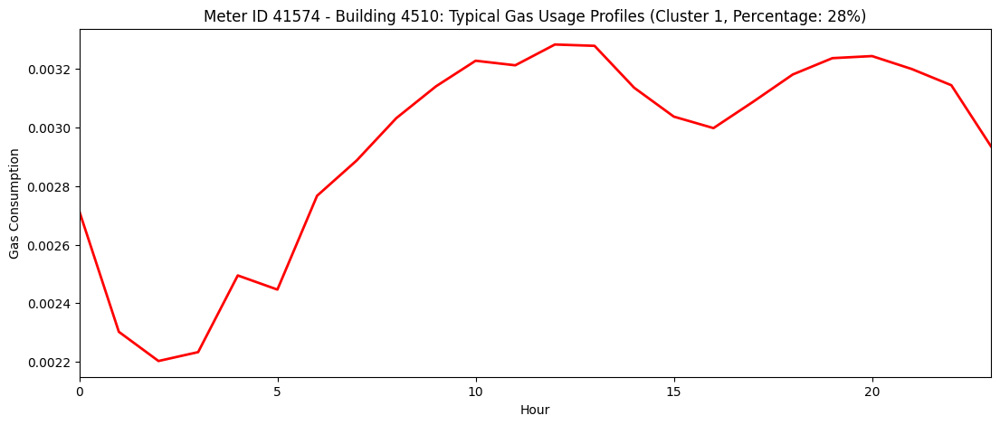

Meter ID 41574: Cluster 2: Count=429, Average=0.0015293562380194574


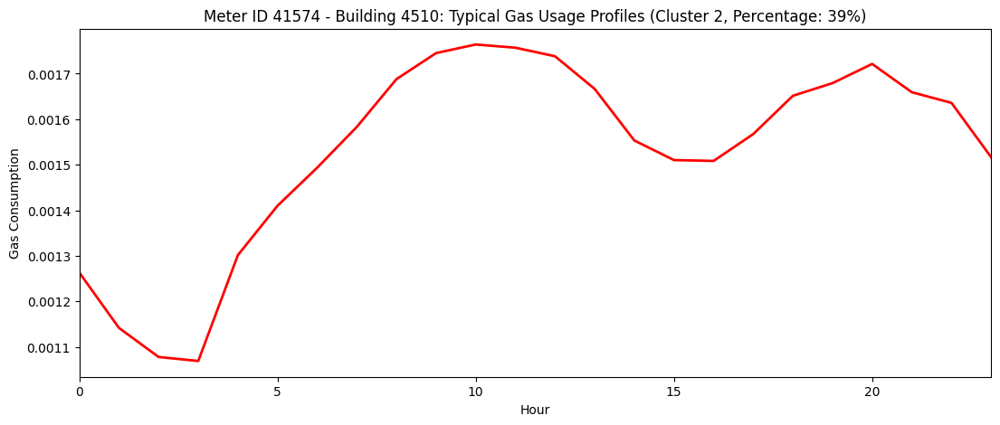

In [111]:
cluster_groups_result = cluster_groups_scaled_substracted.copy()
plot_cluster_results_substracted(cluster_groups_result)


The code calculates the pairwise distances between each pair of daily time series using the Dynamic Time Warping (DTW) metric. The DTW metric is a measure of the similarity between two time series that takes into account both the values and the temporal alignment of the data points.

In the context of your code, the data_daily_unstacked DataFrame contains daily gas consumption data, where each row represents a day and the columns represent hourly gas consumption values. The distance calculation loop iterates through all pairs of rows (i.e., all pairs of days) and computes the DTW distance between the hourly gas consumption time series of these two days. This information is then stored in the distances matrix.

The purpose of this step is to create a matrix of pairwise distances between all daily time series, which can then be used for clustering. In this case, hierarchical clustering is used to group similar daily gas consumption patterns together.

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:30: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


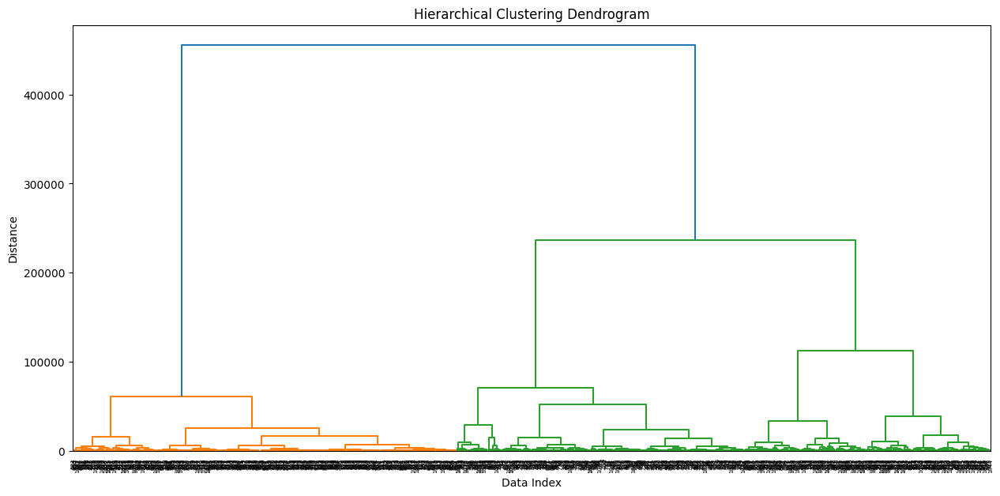

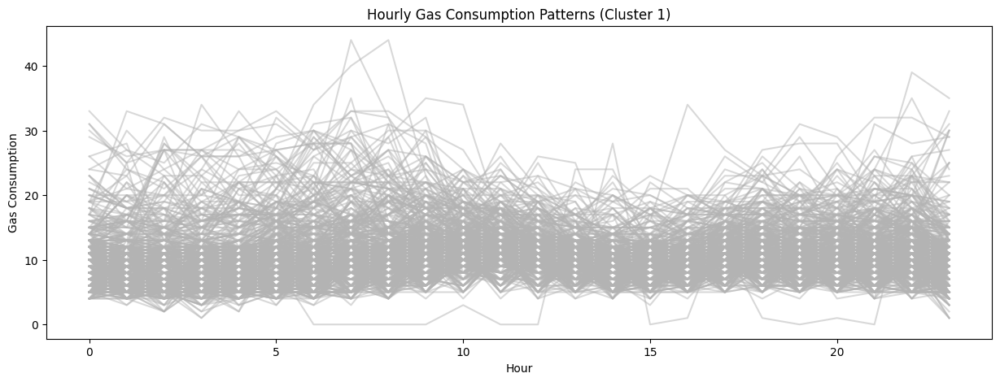

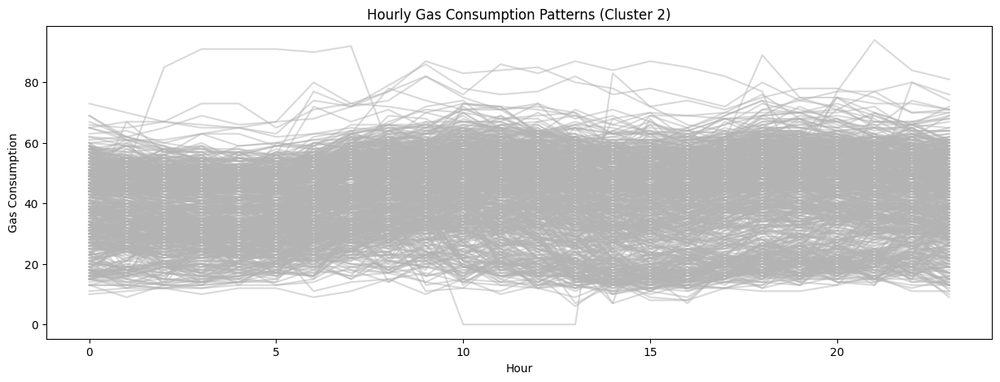

In [176]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from dtw import dtw, accelerated_dtw

# Replace this with your actual data
data = gas_data_pivot
data.index = pd.to_datetime(data.index, utc=True)

# Group data by day and hour
data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
data_daily_grouped.index.names = ['date', 'hour']

# Unstack hours to form columns
data_daily_unstacked = data_daily_grouped.unstack(level=-1)
data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]

# Compute the pairwise distances using the DTW metric
n_rows = len(data_daily_unstacked)
distances = np.zeros((n_rows, n_rows))
for i in range(n_rows):
    for j in range(i+1, n_rows):
        dist, _, _, _ = accelerated_dtw(data_daily_unstacked.iloc[i].values, data_daily_unstacked.iloc[j].values, dist='euclidean')
        distances[i, j] = dist
        distances[j, i] = dist

# Perform hierarchical clustering using the 'ward' method
Z = linkage(distances, method='ward')



One common approach to determine the optimal number of clusters for hierarchical clustering is to use a dendrogram.  Visually inspect the dendrogram and look for a horizontal line that, when extended, would cross the maximum number of vertical lines without intersecting any other horizontal lines. isually inspect the dendrogram and look for a horizontal line that, when extended, would cross the maximum number of vertical lines without intersecting any other horizontal lines. 

In [49]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from kneed import KneeLocator
from tslearn.clustering import TimeSeriesKMeans

def analyze_and_plot_daily_meter_data_kmeans_scaled(gas_data, meter_id):
    # Copy gas_data and add area column
    gas_data_copy = gas_data.copy()
    gas_data_copy['area'] = gas_data_copy['meter_id'].map(ids_and_area)

    # Scale the value by the area
    gas_data_copy['value'] = gas_data_copy['value'] / gas_data_copy['area']
    
    # Filter data by meter_id
    gas_data_filtered = gas_data_copy[gas_data_copy['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')
    
    
    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]
    
    # Prepare data for Time Series K-Means
    data_prepared = data_daily_unstacked.to_numpy().reshape((data_daily_unstacked.shape[0], -1, 1))

    # Fit Time Series K-Means with elbow method to find optimal number of clusters
    wcss = []
    for i in range(1, 11):
        tskmeans = TimeSeriesKMeans(n_clusters=i, metric="dtw", random_state=42)
        tskmeans.fit(data_prepared)
        wcss.append(tskmeans.inertia_)
    kneedle = KneeLocator(range(1, 11), wcss, S=1.0, curve="convex", direction="decreasing")
    optimal_k = kneedle.knee


    # Perform clustering with optimal number of clusters
    tskmeans = TimeSeriesKMeans(n_clusters=optimal_k, metric="dtw", random_state=42)
    cluster_labels = tskmeans.fit_predict(data_prepared)

    # Group data by cluster
    cluster_groups = {}
    for cluster in range(optimal_k):
        cluster_data = data_daily_unstacked[cluster_labels == cluster]
        cluster_groups[cluster] = cluster_data
        
    # Find the global maximum and minimum gas consumption values across all clusters
    global_max = max(cluster_group.max().max() for cluster_group in cluster_groups.values())
    global_min = min(cluster_group.min().min() for cluster_group in cluster_groups.values())

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours
        

    for i, cluster_group in cluster_groups.items():

        cluster_data = cluster_group
        print(f'Cluster {i}: Count={len(cluster_data)}, Average={cluster_data.mean().mean()}')

        # Create a boolean mask for the heating months (October to April)
        heating_months = (pd.to_datetime(cluster_group.index).month >= 10) | (pd.to_datetime(cluster_group.index).month <= 4)
        
        fig, ax = plt.subplots(figsize=(15, 5))
        j = 0
        for index, row in cluster_group.iterrows():
            # Get the color based on the heating months mask
            color = 'red' if heating_months[j] else 'blue'
            j+=1
            ax.plot(x_axis_values, row.values, color=color, alpha=0.1, label=None)
#             # Plot dummy lines with the same color and label for the legend
#             ax.plot([], [], color='red', alpha=0.5, label=f'Heating Months (Avg={cluster_group[heating_months].mean().mean():.2f}, Count={heating_months.sum()//24})')
#             ax.plot([], [], color='blue', alpha=0.5, label=f'Non-Heating Months (Avg={cluster_group[~heating_months].mean().mean():.2f}, Count={(~heating_months).sum()//24})')

        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='black', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns (Cluster count {i})")

        # Set the y-axis limits to the global maximum and minimum values
        ax.set_ylim(global_min, global_max)
        plt.show()
        
    return cluster_groups

Cluster 0: Count=619, Average=0.0015789876207264776


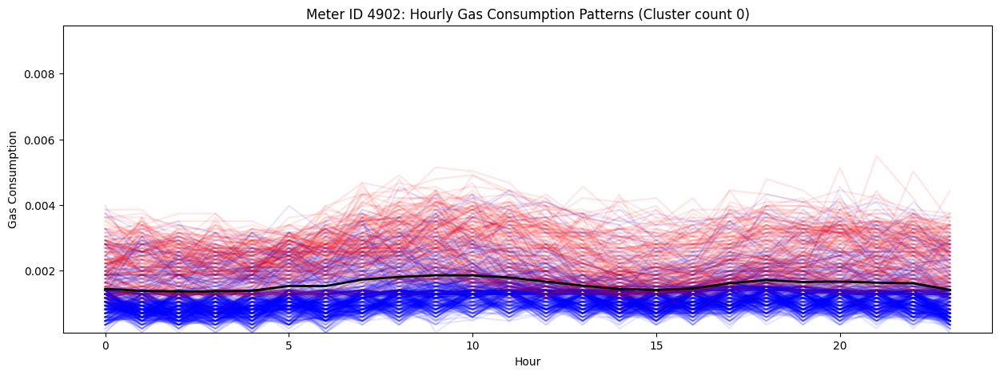

Cluster 1: Count=477, Average=0.005000967962879239


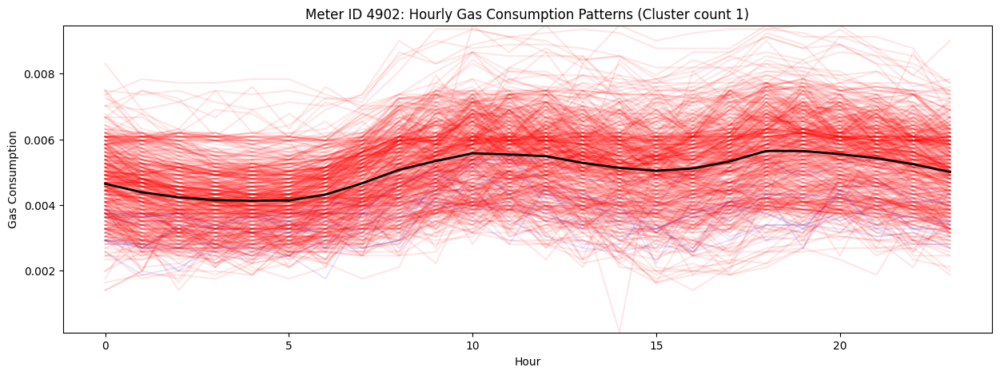

Cluster 0: Count=585, Average=0.0015449503231567995


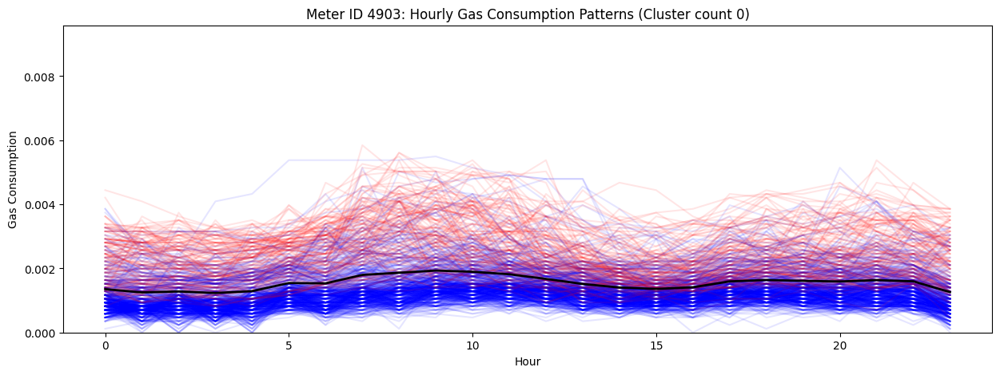

Cluster 1: Count=511, Average=0.005202528663414774


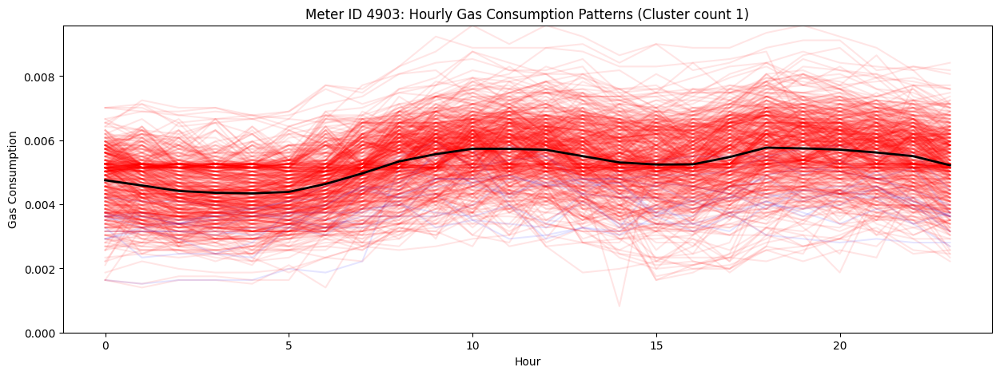

Cluster 0: Count=585, Average=0.0016236101450086478


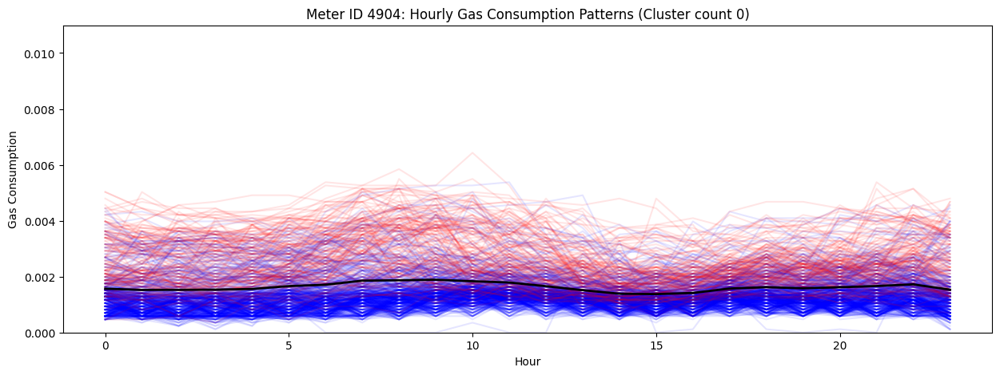

Cluster 1: Count=511, Average=0.005468874425867583


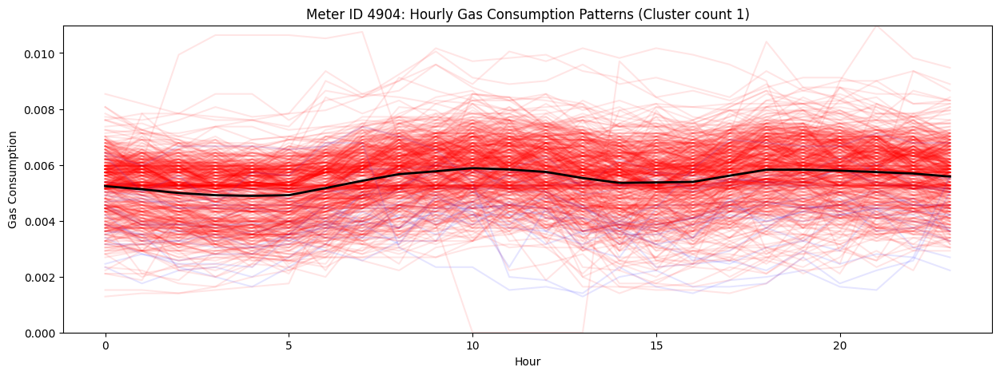

Cluster 0: Count=593, Average=0.002406518082614904


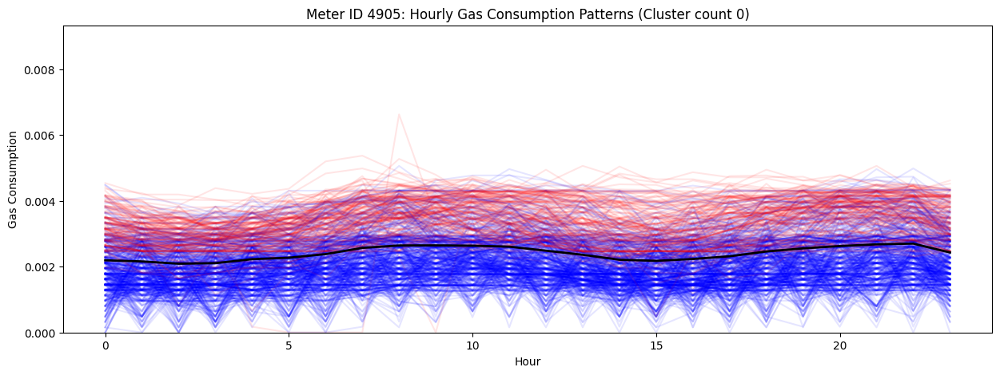

Cluster 1: Count=503, Average=0.005296267508216807


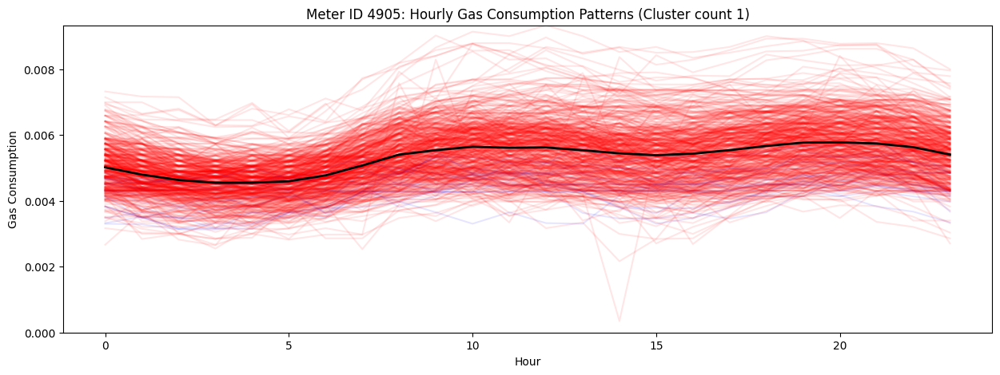

Cluster 0: Count=586, Average=0.004223249439857385


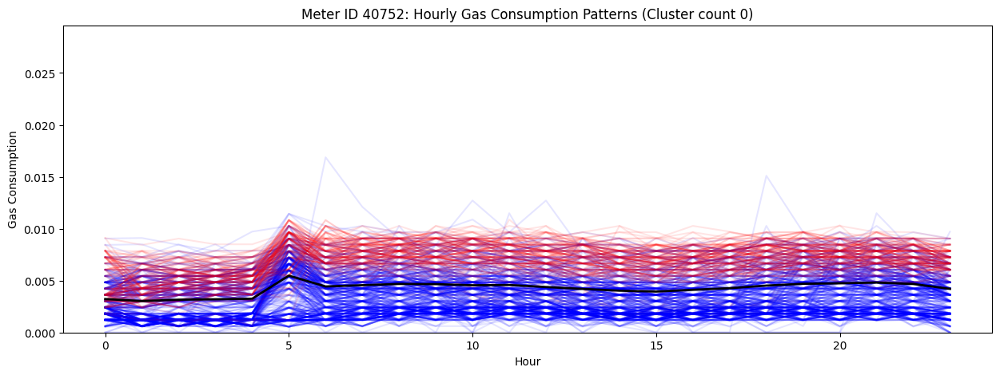

Cluster 1: Count=510, Average=0.011637788374650253


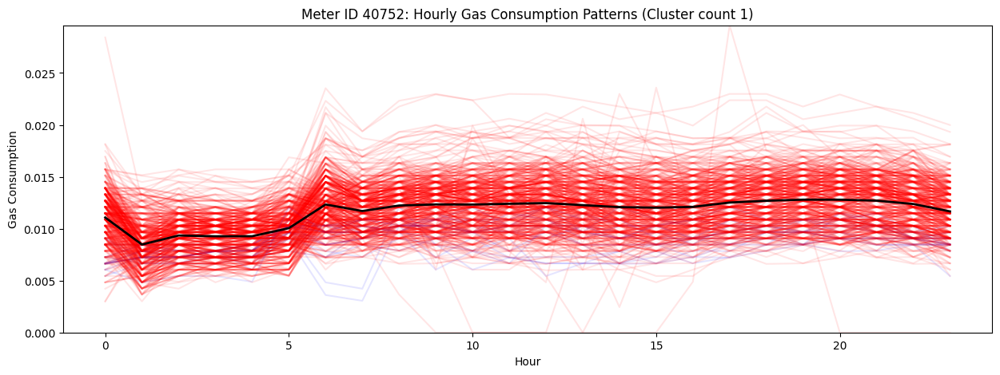

Cluster 0: Count=584, Average=0.0029128054876281246


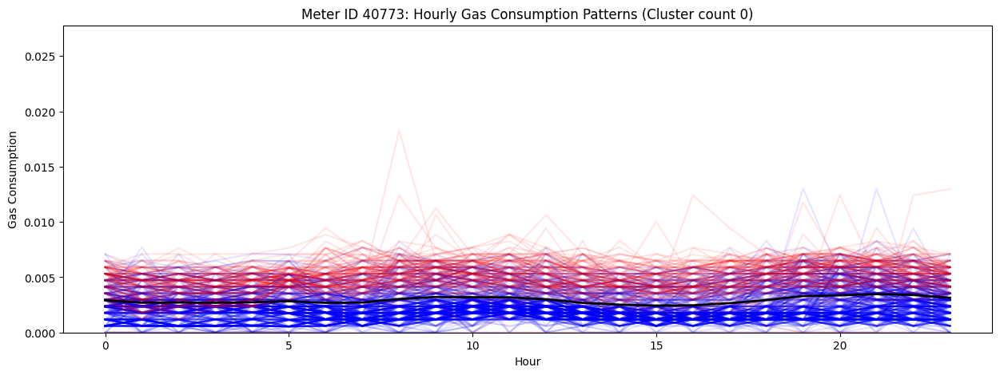

Cluster 1: Count=512, Average=0.009178119948510127


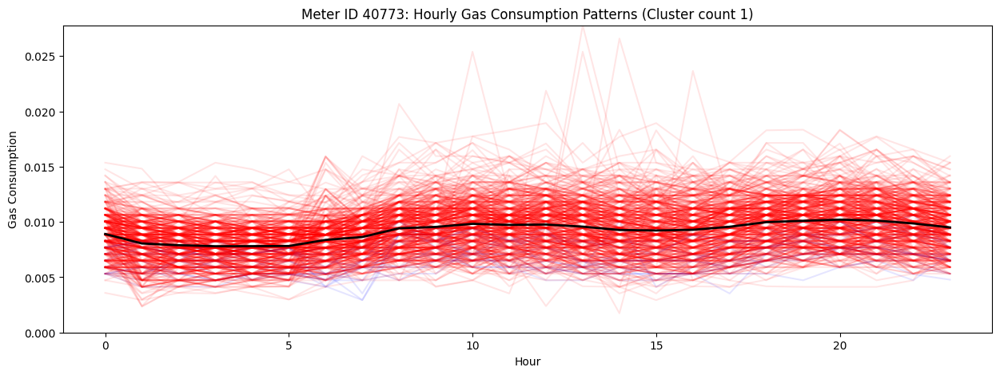

Cluster 0: Count=344, Average=0.00120556311462155


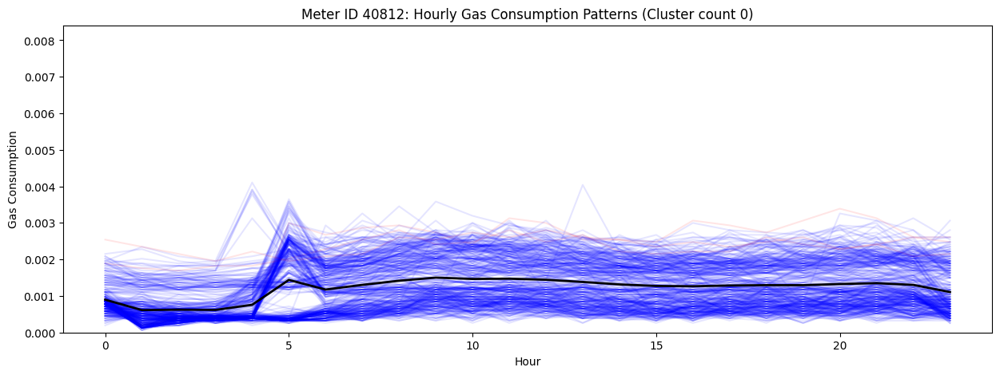

Cluster 1: Count=446, Average=0.0033157315594896327


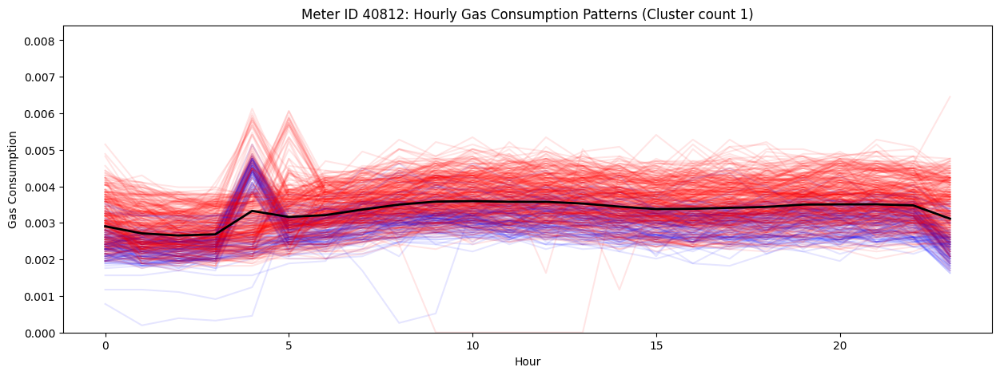

Cluster 2: Count=306, Average=0.004897478149596794


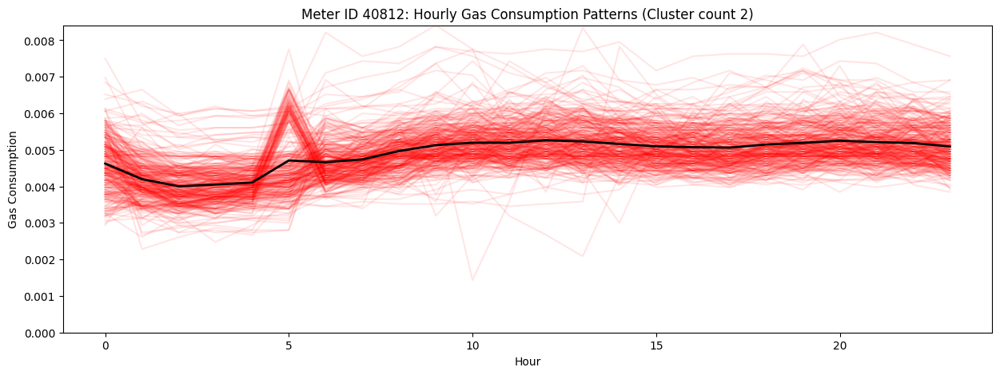

Cluster 0: Count=359, Average=0.0008580990639553086


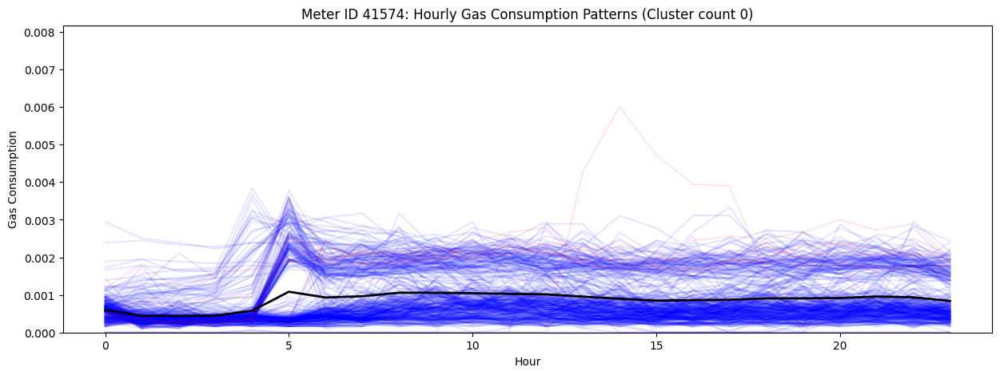

Cluster 1: Count=308, Average=0.00413351595567947


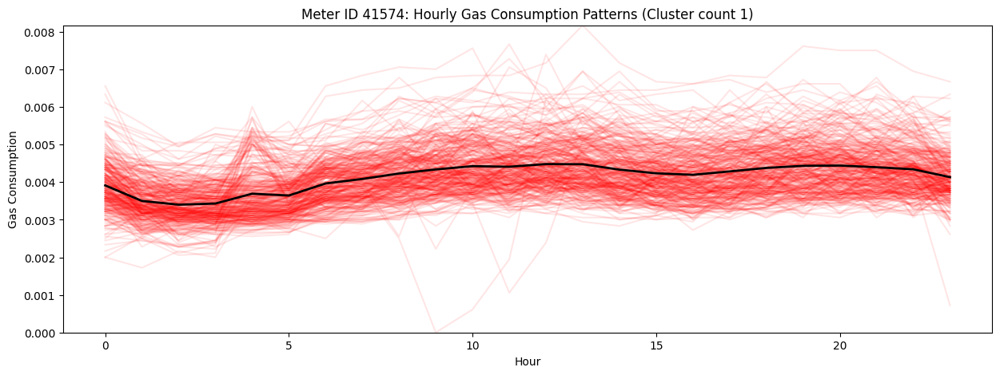

Cluster 2: Count=429, Average=0.002728188879468079


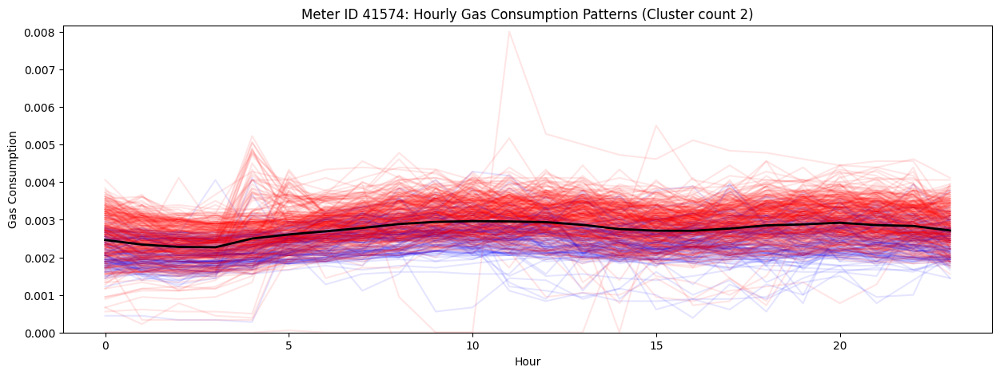

In [10]:
cluster_groups = {}  # declare empty dictionary outside the loop

for meter_id in ids_and_descriptions:
    cluster_groups[meter_id] = analyze_and_plot_daily_meter_data_kmeans_scaled(gas_data, meter_id)


In [13]:
from tslearn.clustering import TimeSeriesKMeans
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from kneed import KneeLocator
def analyze_and_plot_daily_meter_data_kmeans_optimalk(gas_data, meter_id, optimal_k):
    # Filter data by meter_id
    gas_data_filtered = gas_data[gas_data['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')
    
    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]
    
    # Prepare data for Time Series K-Means
    data_prepared = data_daily_unstacked.to_numpy().reshape((data_daily_unstacked.shape[0], -1, 1))

    # Perform clustering with optimal number of clusters
    tskmeans = TimeSeriesKMeans(n_clusters=optimal_k, metric="dtw", random_state=42)
    cluster_labels = tskmeans.fit_predict(data_prepared)

    # Group data by cluster
    cluster_groups = {}
    for cluster in range(optimal_k):
        cluster_data = data_daily_unstacked[cluster_labels == cluster]
        cluster_groups[cluster] = cluster_data
        
    # Find the global maximum and minimum gas consumption values across all clusters
    global_max = max(cluster_group.max().max() for cluster_group in cluster_groups.values())
    global_min = min(cluster_group.min().min() for cluster_group in cluster_groups.values())

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours

    building_number = id_and_building.get(meter_id, "Unknown")
    for i, cluster_group in cluster_groups.items():

        cluster_data = cluster_group
        print(f'Cluster {i}: Count={len(cluster_data)}, Average={cluster_data.mean().mean()}')

        # Create a boolean mask for the heating months (October to April)
        heating_months = (pd.to_datetime(cluster_group.index).month >= 10) | (pd.to_datetime(cluster_group.index).month <= 4)
        
        fig, ax = plt.subplots(figsize=(13, 5))
        j = 0
        for index, row in cluster_group.iterrows():
            # Get the color based on the heating months mask
            color = 'red' if heating_months[j] else 'blue'
            j+=1
            ax.plot(x_axis_values, row.values, color=color, alpha=0.1, label=None)

        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='black', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id} - Building {building_number}: Hourly Gas Consumption Patterns (Cluster count {len(cluster_group)}, {len(cluster_group)/1096*100:.0f}%)")

        # Set the y-axis limits to the global maximum and minimum values
        ax.set_ylim(global_min, global_max)
        ax.set_xlim(0, 23)
        
        # Save the image to a specified location
        plt.savefig(f"C:\\Users\\qwero\\OneDrive - Delft University of Technology\\Desktop\\Master Thisis\\single-building-clustering-result\\Meter_ID_{meter_id}_Cluster_{i}.png")
        plt.show()
        
    return cluster_groups


## NEWEST

Cluster 0: Count=630, Average=13.75452380952381


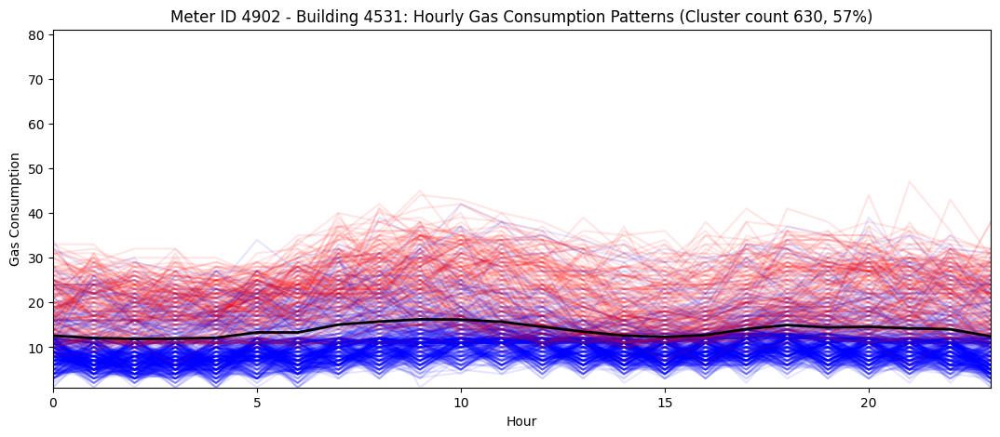

Cluster 1: Count=466, Average=43.1413626609442


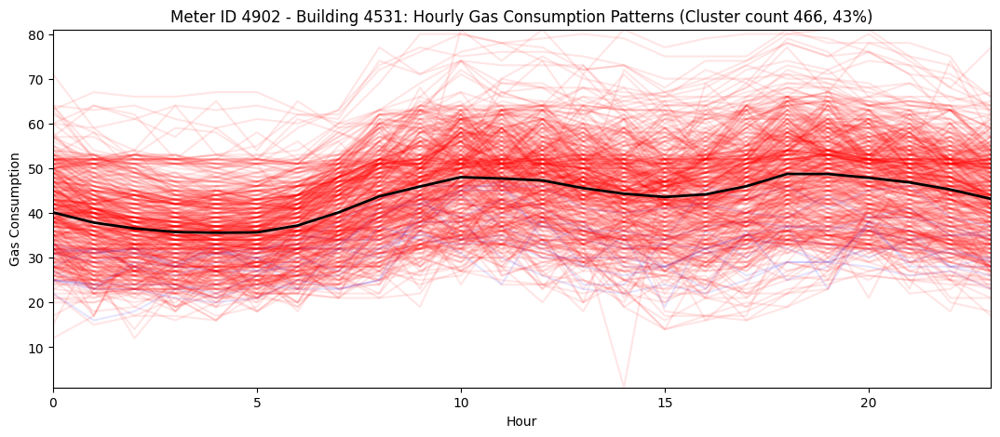

Cluster 0: Count=585, Average=13.213960113960113


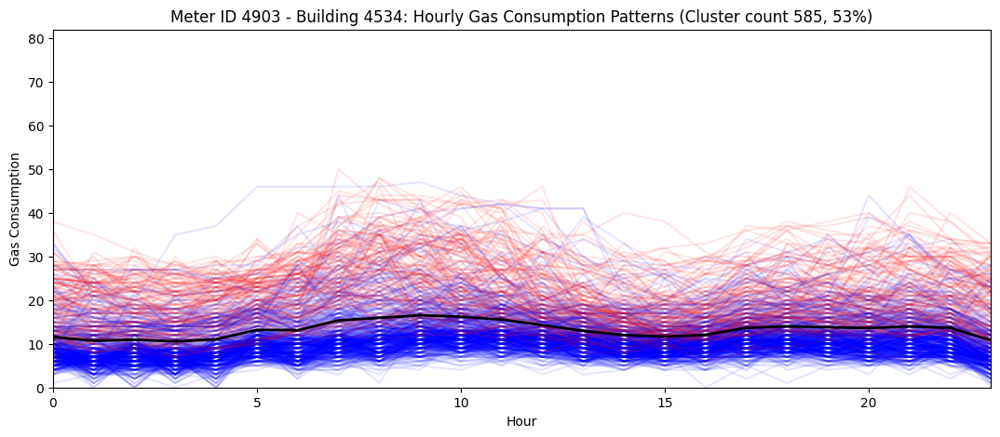

Cluster 1: Count=511, Average=44.49722765818657


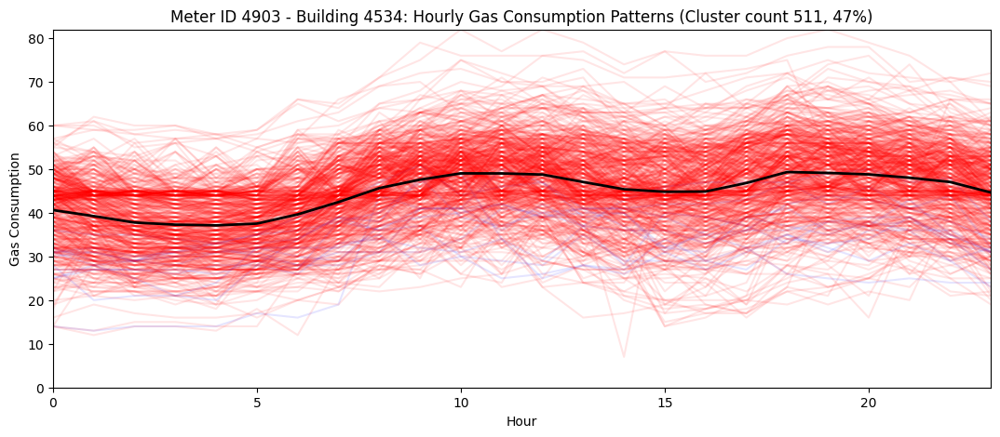

Cluster 0: Count=578, Average=13.696366782006919


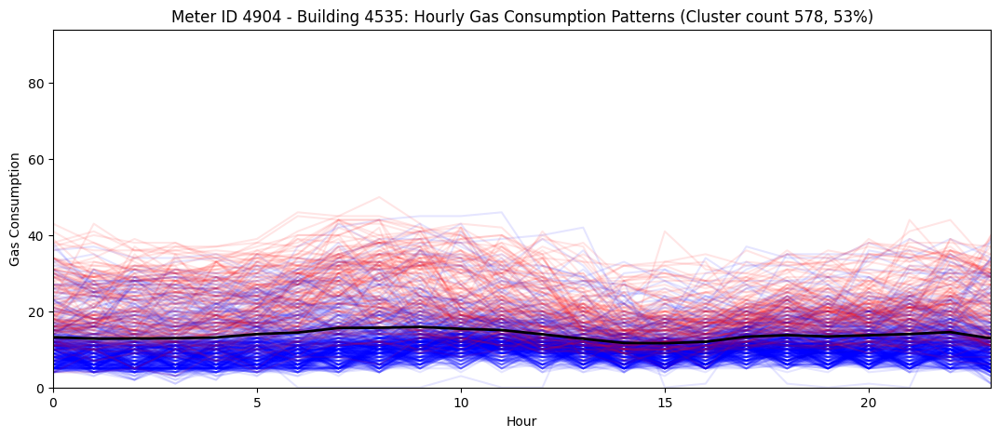

Cluster 1: Count=518, Average=46.53603603603603


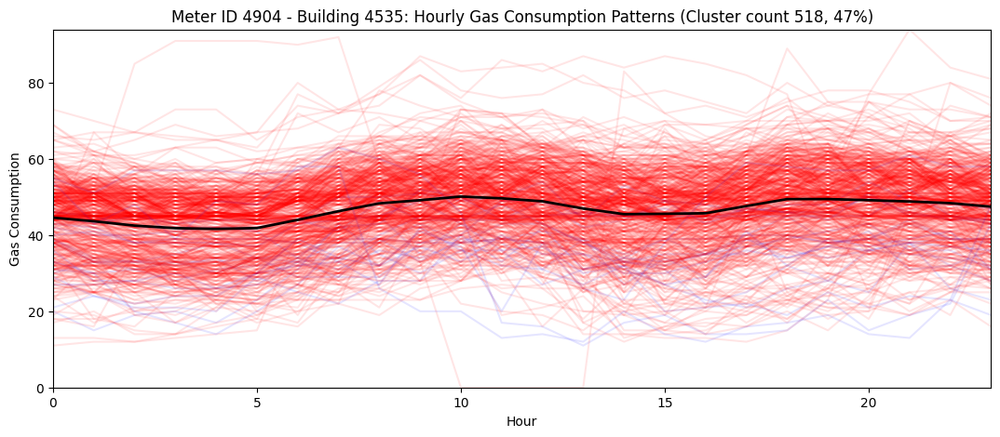

Cluster 0: Count=577, Average=122.43796938186019


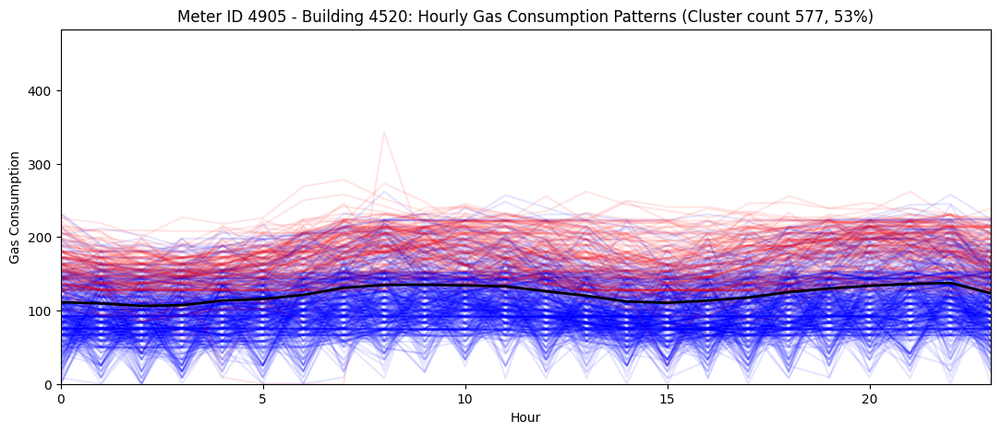

Cluster 1: Count=519, Average=271.9316795118818


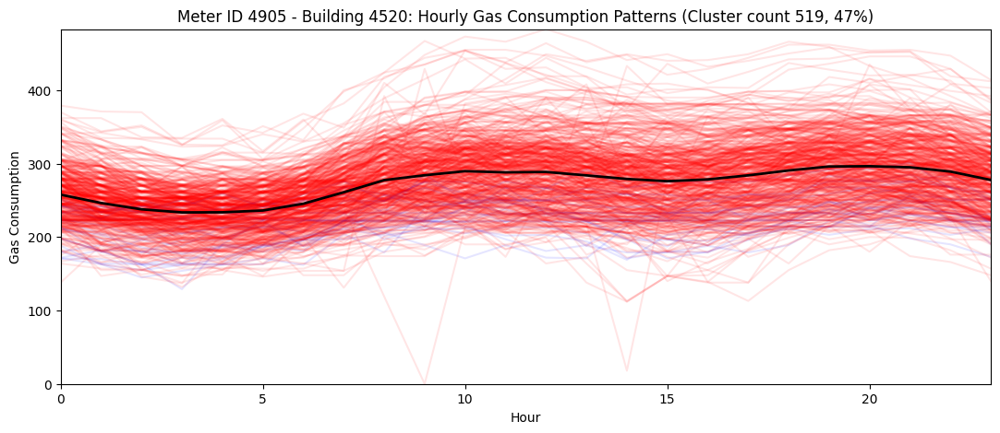

Cluster 0: Count=571, Average=7.430399883245761


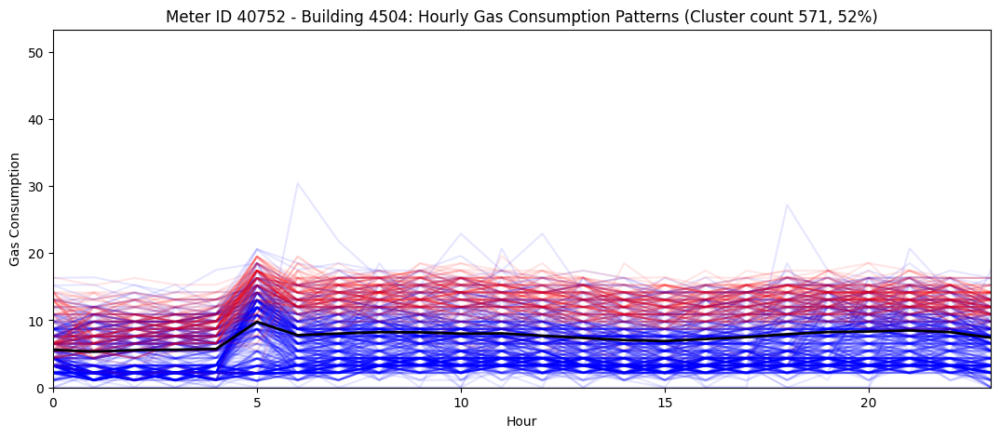

Cluster 1: Count=525, Average=20.76919047619047


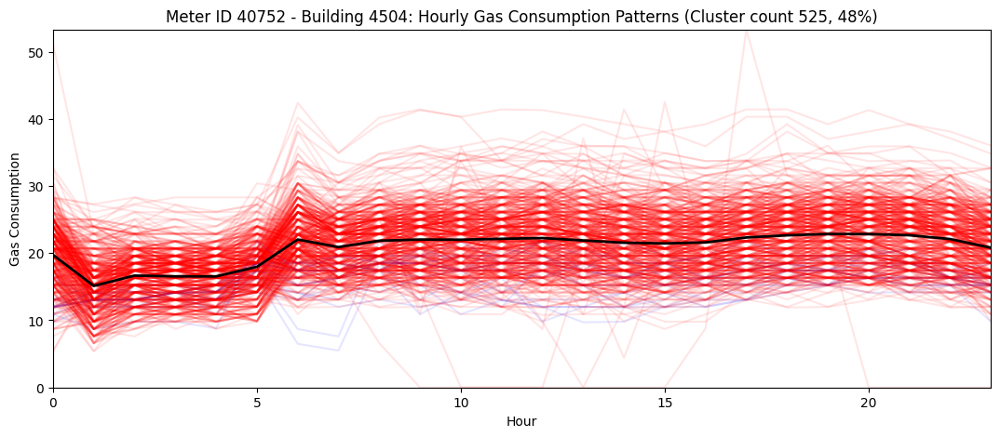

Cluster 0: Count=583, Average=5.3588336192109765


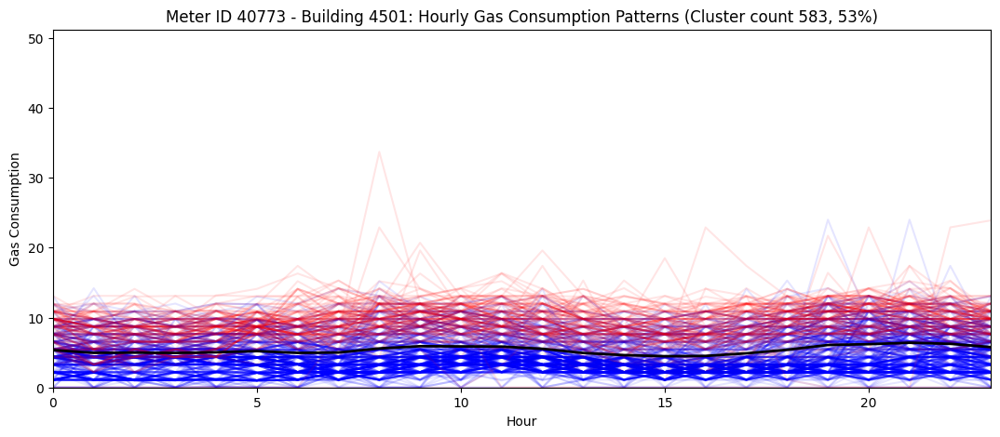

Cluster 1: Count=513, Average=16.903525016244313


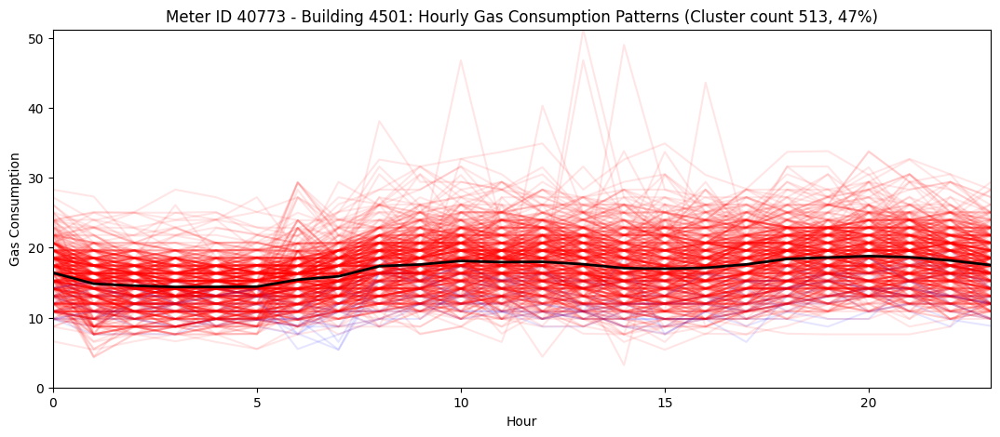

Cluster 0: Count=334, Average=1.7961077844311377


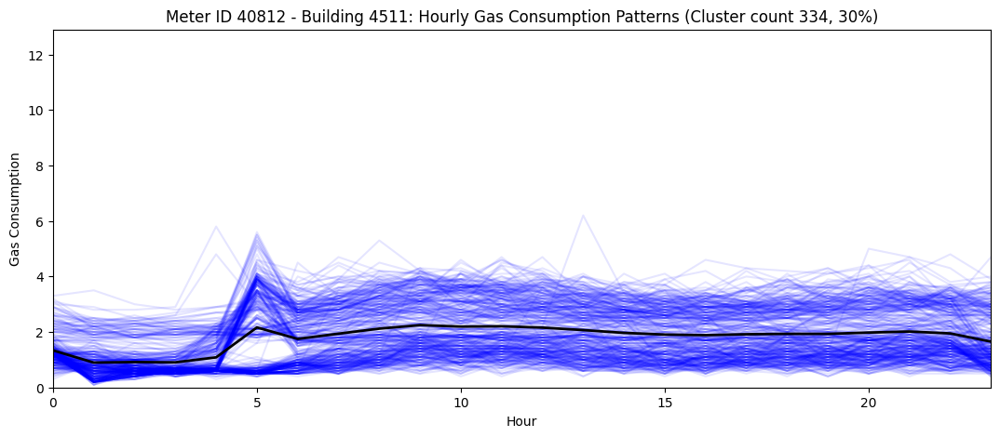

Cluster 1: Count=412, Average=4.90956715210356


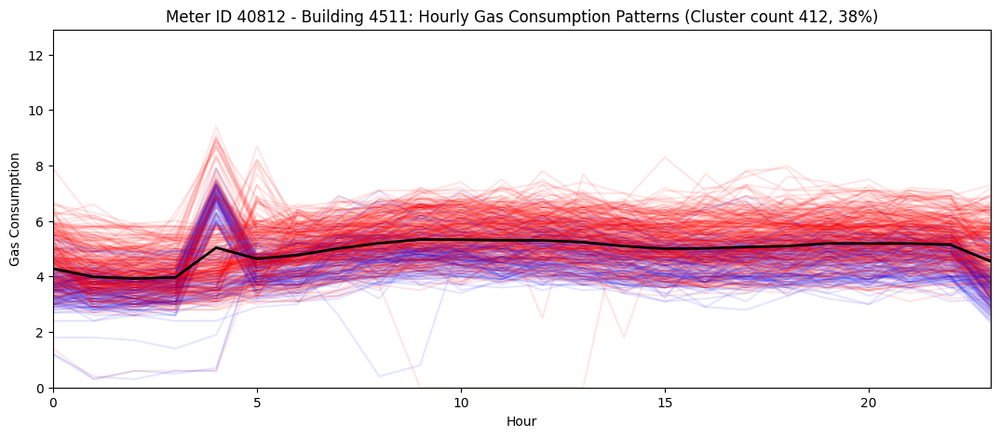

Cluster 2: Count=350, Average=7.374083333333334


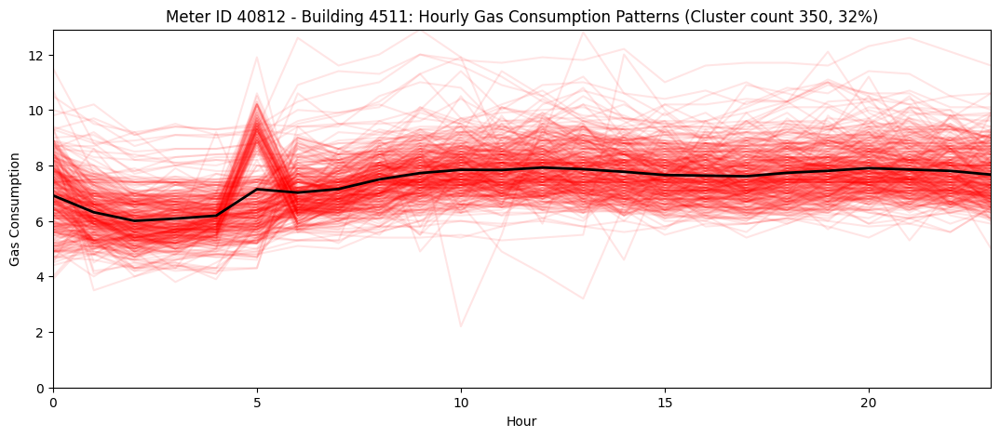

Cluster 0: Count=356, Average=1.5351357677902626


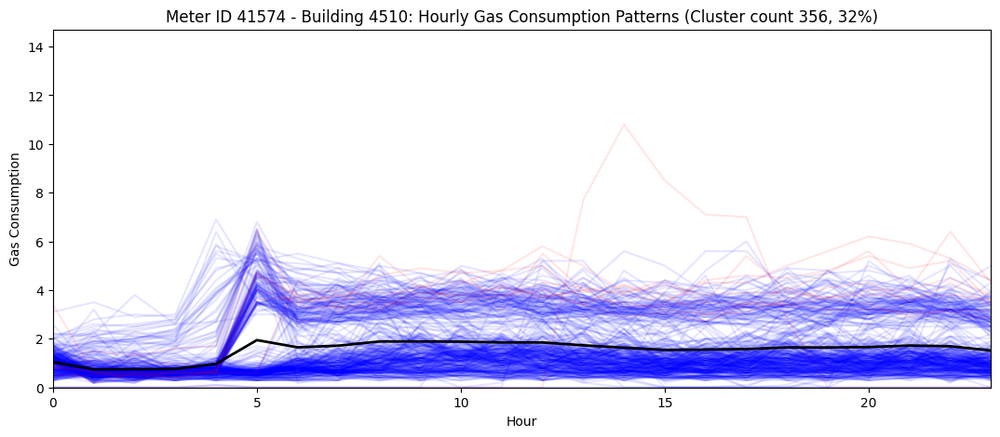

Cluster 1: Count=307, Average=7.442833876221499


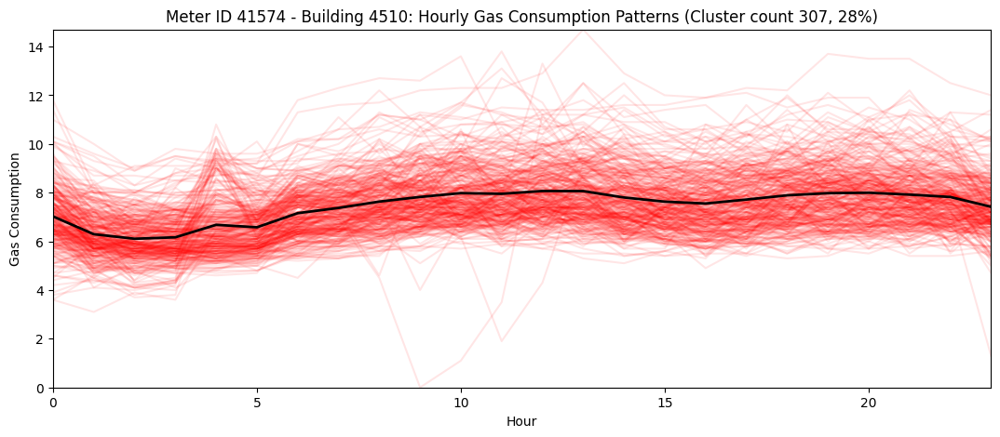

Cluster 2: Count=433, Average=4.886537721324095


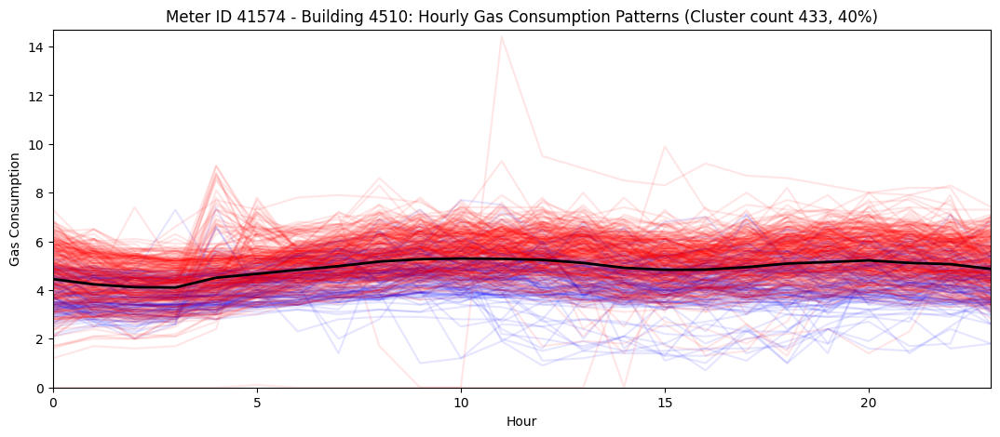

In [14]:
cluster_groups = {}
optimal_k = [2,2,2,2,2,2,3,3]
for i, meter_id in enumerate(ids_and_descriptions):
    optimal_k_value = optimal_k[i]
    cluster_groups[meter_id] = analyze_and_plot_daily_meter_data_kmeans_optimalk(gas_data, meter_id, optimal_k_value)

In [118]:
cluster_groups


{4902: {0:             hour_0  hour_1  hour_2  hour_3  hour_4  hour_5  hour_6  hour_7  \
  date                                                                         
  2020-03-25    30.0    26.0    21.0    24.0    25.0    27.0    22.0    22.0   
  2020-03-28    25.0    20.0    21.0    22.0    23.0    22.0    24.0    21.0   
  2020-04-05    24.0    29.0    25.0    22.0    28.0    27.0    24.0    29.0   
  2020-04-06    14.0    12.0    14.0    31.0    16.0    25.0    28.0    22.0   
  2020-04-07    16.0    26.0    21.0    18.0    27.0    21.0    24.0    26.0   
  ...            ...     ...     ...     ...     ...     ...     ...     ...   
  2022-11-23    30.0    24.0    21.0    23.0    17.0    23.0    21.0    24.0   
  2022-12-24    22.0    29.0    24.0    25.0    28.0    26.0    30.0    23.0   
  2022-12-25    21.0    26.0    22.0    26.0    25.0    21.0    28.0    21.0   
  2022-12-26    22.0    22.0    27.0    23.0    28.0    21.0    28.0    21.0   
  2022-12-31    23.0    22.0   

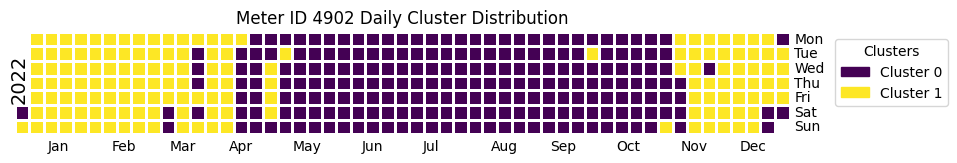

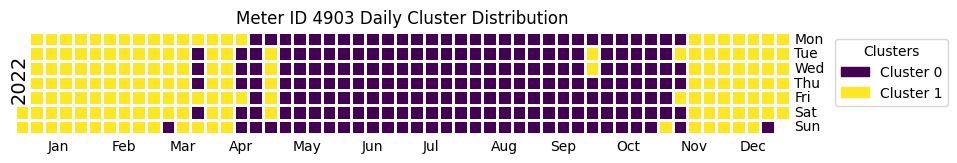

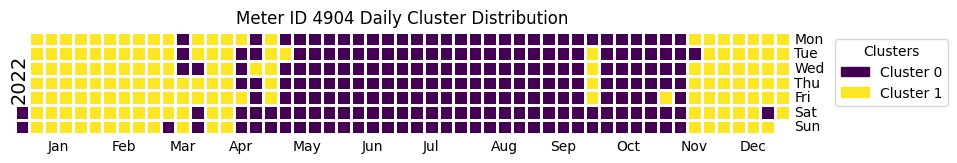

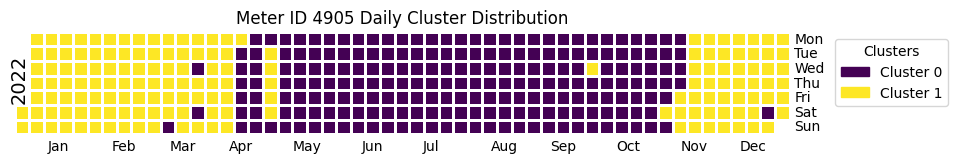

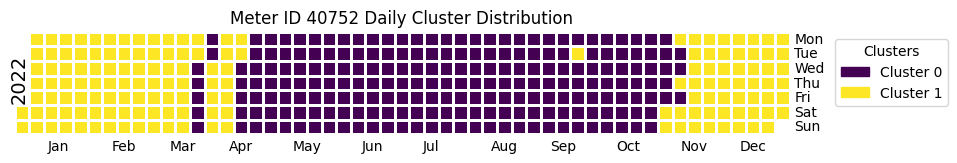

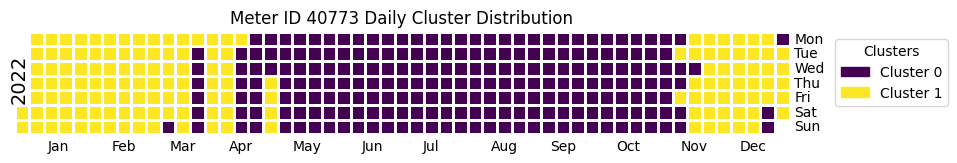

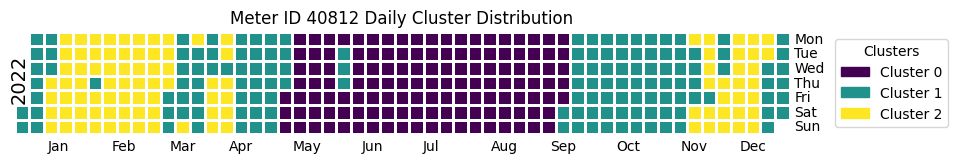

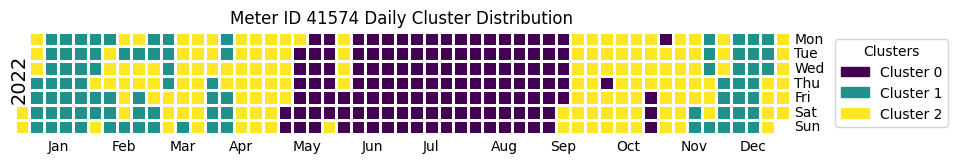

In [188]:
import matplotlib.pyplot as plt
import calmap
from matplotlib.patches import Patch

def plot_calendar_heatmap(cluster_groups):
    # iterate over each cluster group for each meter ID
    for meter_id, cluster_groups in cluster_groups.items():
        # Get a list of cluster labels for each day
        cluster_labels_daily = {}
        for i, cluster_group in cluster_groups.items():
            # Get the dates for this cluster
            dates = cluster_group.index
            # For each date in this cluster, assign it the current cluster label
            for date in dates:
                cluster_labels_daily[date] = i

        # Create a pandas Series from cluster labels
        cluster_labels_series = pd.Series(cluster_labels_daily, index=pd.to_datetime(list(cluster_labels_daily.keys())))

        # Filter to only include dates from 2022
        cluster_labels_series = cluster_labels_series[cluster_labels_series.index.year == 2022]

        # Create calendar heatmap
        fig, ax = plt.subplots(figsize=(10, 8))
        calmap.yearplot(cluster_labels_series, year=2022, how=None, ax=ax, cmap='viridis')
        ax.set_title(f'Meter ID {meter_id} Daily Cluster Distribution')

        # Manually add a year label
        fig.text(0.13, 0.5, '2022', ha='center', va='center', rotation='vertical', fontsize=14)


        # Create legend
        unique_clusters = cluster_labels_series.unique()
        cmap = plt.cm.get_cmap('viridis', len(unique_clusters))
        legend_patches = [Patch(color=cmap(i / len(unique_clusters)), label=f'Cluster {cluster}') for i, cluster in enumerate(sorted(unique_clusters))]
        legend = ax.legend(handles=legend_patches, title='Clusters', bbox_to_anchor=(1.05, 1), loc='upper left')

        plt.savefig(f"Meter_ID_{meter_id}_Daily_Cluster_Distribution.png", bbox_inches='tight', bbox_extra_artists=(legend,))
        plt.savefig(f"C:\\Users\\qwero\\OneDrive - Delft University of Technology\\Desktop\\Master Thisis\\single-building-calander\\Meter_ID_{meter_id}_Daily_Cluster_Distribution.png", bbox_inches='tight', bbox_extra_artists=(legend,))

        plt.show()

plot_calendar_heatmap(cluster_groups)


In [180]:
latex_code = r"""

"""
# ax.set_title(f"Meter ID {meter_id} - Building {building_number}: Typical Gas Usage Profiles 
figure_counter = 0
for meter_id, description in ids_and_descriptions.items():

    image_path = f"figs/calander/Meter_ID_{meter_id}_Daily_Cluster_Distribution.png"
    caption = f"Building {description} Meter ID {meter_id} Daily Cluster Distribution"
    label = f"fig:Meter_ID_{meter_id}_cal"
        
    if figure_counter % 4 == 0:
        if figure_counter > 0:
            latex_code += r"\end{figure}"  # Close the previous figure environment
        latex_code += r"\clearpage"  # Start a new page every four subfigures
        latex_code += r"\begin{figure}[p]"  # Open a new figure environment

    latex_code += rf"""
\begin{{subfigure}}{{\textwidth}}
    \centering
    \includegraphics[width=\linewidth]{{{image_path}}}
    \caption{{{caption}}}
    \label{{{label}}}
\end{{subfigure}}
"""
        
    if figure_counter % 4 == 3:
        latex_code += r"\end{figure}"  # Close the current figure environment

    figure_counter += 1

# Close the figure environment if there are remaining subfigures
if figure_counter % 4 != 0:
    latex_code += r"\end{figure}"

latex_code += r"""

"""

# # Save the generated LaTeX code to a .tex file
# with open("building_clustering_results.tex", "w") as f:
#     f.write(latex_code)
print(latex_code)



\clearpage\begin{figure}[p]
\begin{subfigure}{\textwidth}
    \centering
    \includegraphics[width=\linewidth]{figs/calander/Meter_ID_4902_Daily_Cluster_Distribution.png}
    \caption{Building 4531g0b Uilenstede 5-61 (Toren 1) Meter ID 4902 Daily Cluster Distribution}
    \label{fig:Meter_ID_4902_cal}
\end{subfigure}

\begin{subfigure}{\textwidth}
    \centering
    \includegraphics[width=\linewidth]{figs/calander/Meter_ID_4903_Daily_Cluster_Distribution.png}
    \caption{Building 4534g0b Uilenstede 155-211 (Toren 2) Meter ID 4903 Daily Cluster Distribution}
    \label{fig:Meter_ID_4903_cal}
\end{subfigure}

\begin{subfigure}{\textwidth}
    \centering
    \includegraphics[width=\linewidth]{figs/calander/Meter_ID_4904_Daily_Cluster_Distribution.png}
    \caption{Building 4535g0b Uilenstede 405-461 (Toren 3) Meter ID 4904 Daily Cluster Distribution}
    \label{fig:Meter_ID_4904_cal}
\end{subfigure}

\begin{subfigure}{\textwidth}
    \centering
    \includegraphics[width=\linewidth]{f

In [179]:
latex_code = r"""
\begin{figure}[p]  % Open a new figure environment
"""

subfigure_counter = 0  # Counter for subfigures

for meter_id, description in ids_and_descriptions.items():

    image_path = f"figs/calander/Meter_ID_{meter_id}_Daily_Cluster_Distribution.png"
    caption = f"Building {description} Meter ID {meter_id} Daily Cluster Distribution"
    label = f"fig:Meter_ID_{meter_id}_cal"

    latex_code += r"\begin{subfigure}{\textwidth}" + "\n"
    latex_code += rf"""
\centering
\includegraphics[width=0.8\linewidth]{{{image_path}}}
\caption{{{caption}}}
\label{{{label}}}
"""
    latex_code += r"\end{subfigure}" + "\n"

    subfigure_counter += 1

    # Insert page break every fourth subfigure or when reaching the last subfigure
    if subfigure_counter % 4 == 0 or subfigure_counter == len(ids_and_descriptions) * 2:
        latex_code += r"\clearpage" + "\n"

latex_code += r"""
\caption{Caption for the whole figure.}  % Add caption for the whole figure
\label{fig:whole_figure}  % Add label for the whole figure
\end{figure}  % Close the figure environment
"""

# Save the generated LaTeX code to a .tex file
with open("building_clustering_results.tex", "w") as f:
    f.write(latex_code)

print(latex_code)



\begin{figure}[p]  % Open a new figure environment
\begin{subfigure}{\textwidth}

\centering
\includegraphics[width=0.8\linewidth]{figs/calander/Meter_ID_4902_Daily_Cluster_Distribution.png}
\caption{Building 4531g0b Uilenstede 5-61 (Toren 1) Meter ID 4902 Daily Cluster Distribution}
\label{fig:Meter_ID_4902_cal}
\end{subfigure}
\begin{subfigure}{\textwidth}

\centering
\includegraphics[width=0.8\linewidth]{figs/calander/Meter_ID_4903_Daily_Cluster_Distribution.png}
\caption{Building 4534g0b Uilenstede 155-211 (Toren 2) Meter ID 4903 Daily Cluster Distribution}
\label{fig:Meter_ID_4903_cal}
\end{subfigure}
\begin{subfigure}{\textwidth}

\centering
\includegraphics[width=0.8\linewidth]{figs/calander/Meter_ID_4904_Daily_Cluster_Distribution.png}
\caption{Building 4535g0b Uilenstede 405-461 (Toren 3) Meter ID 4904 Daily Cluster Distribution}
\label{fig:Meter_ID_4904_cal}
\end{subfigure}
\begin{subfigure}{\textwidth}

\centering
\includegraphics[width=0.8\linewidth]{figs/calander/Meter_ID

In [166]:
latex_code = r"""
\begin{figure}[p]  % Open a new figure environment
"""

subfigure_counter = 0  # Counter for subfigures

for meter_id, description in ids_and_descriptions.items():
    for cluster_number in [0, 1]:
        image_path = f"figs/calander/Meter_ID_{meter_id}_Daily_Cluster_Distribution.png"
        caption = f"Building {description} Meter ID {meter_id} Daily Cluster Distribution"
        label = f"fig:Meter_ID {meter_id} Cluster {cluster_number}"
        
        # Start a new subfigure every fourth subfigure
        if subfigure_counter % 4 == 0:
            latex_code += r"\begin{subfigure}{\textwidth}" + "\n"
        
        latex_code += rf"""
    \centering
    \includegraphics[width=0.4\linewidth]{{{image_path}}}
    \caption{{{caption}}}
    \label{{{label}}}
"""
        
        subfigure_counter += 1
        
        # Close the subfigure every fourth subfigure or when reaching the last subfigure
        if subfigure_counter % 4 == 0 or subfigure_counter == len(ids_and_descriptions) * 2:
            latex_code += r"\end{subfigure}" + "\n"
            
            # Add a horizontal space between subfigures except for the last subfigure
            if subfigure_counter != len(ids_and_descriptions) * 2:
                latex_code += r"\hfill" + "\n"

latex_code += r"""
\caption{Caption for the whole figure.}  % Add caption for the whole figure
\label{fig:whole_figure}  % Add label for the whole figure
\end{figure}  % Close the figure environment
"""

# # Save the generated LaTeX code to a .tex file
# with open("building_clustering_results.tex", "w") as f:
#     f.write(latex_code)

print(latex_code)



\begin{figure}[p]  % Open a new figure environment
\begin{subfigure}{\textwidth}

    \centering
    \includegraphics[width=0.4\linewidth]{figs/calander/Meter_ID_4902_Daily_Cluster_Distribution.png}
    \caption{Building 4531g0b Uilenstede 5-61 (Toren 1) Meter ID 4902 Daily Cluster Distribution}
    \label{fig:Meter_ID 4902 Cluster 0}

    \centering
    \includegraphics[width=0.4\linewidth]{figs/calander/Meter_ID_4902_Daily_Cluster_Distribution.png}
    \caption{Building 4531g0b Uilenstede 5-61 (Toren 1) Meter ID 4902 Daily Cluster Distribution}
    \label{fig:Meter_ID 4902 Cluster 1}

    \centering
    \includegraphics[width=0.4\linewidth]{figs/calander/Meter_ID_4903_Daily_Cluster_Distribution.png}
    \caption{Building 4534g0b Uilenstede 155-211 (Toren 2) Meter ID 4903 Daily Cluster Distribution}
    \label{fig:Meter_ID 4903 Cluster 0}

    \centering
    \includegraphics[width=0.4\linewidth]{figs/calander/Meter_ID_4903_Daily_Cluster_Distribution.png}
    \caption{Building 4534g0b

## checking cluster results
In this code, we plot the average hourly gas consumption pattern for each cluster first. Then, we plot a few individual hourly gas consumption patterns from each cluster. This allows us to see if there are any common patterns among the individual hourly gas consumption patterns that correspond to the dip and peak moments in a 24-hour timeline. If there are, it suggests that the clustering algorithm is capturing some meaningful patterns in the data.

In [20]:
import matplotlib.pyplot as plt
import numpy as np

def plot_cluster_results(cluster_groups):
    # create an array with values from 0 to 23 representing hours
    x_axis_values = np.arange(24)

    # iterate over each cluster group for each meter ID
    for meter_id, cluster_groups in cluster_groups.items():
        building_number = id_and_building.get(meter_id, "Unknown")
        for i, cluster_group in cluster_groups.items():
            print(f'Meter ID {meter_id}: Cluster {i}: Count={len(cluster_group)}, Average={cluster_group.mean().mean()}')

            # plot the average hourly gas consumption pattern for this cluster
            fig, ax = plt.subplots(figsize=(13, 5))
            cluster_average = cluster_group.mean()
            ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')
            ax.set_xlabel("Hour")
            ax.set_ylabel("Gas Consumption")
            ax.set_title(f"Meter ID {meter_id} - Building {building_number}: Typical Gas Usage Profiles (Cluster {i}, Percentage: {len(cluster_group)/1096*100:.0f}%)")
            ax.set_xlim(0, 23)
            
            # Save the image to a specified location
#             plt.savefig(f"C:\\Users\\qwero\\OneDrive - Delft University of Technology\\Desktop\\Master Thisis\\single-building-clustering-result-average\\Meter_ID_{meter_id}_Cluster_{i}.png")
            plt.show()


Meter ID 4902: Cluster 0: Count=630, Average=13.75452380952381


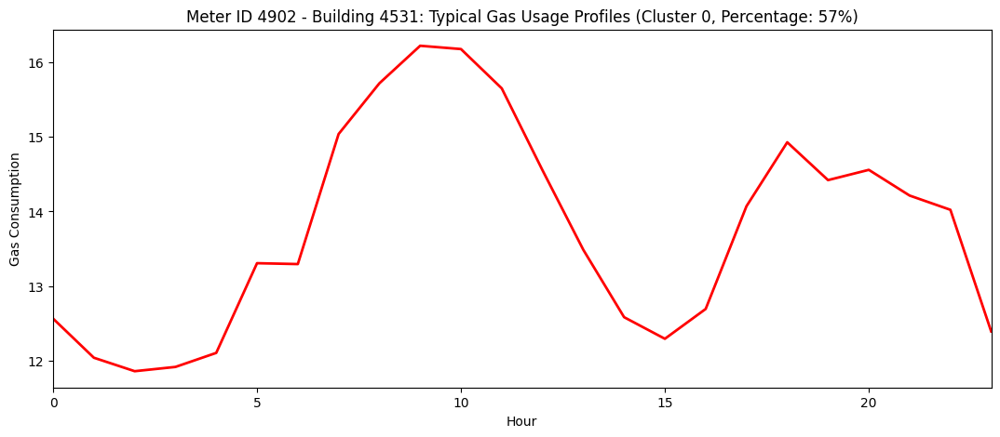

Meter ID 4902: Cluster 1: Count=466, Average=43.1413626609442


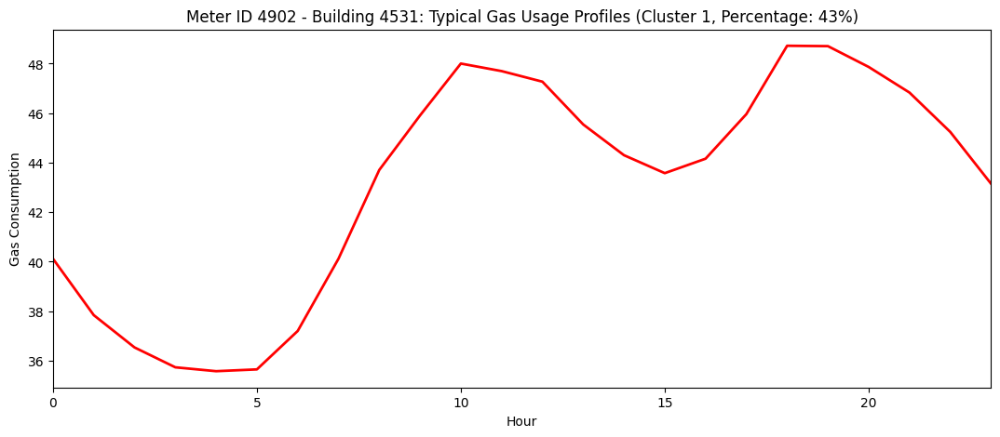

Meter ID 4903: Cluster 0: Count=585, Average=13.213960113960113


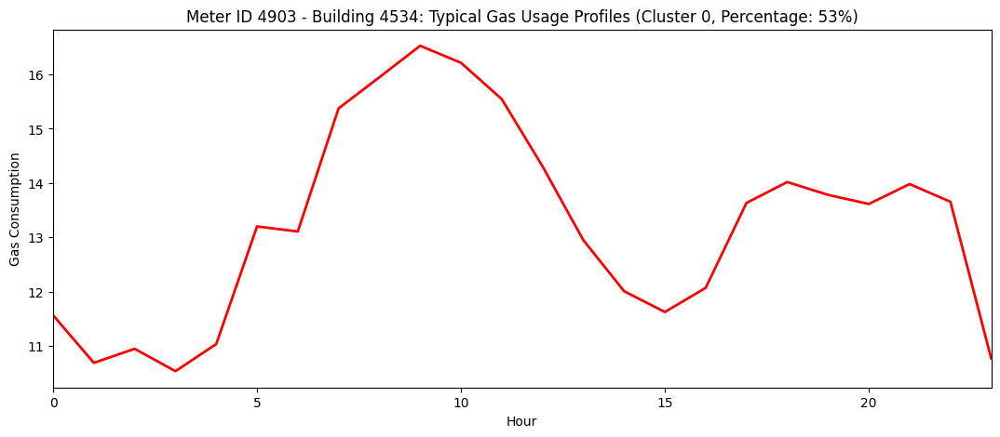

Meter ID 4903: Cluster 1: Count=511, Average=44.49722765818657


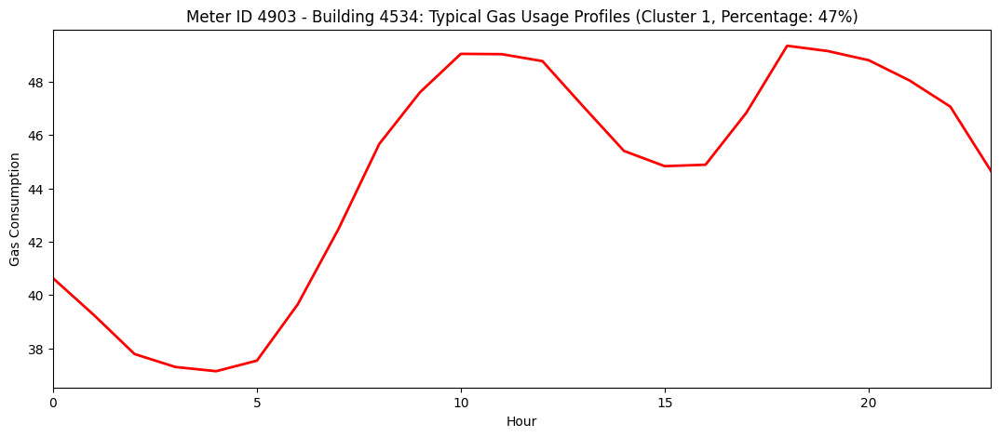

Meter ID 4904: Cluster 0: Count=578, Average=13.696366782006919


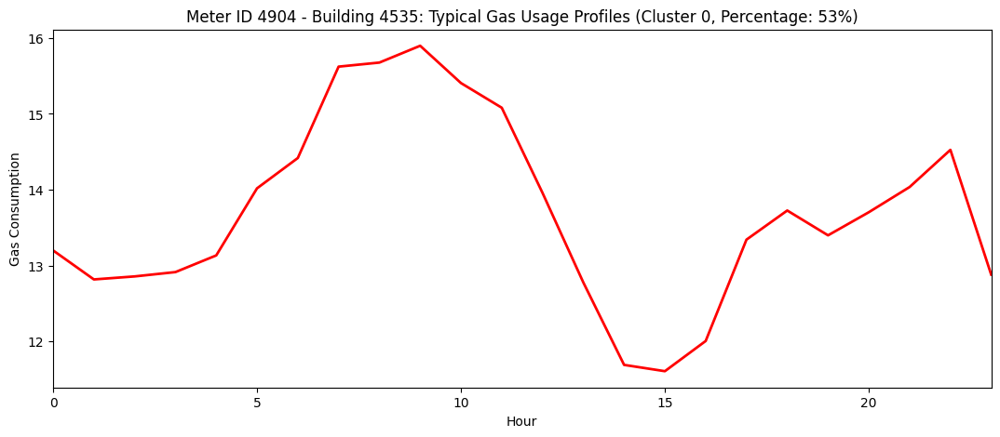

Meter ID 4904: Cluster 1: Count=518, Average=46.53603603603603


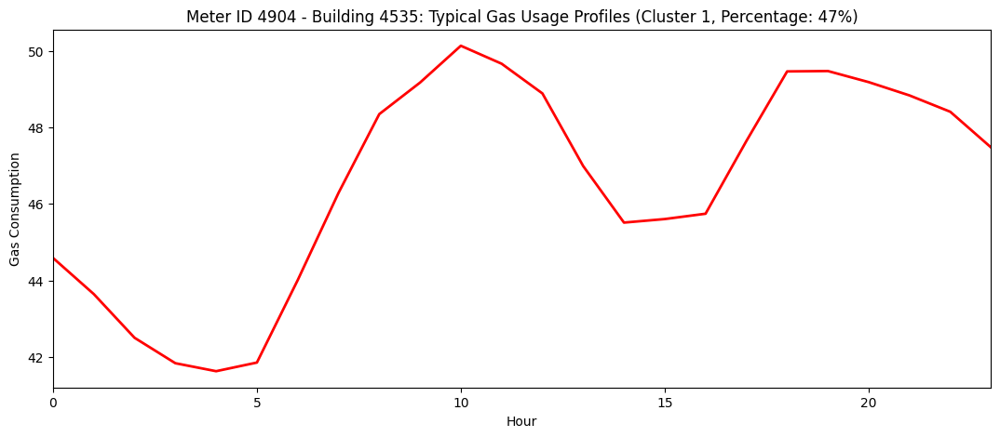

Meter ID 4905: Cluster 0: Count=577, Average=122.43796938186019


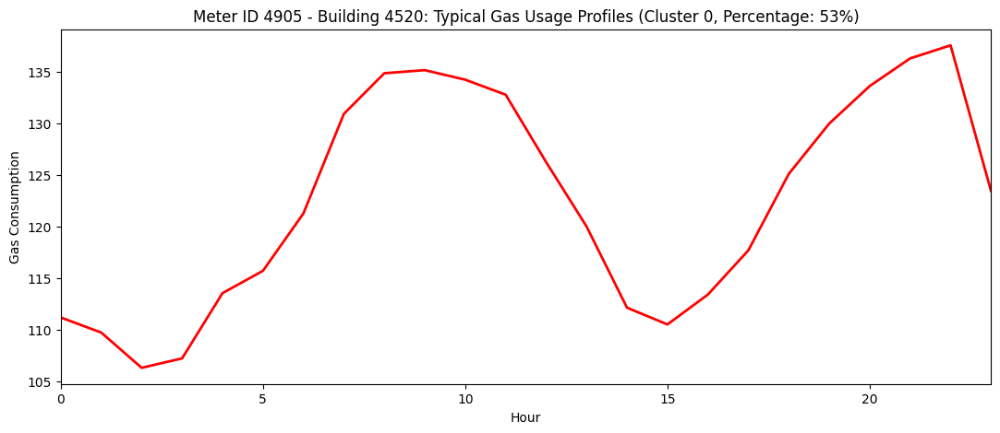

Meter ID 4905: Cluster 1: Count=519, Average=271.9316795118818


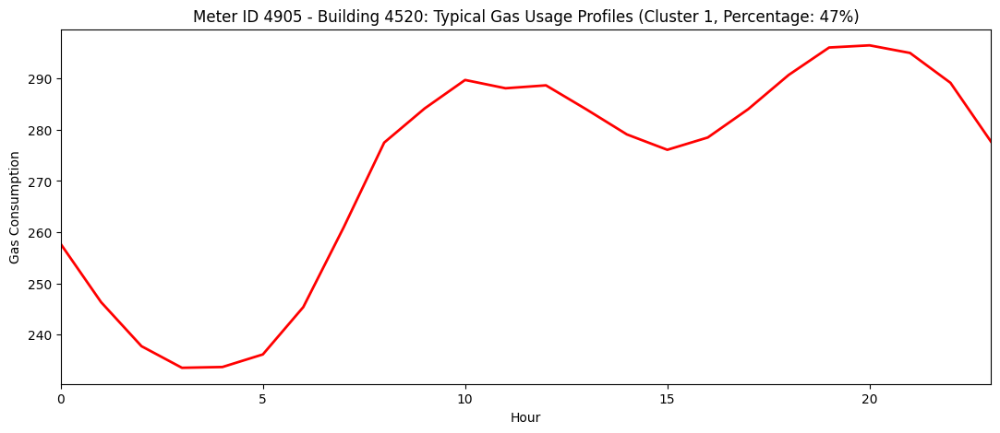

Meter ID 40752: Cluster 0: Count=571, Average=7.430399883245761


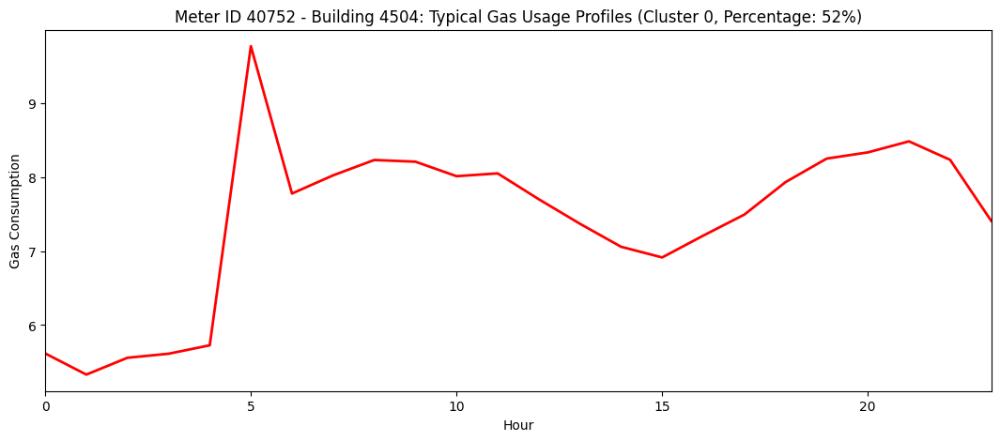

Meter ID 40752: Cluster 1: Count=525, Average=20.76919047619047


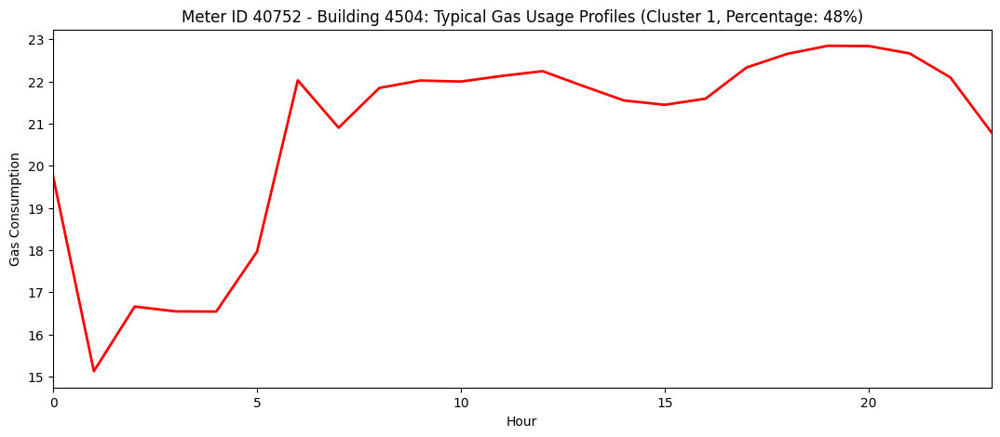

Meter ID 40773: Cluster 0: Count=583, Average=5.3588336192109765


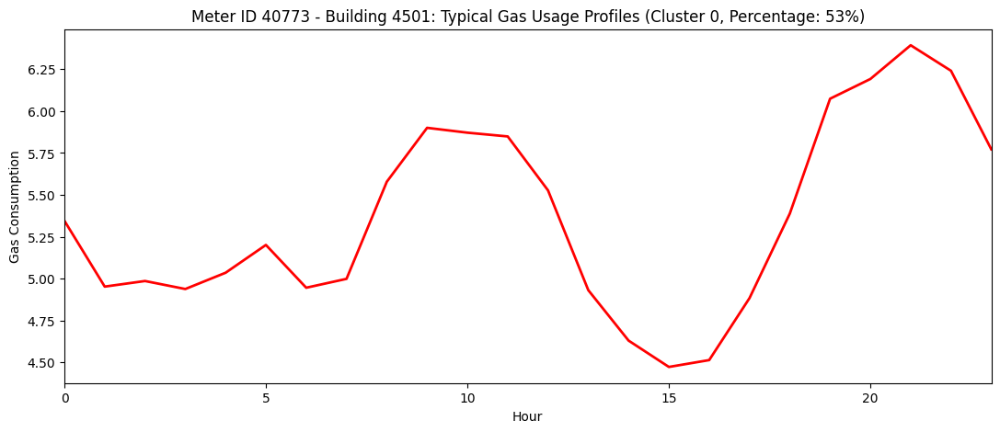

Meter ID 40773: Cluster 1: Count=513, Average=16.903525016244313


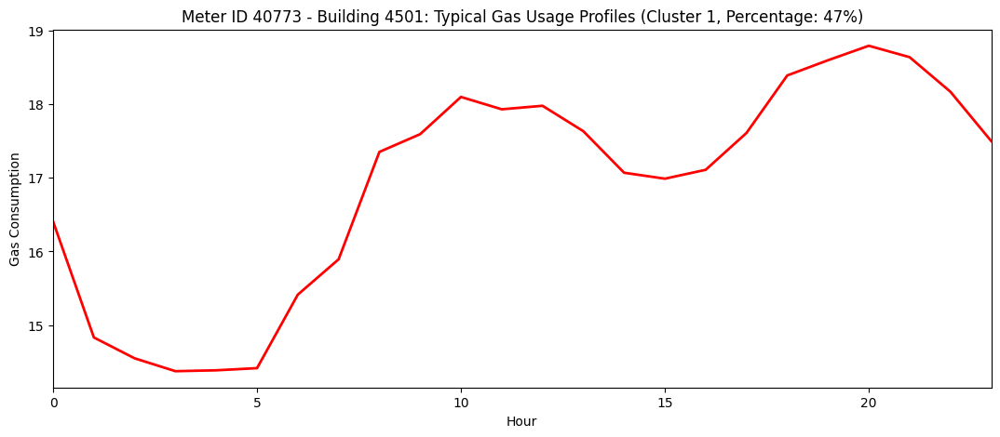

Meter ID 40812: Cluster 0: Count=334, Average=1.7961077844311377


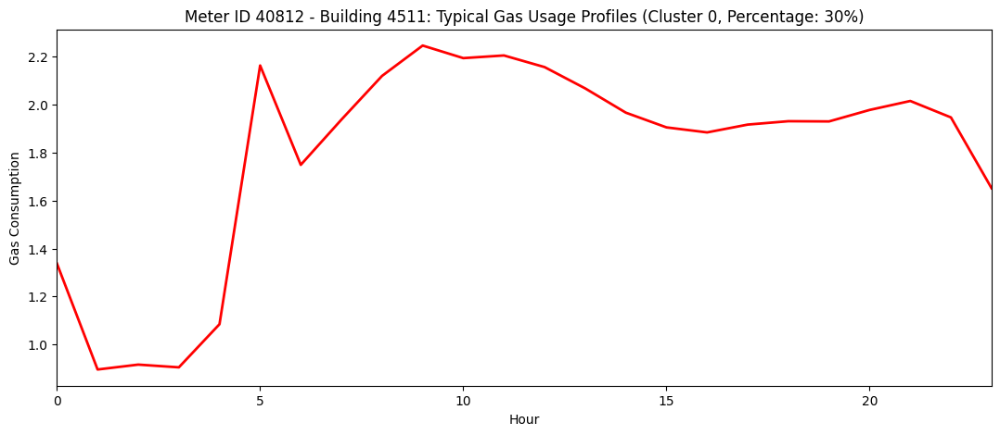

Meter ID 40812: Cluster 1: Count=412, Average=4.90956715210356


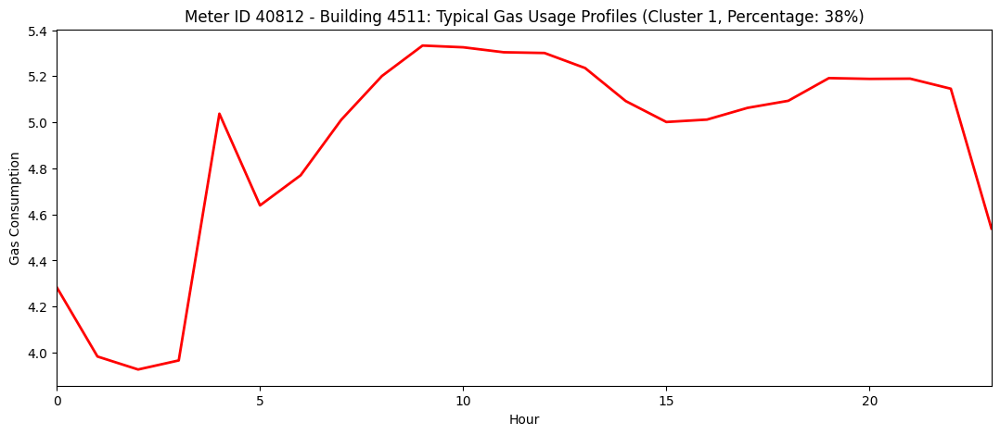

Meter ID 40812: Cluster 2: Count=350, Average=7.374083333333334


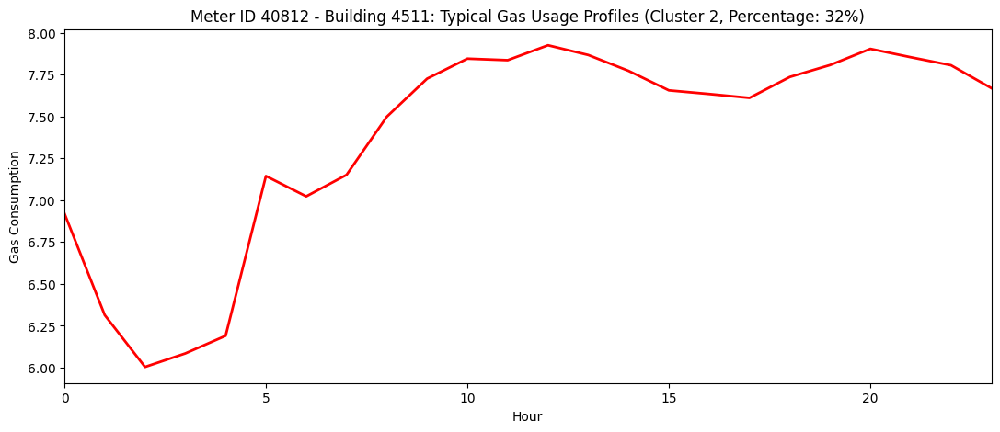

Meter ID 41574: Cluster 0: Count=356, Average=1.5351357677902626


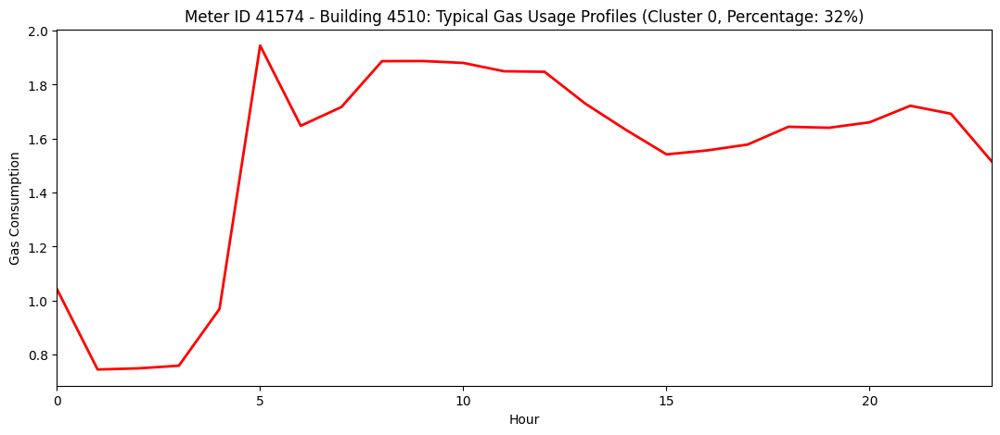

Meter ID 41574: Cluster 1: Count=307, Average=7.442833876221499


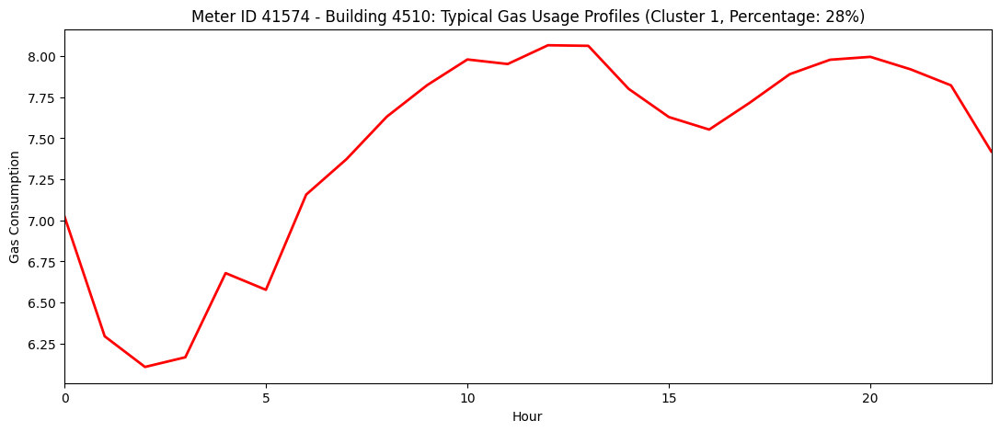

Meter ID 41574: Cluster 2: Count=433, Average=4.886537721324095


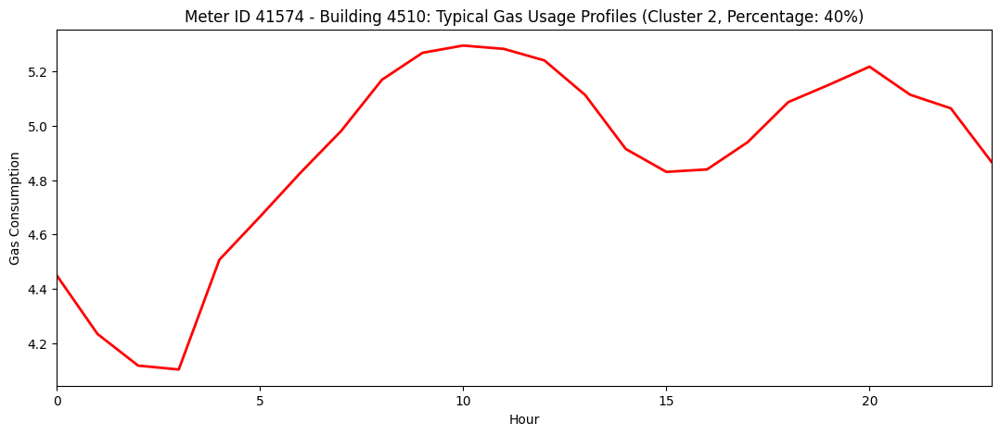

In [21]:
cluster_groups_result = cluster_groups.copy()
plot_cluster_results(cluster_groups_result)


In [13]:
cluster_groups

{4902: {0:               hour_0    hour_1    hour_2    hour_3    hour_4    hour_5  \
  date                                                                     
  2020-03-28  0.002922  0.002338  0.002455  0.002572  0.002688  0.002572   
  2020-04-05  0.002805  0.003390  0.002922  0.002572  0.003273  0.003156   
  2020-04-06  0.001636  0.001403  0.001636  0.003624  0.001870  0.002922   
  2020-04-07  0.001870  0.003039  0.002455  0.002104  0.003156  0.002455   
  2020-04-08  0.001403  0.001870  0.002338  0.002805  0.002455  0.001987   
  ...              ...       ...       ...       ...       ...       ...   
  2022-11-23  0.003507  0.002805  0.002455  0.002688  0.001987  0.002688   
  2022-12-24  0.002572  0.003390  0.002805  0.002922  0.003273  0.003039   
  2022-12-25  0.002455  0.003039  0.002572  0.003039  0.002922  0.002455   
  2022-12-26  0.002572  0.002572  0.003156  0.002688  0.003273  0.002455   
  2022-12-31  0.002688  0.002572  0.003273  0.002572  0.002922  0.002922   
  


In [22]:
import matplotlib.pyplot as plt
import numpy as np
import math

def plot_cluster_results_color(cluster_groups, optimal_k):
    # create an array with values from 0 to 23 representing hours
    x_axis_values = np.arange(24)

    # calculate the maximum number of clusters among all meter ids
    max_clusters = max(optimal_k)
    
    # iterate over each cluster group for each meter ID
    meter_ids = list(cluster_groups.keys())
    
    for j, meter_id in enumerate(meter_ids):
        cluster_groups_meter = cluster_groups[meter_id]
        n_clusters = optimal_k[j]
        
        fig, axs = plt.subplots(1, n_clusters, figsize=(n_clusters*5, 4))
        
        # Find the global maximum and minimum gas consumption values across all clusters
        global_max = max(cluster_group.max().max() for cluster_group in cluster_groups_meter.values())
        global_min = min(cluster_group.min().min() for cluster_group in cluster_groups_meter.values())

        for i, cluster_group in enumerate(cluster_groups_meter.values()):
#             print(f'Meter ID {meter_id}: Cluster {i}: Count={len(cluster_group)}, Average={cluster_group.mean().mean()}')
            
            # Create a boolean mask for the heating months (October to April)
            heating_months = (pd.to_datetime(cluster_group.index).month >= 10) | (pd.to_datetime(cluster_group.index).month <= 4)
            
            j = 0
            # choose an ax based on the current cluster
            ax = axs[i] if n_clusters > 1 else axs
            
            for index, row in cluster_group.iterrows():
                # Get the color based on the heating months mask
                color = 'red' if heating_months[j] else 'blue'
                j += 1
                ax.plot(x_axis_values, row.values, color=color, alpha=0.1, label=None)

            cluster_average = cluster_group.mean()
            ax.plot(x_axis_values, cluster_average, color='black', linewidth=2, label='Average')

            ax.set_xlabel("Hour")
            ax.set_ylabel("Gas Consumption")
            ax.set_title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns ({len(cluster_group)/1096*100:.0f}%)")

            # Set the y-axis limits to the global maximum and minimum values
            ax.set_ylim(global_min, global_max)
            ax.set_xlim(0, 23)

        plt.tight_layout()
        plt.show()


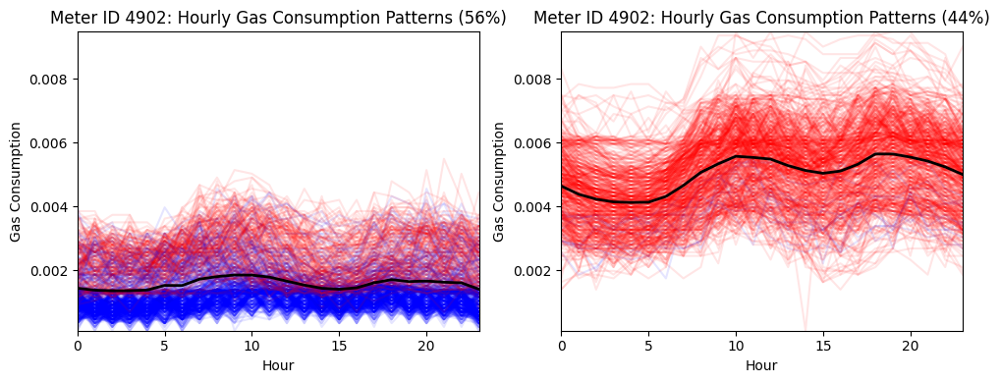

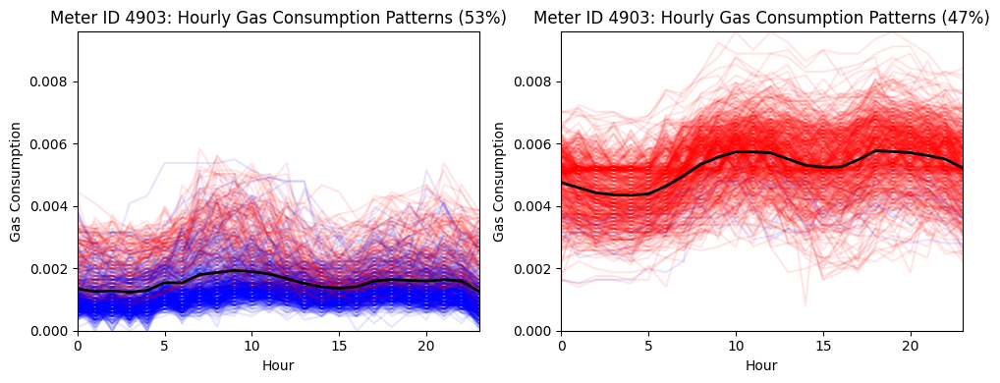

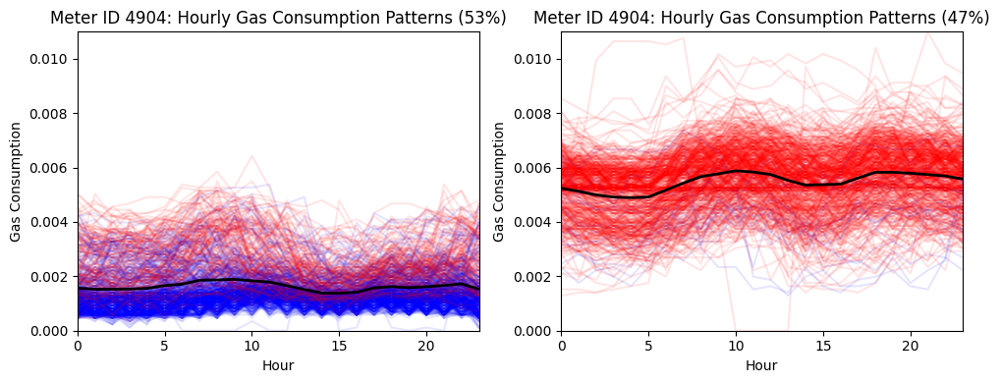

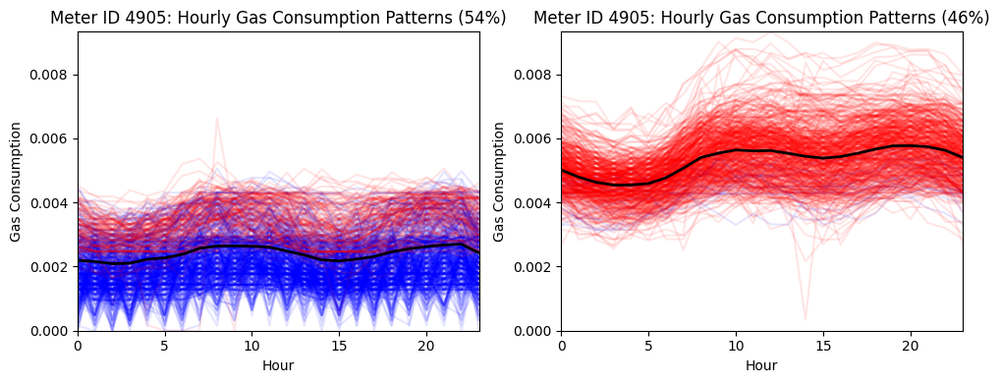

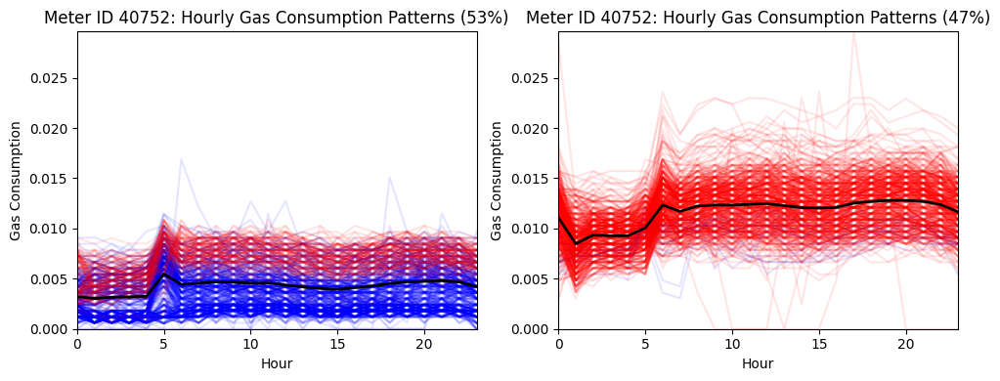

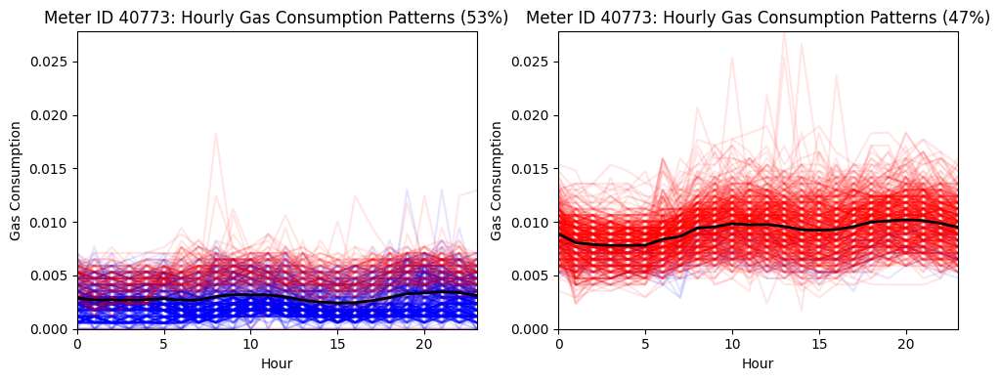

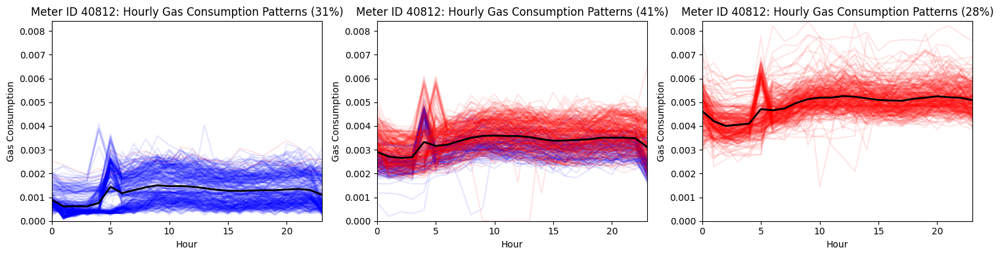

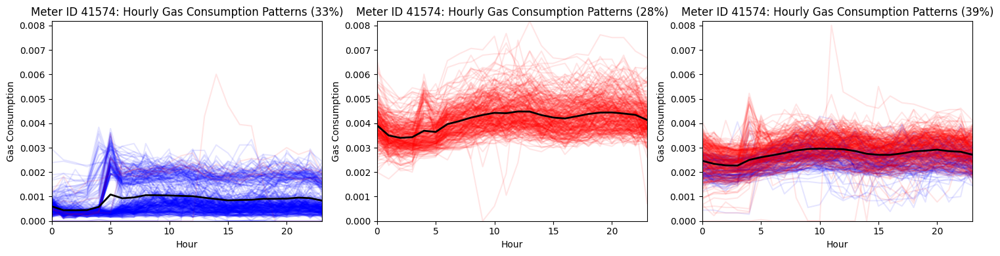

In [23]:
optimal_k = [2,2,2,2,2,2,3,3]
plot_cluster_results_color(cluster_groups, optimal_k)

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import math

def plot_cluster_results(cluster_groups, optimal_k):
    # create an array with values from 0 to 23 representing hours
    x_axis_values = np.arange(24)

    # calculate the maximum number of clusters among all meter ids
    max_clusters = max(optimal_k)

    # iterate over each cluster group for each meter ID
    meter_ids = list(cluster_groups.keys())
    for j, meter_id in enumerate(meter_ids):
        cluster_groups_meter = cluster_groups[meter_id]
        n_clusters = optimal_k[j]
        
        fig, axs = plt.subplots(1, n_clusters, figsize=(n_clusters*5, 4))

        for i, cluster_group in enumerate(cluster_groups_meter.values()):
            print(f'Meter ID {meter_id}: Cluster {i}: Count={len(cluster_group)}, Average={cluster_group.mean().mean()}')

            # plot the average hourly gas consumption pattern for this cluster
            cluster_average = cluster_group.mean()
            if n_clusters > 1:
                ax = axs[i]
            else:
                ax = axs
            ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')
            ax.set_xlabel("Hour")
            ax.set_ylabel("Gas Consumption")
            ax.set_title(f"Meter ID {meter_id}: Cluster {i}, Percentage: {len(cluster_group)/1096*100:.0f}%")
            ax.set_xlim(0, 23)
            ax.legend()
        # Save the image to a specified location
        plt.savefig(f"C:\\Users\\qwero\\OneDrive - Delft University of Technology\\Desktop\\Master Thisis\\single-building-clustering-result-average\\Meter_ID_{meter_id}_Cluster_total.png")
        plt.tight_layout()
        plt.show()


Meter ID 4902: Cluster 0: Count=630, Average=13.75452380952381
Meter ID 4902: Cluster 1: Count=466, Average=43.1413626609442


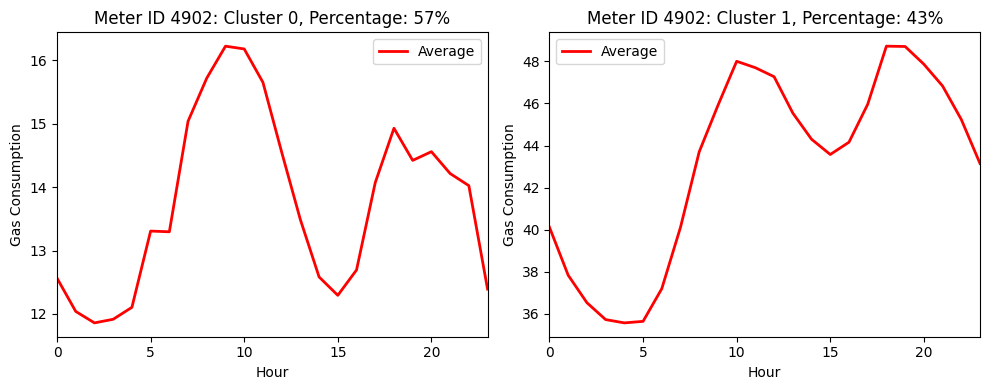

Meter ID 4903: Cluster 0: Count=585, Average=13.213960113960113
Meter ID 4903: Cluster 1: Count=511, Average=44.49722765818657


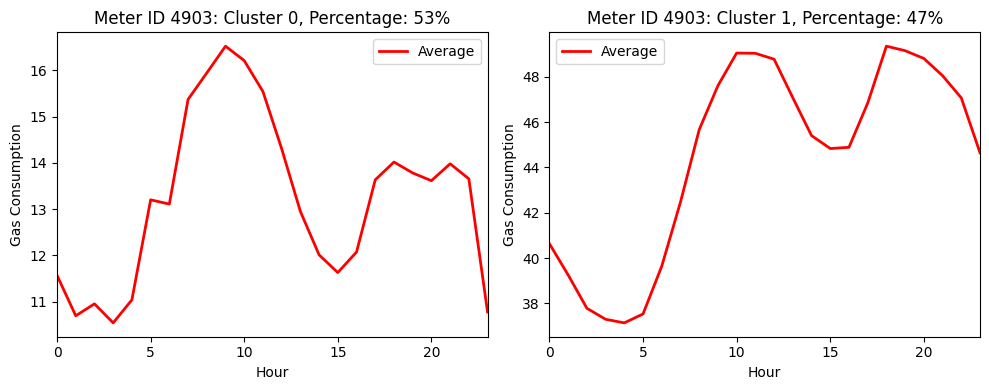

Meter ID 4904: Cluster 0: Count=578, Average=13.696366782006919
Meter ID 4904: Cluster 1: Count=518, Average=46.53603603603603


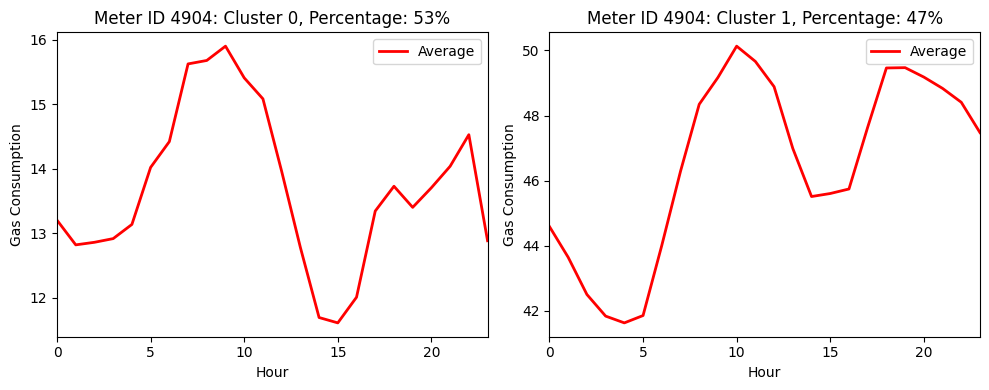

Meter ID 4905: Cluster 0: Count=577, Average=122.43796938186019
Meter ID 4905: Cluster 1: Count=519, Average=271.9316795118818


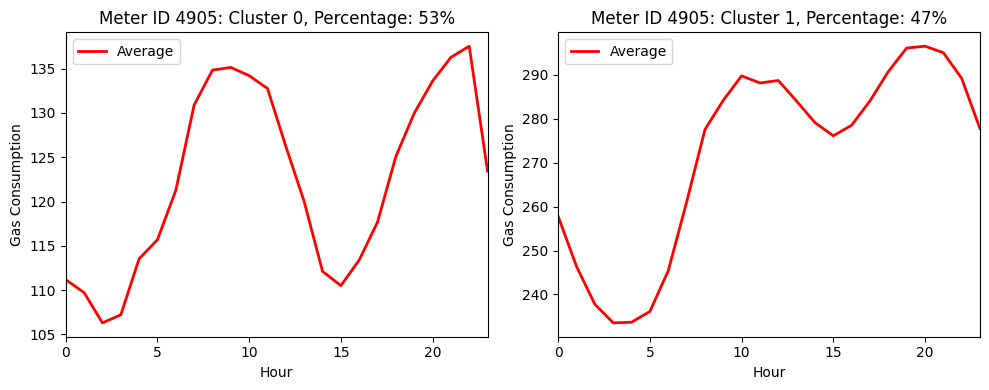

Meter ID 40752: Cluster 0: Count=571, Average=7.430399883245761
Meter ID 40752: Cluster 1: Count=525, Average=20.76919047619047


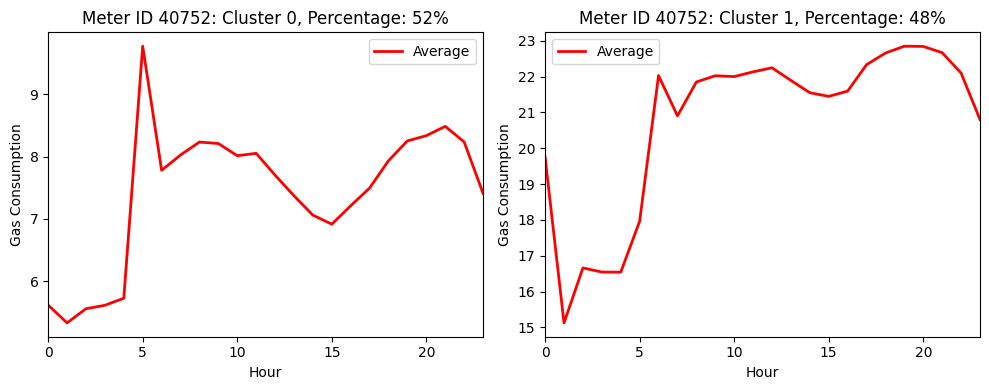

Meter ID 40773: Cluster 0: Count=583, Average=5.3588336192109765
Meter ID 40773: Cluster 1: Count=513, Average=16.903525016244313


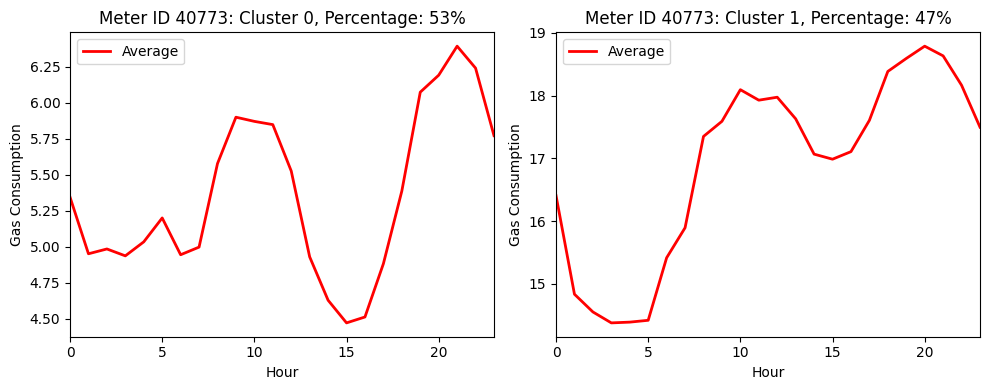

Meter ID 40812: Cluster 0: Count=334, Average=1.7961077844311377
Meter ID 40812: Cluster 1: Count=412, Average=4.90956715210356
Meter ID 40812: Cluster 2: Count=350, Average=7.374083333333334


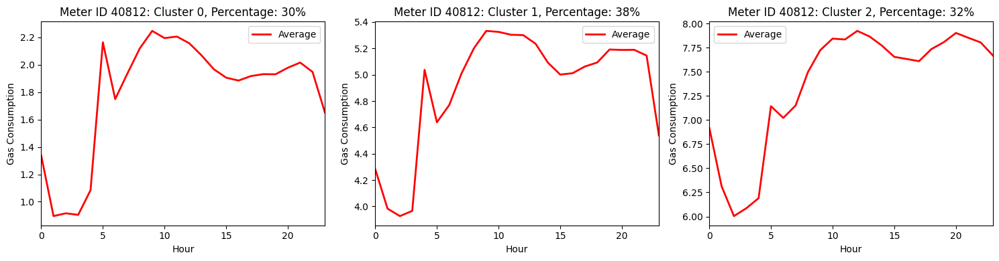

Meter ID 41574: Cluster 0: Count=356, Average=1.5351357677902626
Meter ID 41574: Cluster 1: Count=307, Average=7.442833876221499
Meter ID 41574: Cluster 2: Count=433, Average=4.886537721324095


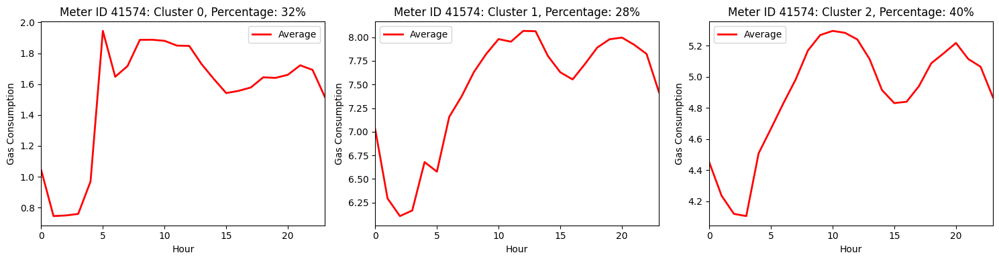

In [23]:
plot_cluster_results(cluster_groups, optimal_k)

In [90]:
def plot_dendrogram(gas_data, meter_id, n_clusters=None, label_skip=24):
    # Filter data by meter_id
    gas_data_filtered = gas_data[gas_data['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')

    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]

    # Compute the pairwise distances using the DTW metric
    n_rows = len(data_daily_unstacked)
    distances = np.zeros((n_rows, n_rows))
    for i in range(n_rows):
        for j in range(i+1, n_rows):
            dist = dtw(data_daily_unstacked.iloc[i].values, data_daily_unstacked.iloc[j].values)
            distances[i, j] = dist
            distances[j, i] = dist

    # Perform hierarchical clustering using the 'ward' method
    linkage_matrix = linkage(distances, method='ward')

    # Determine the optimal number of clusters based on the Silhouette score
    if n_clusters is None:
        max_clusters = 10
        silhouette_scores = []
        for n_clusters in range(2, max_clusters + 1):
            # Cut the dendrogram to obtain 'n_clusters' clusters
            cluster_labels = fcluster(linkage_matrix, n_clusters, criterion='maxclust')
            # Calculate the silhouette score
            score = silhouette_score(distances, cluster_labels, metric='precomputed')
            silhouette_scores.append(score)
    # Find the optimal number of clusters based on the highest silhouette score
    n_clusters = np.argmax(silhouette_scores) + 2
    print(f"Optimal number of clusters: {n_clusters} for Meter ID {meter_id}")
    # Plot the silhouette scores
    plt.plot(range(2, max_clusters + 1), silhouette_scores)
    plt.xlabel('Number of clusters')
    plt.ylabel('Silhouette Score')
    plt.title(f"Silhouette Scores Meter ID {meter_id} for Different Numbers of Clusters")

    plt.show()

    # Cut the dendrogram to obtain 'n_clusters' clusters
    cluster_labels = fcluster(linkage_matrix, n_clusters, criterion='maxclust')
    
    # Plot the dendrogram
    fig, ax = plt.subplots(figsize=(15, 5))
    labels = data_daily_unstacked.index[::label_skip]  # Only use every label_skip-th label
    dendrogram(linkage_matrix, truncate_mode='lastp', p=50, no_labels=True)
    ax.set_xlabel('Hourly consumption')
    ax.set_ylabel('Distance')
    ax.set_title(f"Meter ID {meter_id}: Hierarchical Clustering Dendrogram on Hourly Data")
    plt.show()
    
    return cluster_labels, linkage_matrix


c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 4902


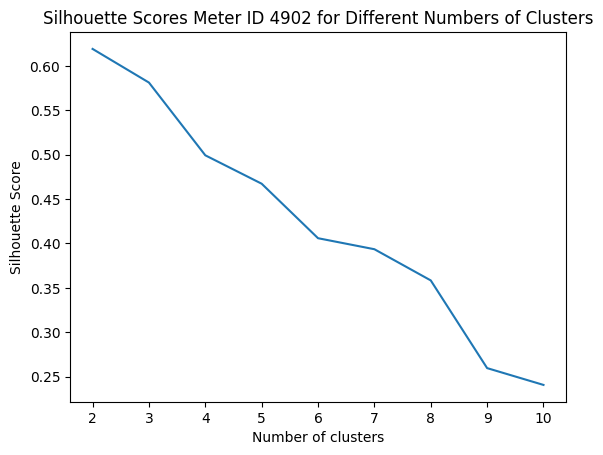

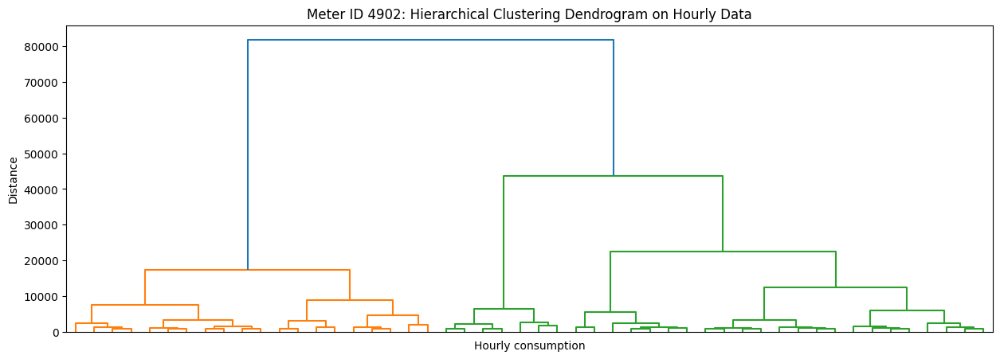

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 4903


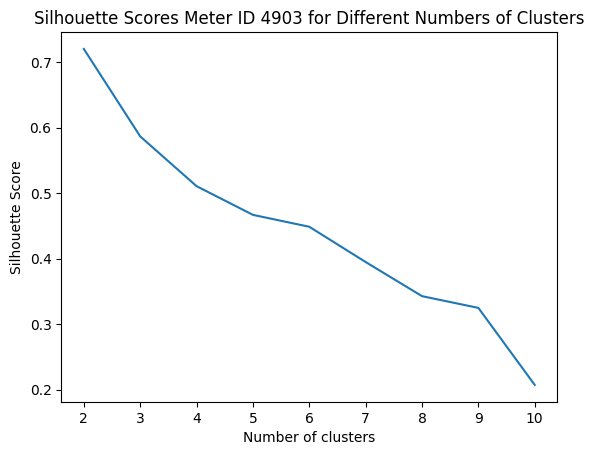

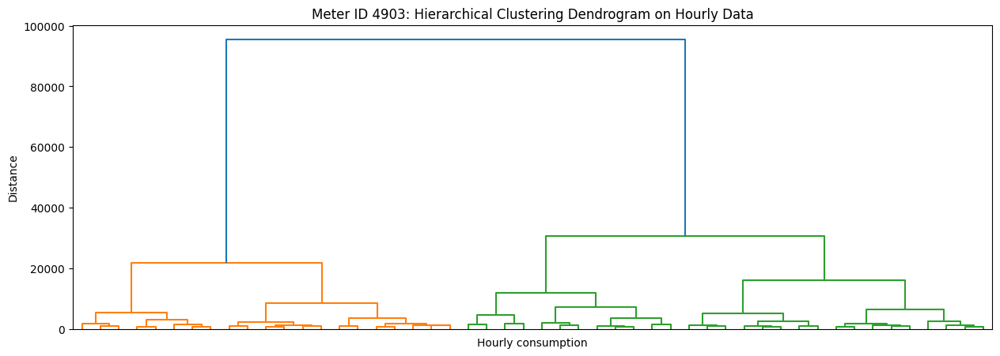

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 4904


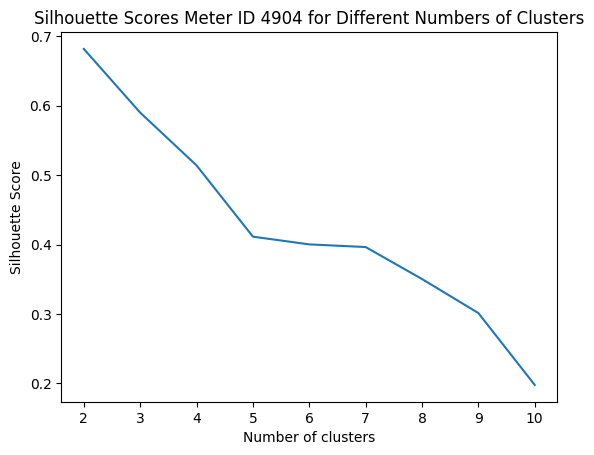

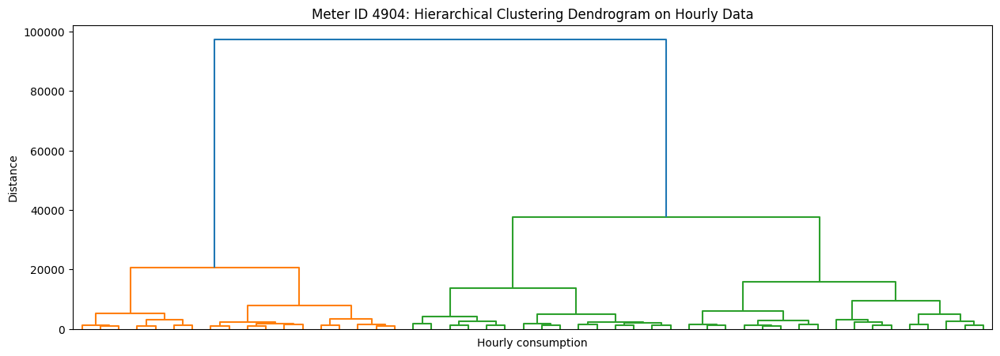

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 4905


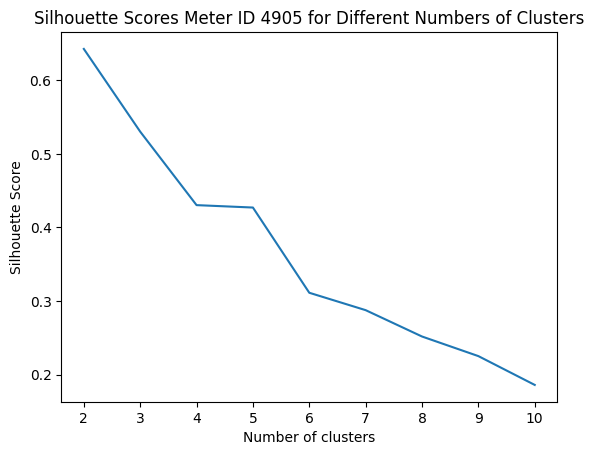

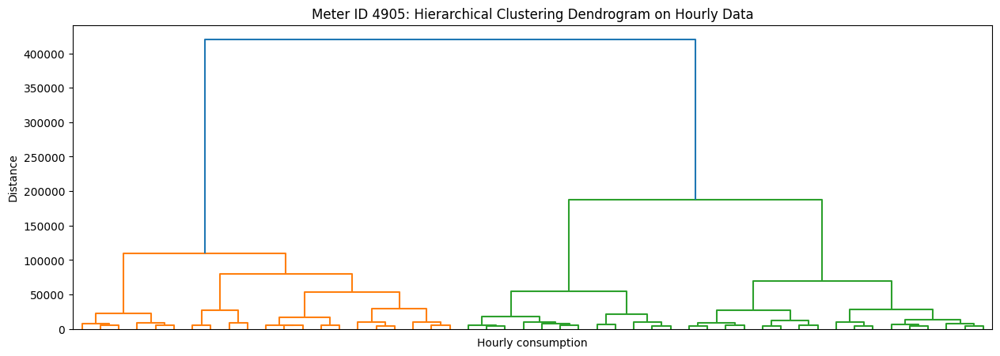

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 40752


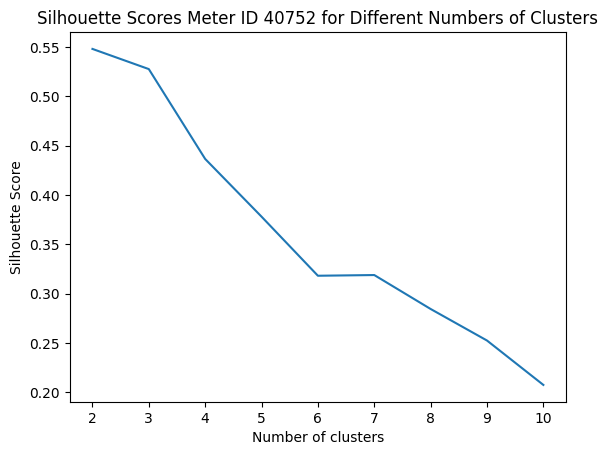

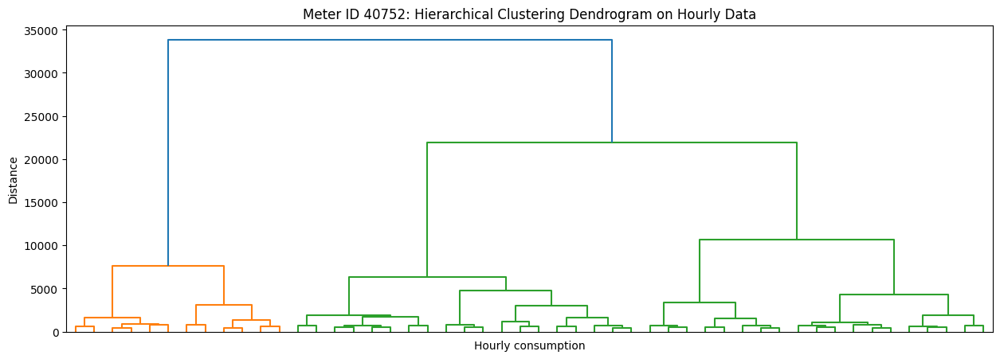

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 40773


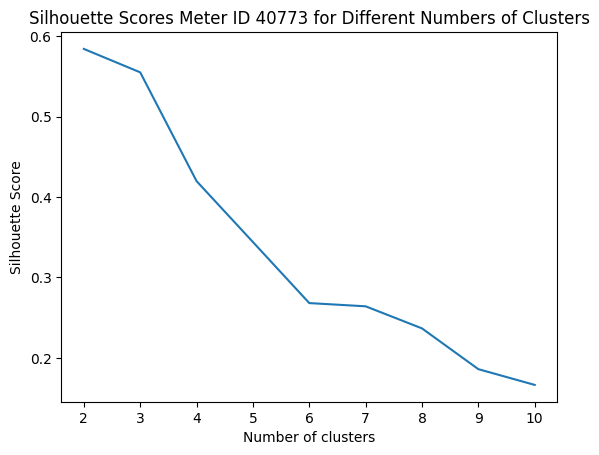

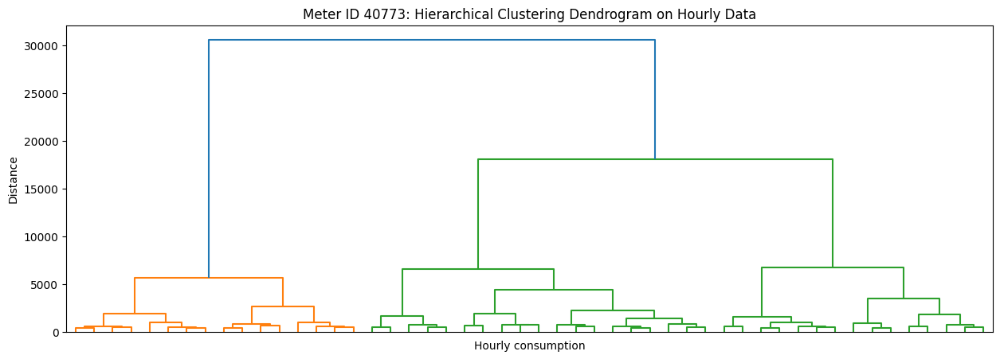

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 40812


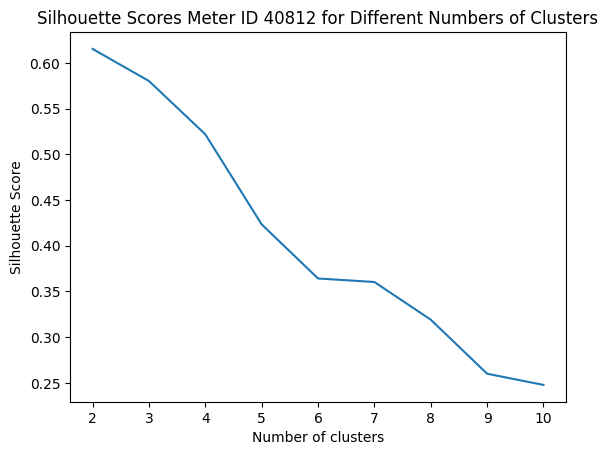

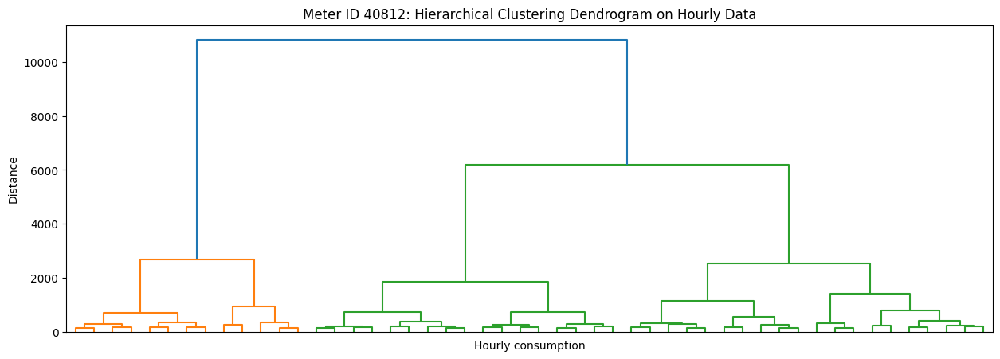

c:\robodk\python37\lib\site-packages\ipykernel_launcher.py:24: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix


Optimal number of clusters: 2 for Meter ID 41574


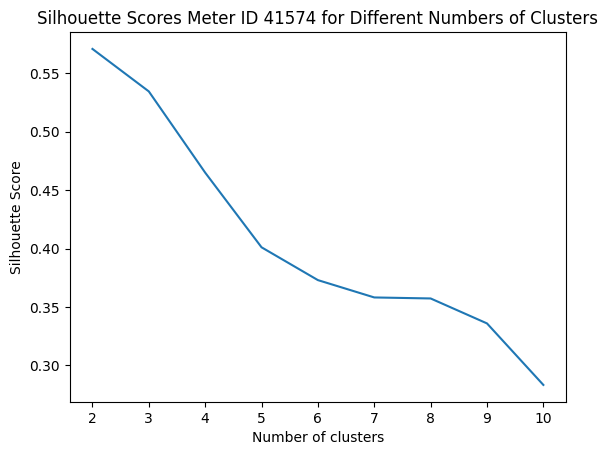

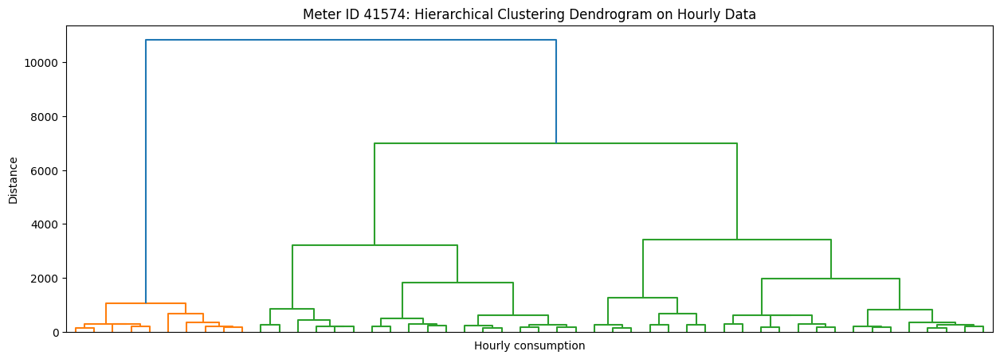

In [83]:
# create dictionary to store cluster labels and linkage matrices
cluster_dict = {}

# loop over meter IDs and plot dendrograms
for meter_id in ids_and_descriptions:
    cluster_labels, linkage_matrix = plot_dendrogram(gas_data, meter_id)
    cluster_dict[meter_id] = {'labels': cluster_labels, 'linkage_matrix': linkage_matrix}

In [91]:
import matplotlib.cm as cm

def plot_clustered_gas_consumption(gas_data, ids_and_descriptions, cluster_dict):
    # loop over meter IDs and plot gas consumption for each cluster
    for meter_id in ids_and_descriptions:
        # Filter data by meter_id
        gas_data_filtered = gas_data[gas_data['meter_id'] == meter_id]
        gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')

        # Preprocess data
        data = gas_data_pivot.copy()
        data.index = pd.to_datetime(data.index, utc=True)
        data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
        data_daily_grouped.index.names = ['date', 'hour']
        data_daily_unstacked = data_daily_grouped.unstack(level=-1)
        data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]

        # Add the 'cluster' column to the data_daily_unstacked DataFrame
        cluster_labels = cluster_dict[meter_id]['labels']
        data_daily_unstacked['cluster'] = cluster_labels

        # Determine the optimal number of clusters
        optimal_n_clusters = len(set(cluster_labels))

        # Define a colormap to assign a color to each cluster
        colormap = cm.get_cmap('viridis', optimal_n_clusters)

        # Plot the gas consumption for each cluster
        fig, ax = plt.subplots(figsize=(16, 7))

        for cluster in range(1, optimal_n_clusters + 1):
            data_clustered = data_daily_unstacked[data_daily_unstacked['cluster'] == cluster]
            if not data_clustered.empty:
                ax.plot(data_clustered.index, data_clustered.drop(columns='cluster'), label=f'Cluster {cluster}', color=colormap(cluster - 1))

        if ax.get_legend_handles_labels()[0]:
            ax.legend()
        ax.set_title(f'Meter ID {meter_id} clustering result')
        ax.set_xlabel('Date')
        ax.set_ylabel('Gas Consumption')
        plt.xticks(rotation=45, ha='right')
        plt.show()


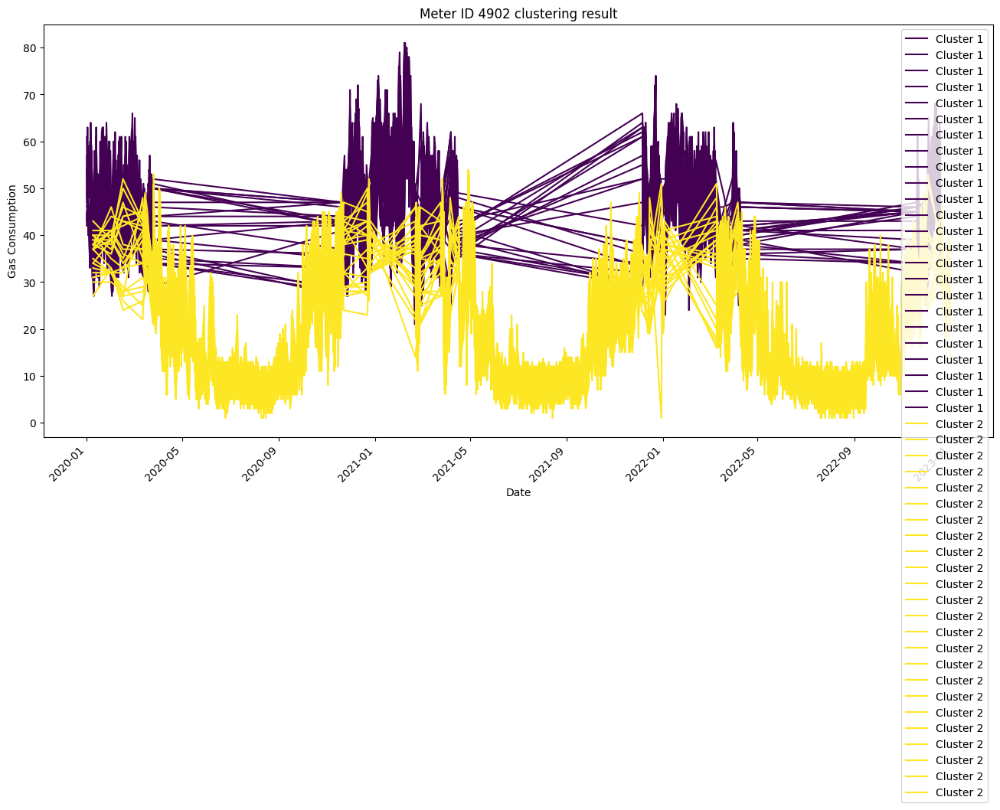

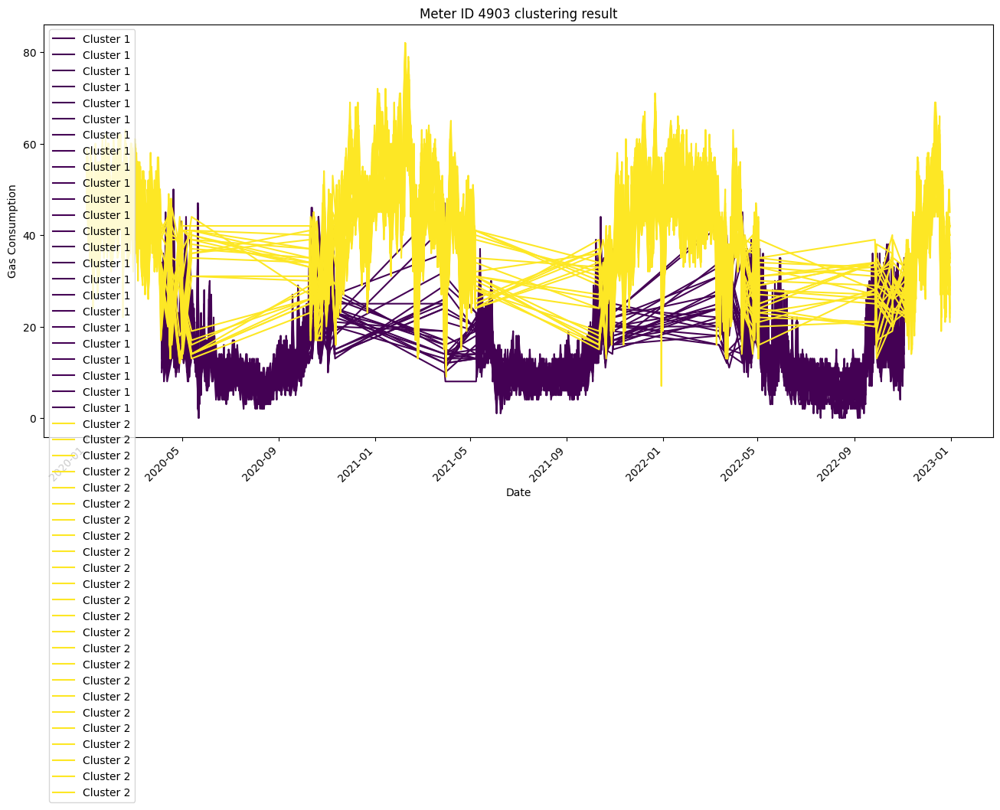

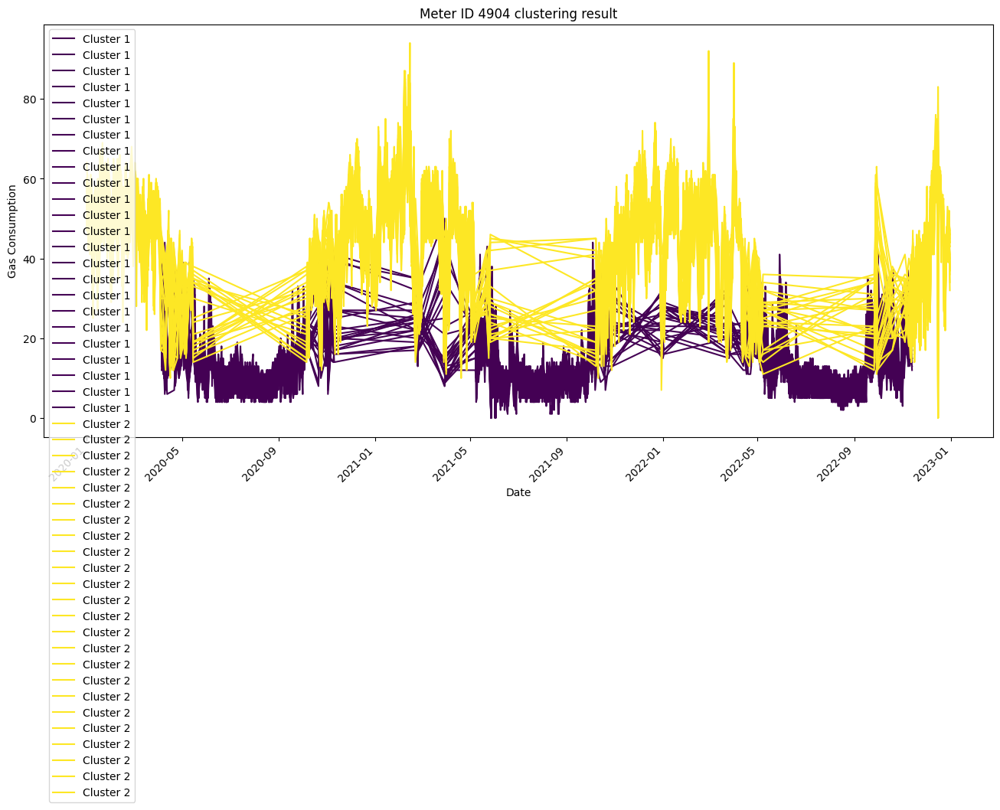

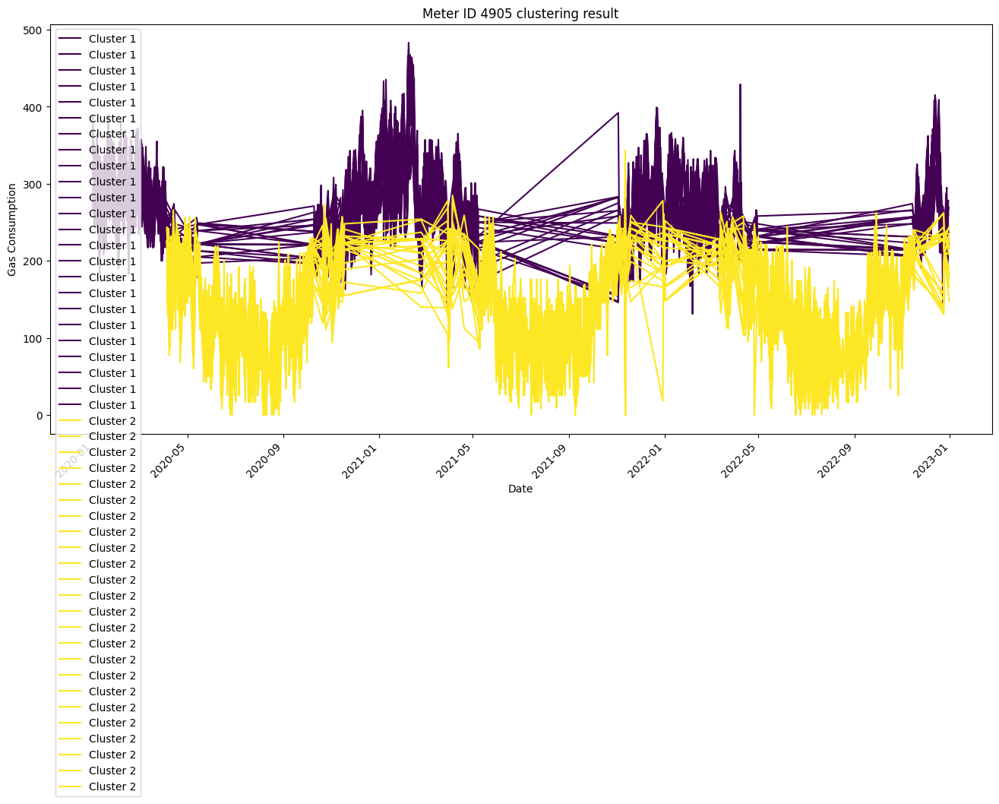

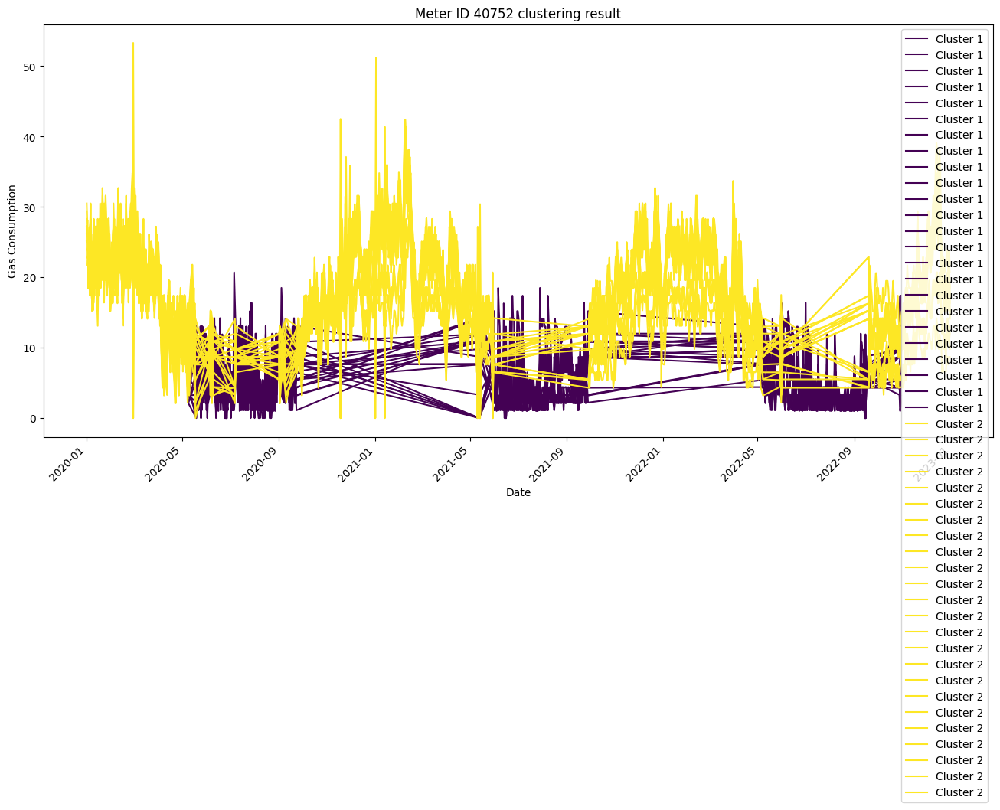

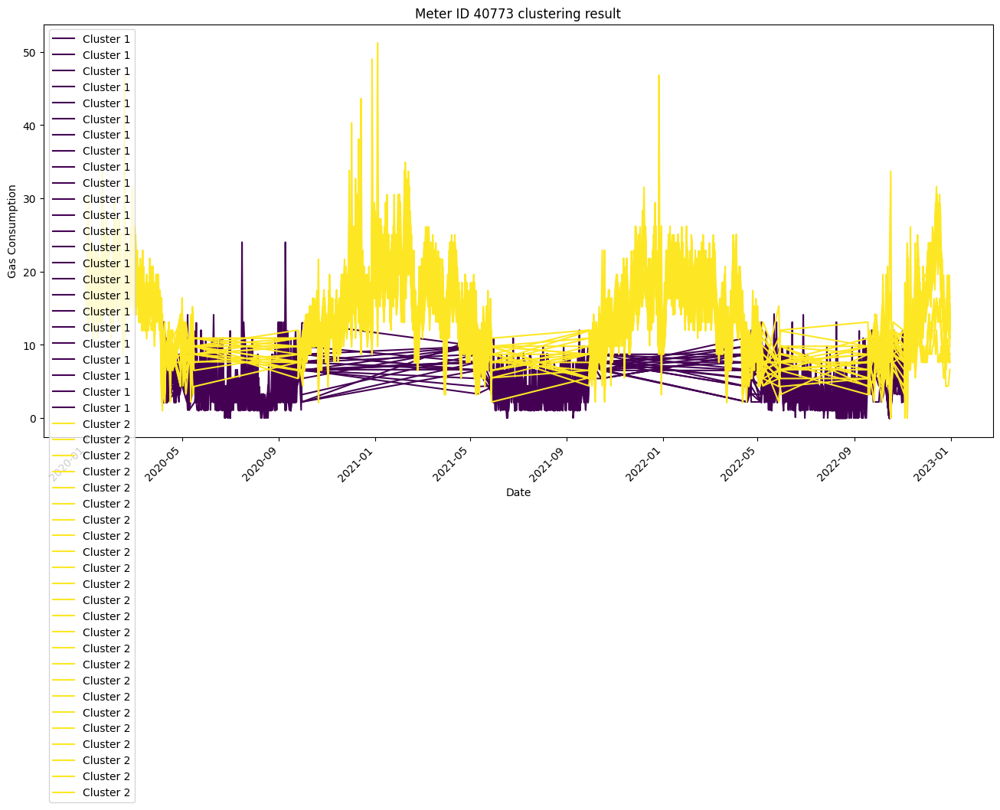

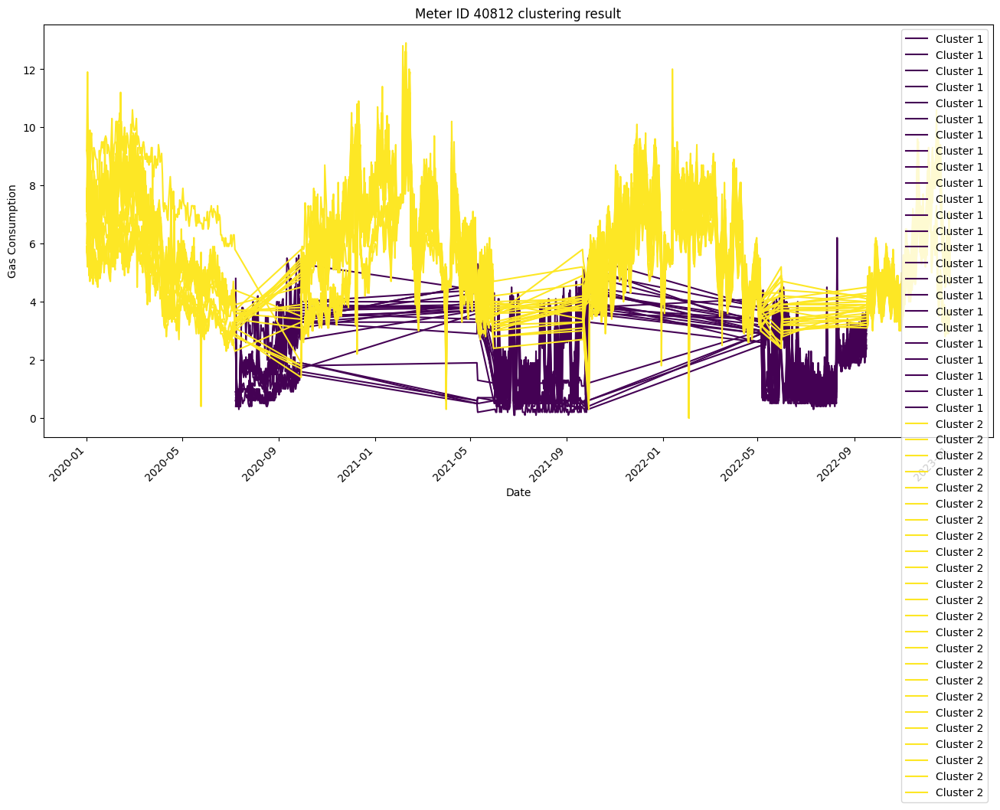

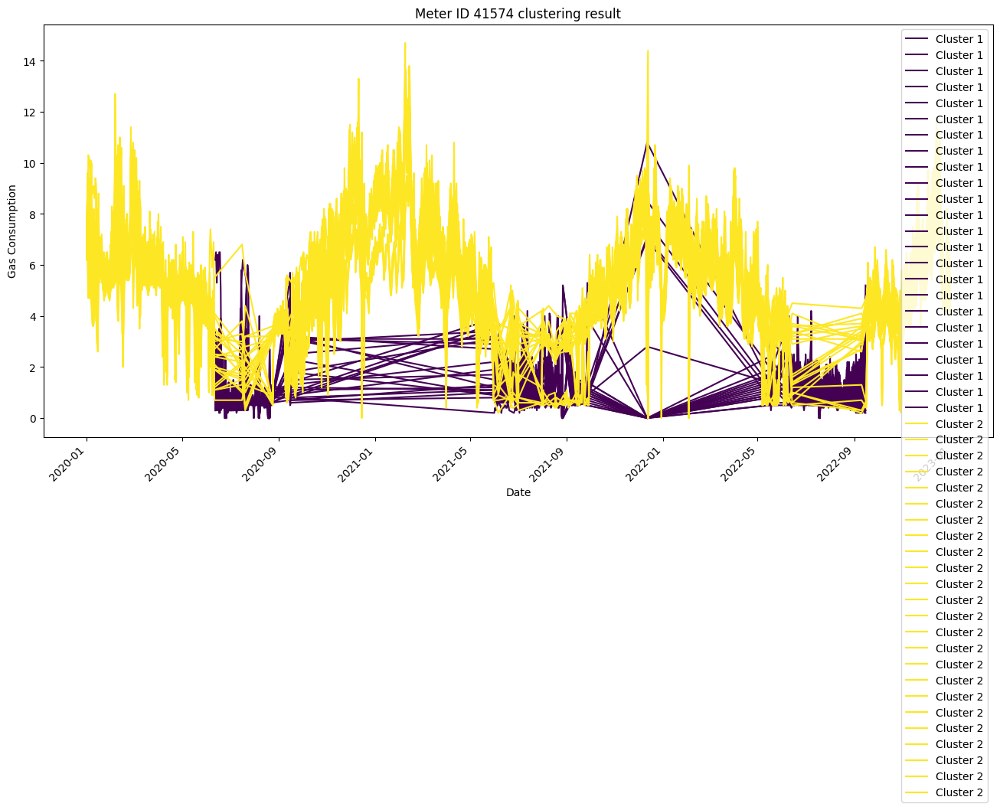

In [92]:
plot_clustered_gas_consumption(gas_data, ids_and_descriptions, cluster_dict)


In [93]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def analyze_and_plot_daily_meter_data_hierarchical(gas_data, meter_id, cluster_dict):
    # Get cluster labels from the cluster_dict
    cluster_labels = cluster_dict[meter_id]['labels']
    
    # Filter data by meter_id
    gas_data_filtered = gas_data[gas_data['meter_id'] == meter_id]
    gas_data_pivot = gas_data_filtered.pivot(index='datetime', columns='meter_id', values='value')
    
    # Preprocess data
    data = gas_data_pivot.copy()
    data.index = pd.to_datetime(data.index, utc=True)
    data_daily_grouped = data.groupby([data.index.date, data.index.hour]).mean()
    data_daily_grouped.index.names = ['date', 'hour']
    data_daily_unstacked = data_daily_grouped.unstack(level=-1)
    data_daily_unstacked.columns = [f'hour_{i}' for i in range(24)]
    
    # Group data by cluster
    cluster_groups = {}
    unique_clusters = np.unique(cluster_labels)
    for cluster in unique_clusters:
        cluster_data = data_daily_unstacked[cluster_labels == cluster]
        cluster_groups[cluster] = cluster_data
        
    # Find the global maximum and minimum gas consumption values across all clusters
    global_max = max(cluster_group.max().max() for cluster_group in cluster_groups.values())
    global_min = min(cluster_group.min().min() for cluster_group in cluster_groups.values())

    # Plot results for each cluster
    x_axis_values = np.arange(24)  # Create an array with values from 0 to 23 representing hours

    for i, cluster_group in cluster_groups.items():
        fig, ax = plt.subplots(figsize=(15, 5))
        for _, row in cluster_group.iterrows():
            ax.plot(x_axis_values, row.values, color='0.7', alpha=0.5)
            
        cluster_average = cluster_group.mean()
        ax.plot(x_axis_values, cluster_average, color='red', linewidth=2, label='Average')

        ax.set_xlabel("Hour")
        ax.set_ylabel("Gas Consumption")
        ax.set_title(f"Meter ID {meter_id}: Hourly Gas Consumption Patterns (Hierarchical Cluster {i})")
        
        # Set the y-axis limits to the global maximum and minimum values
        ax.set_ylim(global_min, global_max)
        plt.show()


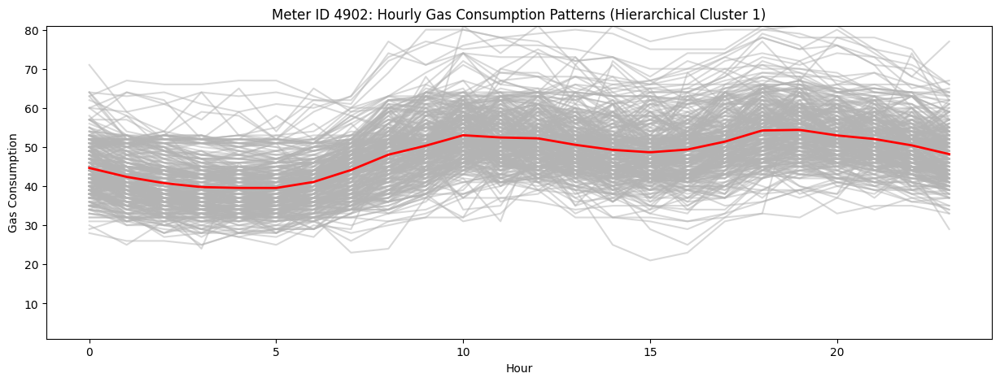

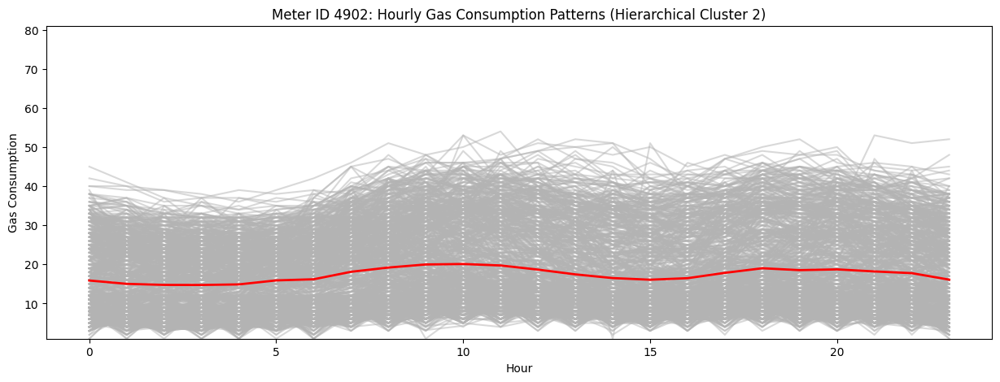

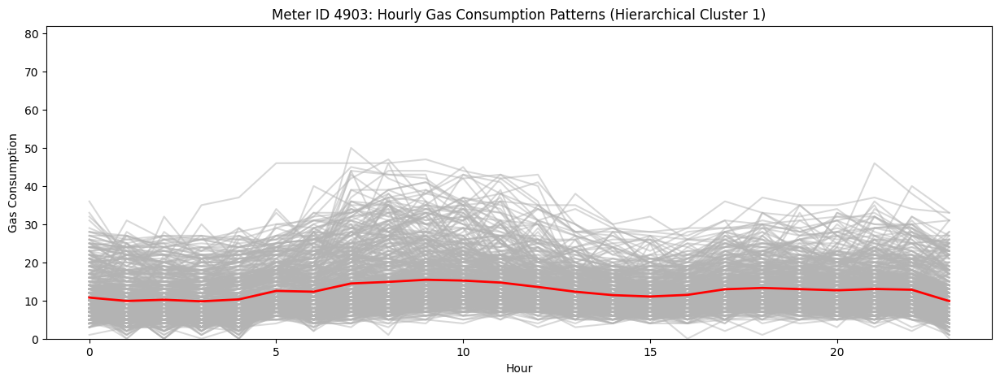

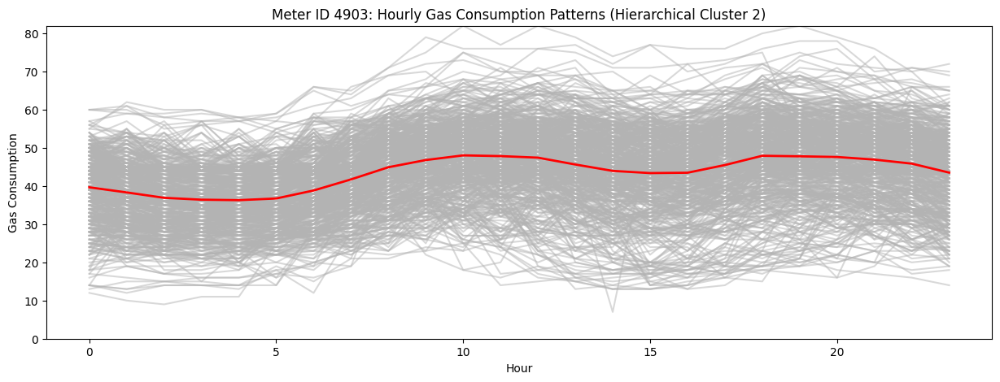

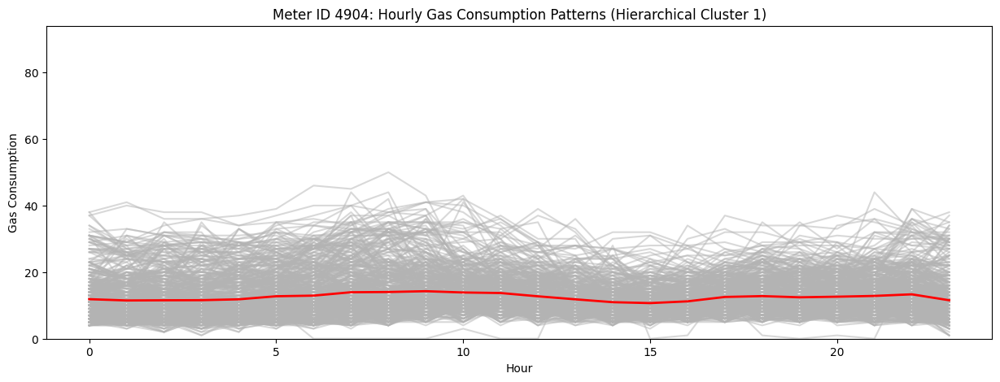

...

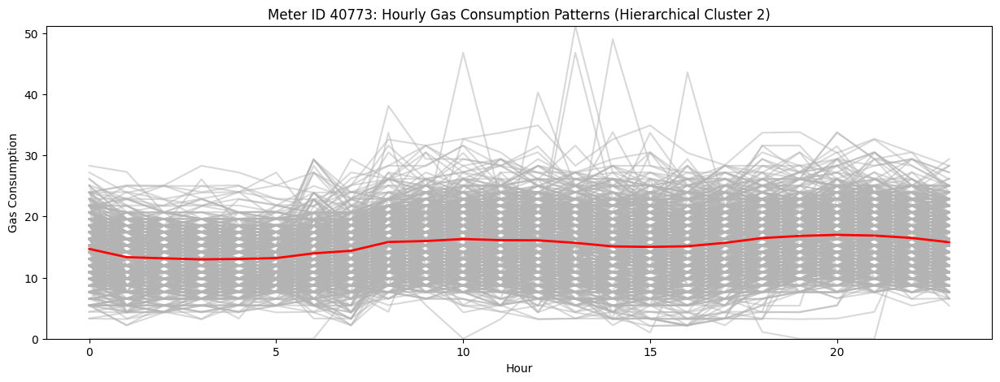

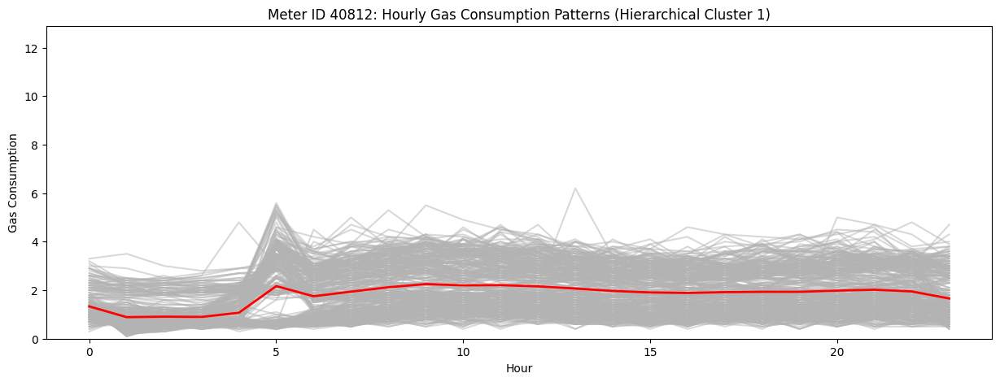

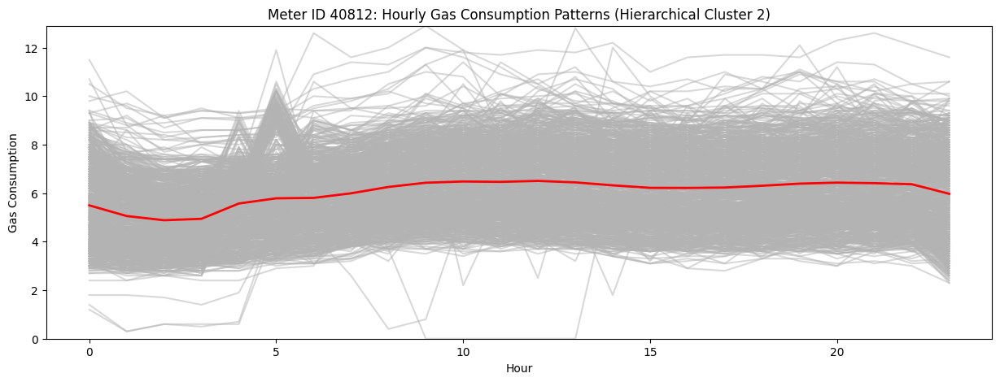

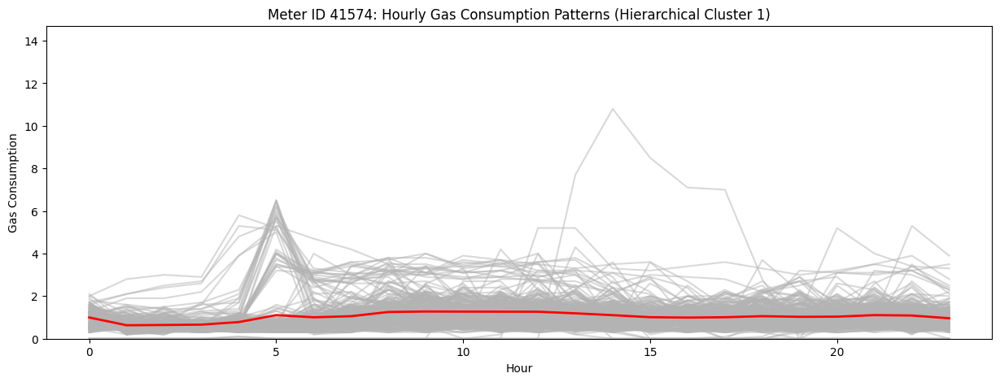

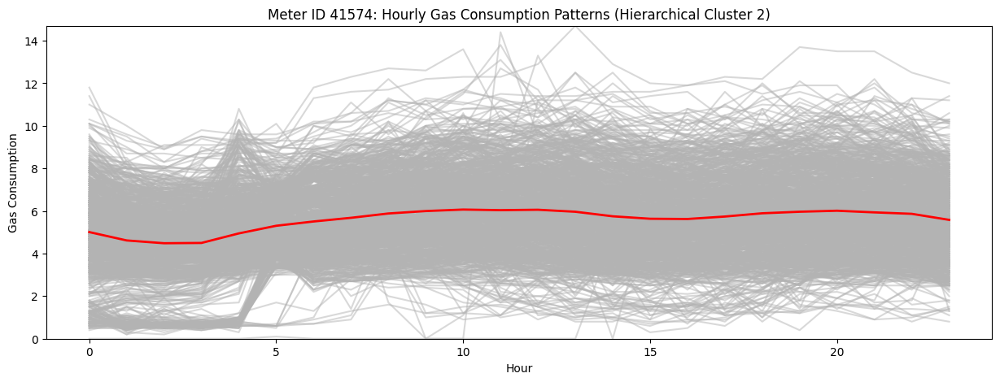

In [95]:
# loop over meter IDs and plot dendrograms
for meter_id in ids_and_descriptions:
    analyze_and_plot_daily_meter_data_hierarchical(gas_data, meter_id, cluster_dict)


In [196]:
!jupyter nbconvert --to html Clustering_on_24hr_data_ultra.ipynb

[NbConvertApp] Converting notebook Clustering_on_24hr_data_ultra.ipynb to html
[NbConvertApp] Writing 16262958 bytes to Clustering_on_24hr_data_ultra.html
